In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import pandas as pd
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt

# Define the path to your Excel file
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'  # Directory containing images

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LAceL-x", "LAceL-y", "LHeadMed-x", "LHeadMed-y", "LHeadLat-x", "LHeadLat-y", "LHeadProx-x", "LHeadProx-y", "LHeadDist-x", "LHeadDist-y", "LNeck3-x", "LNeck3-y", "LNeck8-x", "LNeck8-y", "LEnterLat-x", "LEnterLat-y", "LEnterMed-x", "LEnterMed-y", "LShaftLat-x", "LShaftLat-y", "LShaftMed-x", "LShaftMed-y", "LLesser-x", "LLesser-y", "RLesser-x", "RLesser-y", "LGreater-x", "LGreater-y", "LIschium-x", "LIschium-y", "RIschium-x", "RIschium-y"]
df_selected = df[columns_of_interest]

# Filter images that are not 3000x3000 pixels and within the range 23 to 86
non_3000_images = df_selected.iloc[22:86]  # iloc[23:87] includes indices from 23 to 86 (87 is exclusive)

# Iterate over the images and plot landmarks
for index, row in non_3000_images.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)
    img = img.resize((3000,3000))

    img_array = np.array(img)


    # Extract landmarks
    landmarks = [(row[f"{landmark}-x"], row[f"{landmark}-y"]) for landmark in ["LAceL", "LHeadMed", "LHeadLat", "LHeadProx", "LHeadDist", "LNeck3", "LNeck8", "LEnterLat", "LEnterMed", "LShaftLat", "LShaftMed", "LLesser", "RLesser", "LGreater", "LIschium", "RIschium"]]

    # Plot the image and landmarks
    plt.figure(figsize=(10, 10))
    plt.imshow(img_array)
    for (x, y) in landmarks:
        plt.scatter(x, y, c='red', s=20)
    plt.title(f"Image: {img_name}")
    plt.show()


In [ ]:
import tensorflow as tf
from tensorflow.keras import backend as K

def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

#First landmark(LAceL) Part1


In [ ]:
import pandas as pd
import os
from PIL import Image
import numpy as np
# Define the path to your Excel file
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LAceL-x", "LAceL-y", "LHeadMed-x", "LHeadMed-y", "LHeadLat-x", "LHeadLat-y","LHeadProx-x",	"LHeadProx-y",	"LHeadDist-x",	"LHeadDist-y","LNeck3-x",	"LNeck3-y","LNeck8-x",	"LNeck8-y","LEnterLat-x",	"LEnterLat-y","LEnterMed-x"	,"LEnterMed-y"	,"LShaftLat-x"	,"LShaftLat-y"	,"LShaftMed-x",	"LShaftMed-y",	"LLesser-x",	"LLesser-y"	,"RLesser-x",	"RLesser-y",	"LGreater-x",	"LGreater-y",	"LIschium-x"	,"LIschium-y"	,"RIschium-x"	,"RIschium-y"]
df_selected = df[columns_of_interest]

# Display the first few rows of the DataFrame to verify it's loaded correctly
print(df_selected.head())


   Height  Width                                           Name  LAceL-x  \
0    2804   3075       MSC 000819088 [Dr Shirvani] {2021-11-10}    741.5   
1    2804   3075  MSC 000819088 [Dr Shirvani] {2021-11-10}hflip    604.0   
2    2658   3100       MSC 990712056 [Dr Shirvani] {2020-10-03}    767.5   
3    2658   3100  MSC 990712056 [Dr Shirvani] {2020-10-03}hflip    827.5   
4    2752   3095       MSC 990712083 [Dr Shirvani] {2020-10-03}    681.5   

   LAceL-y  LHeadMed-x  LHeadMed-y  LHeadLat-x  LHeadLat-y  LHeadProx-x  ...  \
0   1565.5      1041.5      1806.5       750.0      1632.0      853.167  ...   
1   1605.0       919.0      1824.0       615.5      1643.5      726.500  ...   
2   1367.5      1019.0      1652.0       729.5      1487.5      861.167  ...   
3   1320.5      1083.0      1604.0       795.5      1411.5      929.167  ...   
4   1421.5      1037.0      1590.0       717.5      1475.5      851.833  ...   

   LLesser-x  LLesser-y  RLesser-x  RLesser-y  LGreater-x  LGr

(3000, 3000)

In [ ]:
# Define image directory
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Initialize lists to hold processed images and landmarks
images = []
landmarks = []
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get original dimensions
    orig_width, orig_height = 3000,3000

    # Resize the image to 224x224
    img_resized = img.resize((224, 224))

    # Convert image to numpy array
    img_array = np.array(img_resized)

    # Initialize a list to hold the transformed landmarks for the current image
    transformed_landmarks = []

    # Loop through each pair of landmark columns and transform their coordinates
    for i in range(3, len(columns_of_interest), 2):
        landmark_x = row[columns_of_interest[i]] * 224 / orig_width
        landmark_y = row[columns_of_interest[i + 1]] * 224 / orig_height
        if type(landmark_x)!=float or type(landmark_y)!=float:
          print(i,type(landmark_x),landmark_y)
          break
        transformed_landmarks.extend([landmark_x, landmark_y])

    # Append the transformed landmarks and image array to their respective lists
    images.append(img_array)
    landmarks.append(transformed_landmarks)

# Convert lists to numpy arrays
images = np.array(images)
landmarks = np.array(landmarks)

print(f"Processed {len(images)} images and landmarks.")

Processed 853 images and landmarks.


In [ ]:
type(landmark_x)!=float

False

In [ ]:
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = images[train_val_indices]
train_val_landmarks = landmarks[train_val_indices]
test_images = images[test_indices]
test_landmarks = landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")


Training set: 580 images
Validation set: 146 images
Test set: 127 images


In [ ]:

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images224.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images224.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images224.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy', test_landmarks)

print("Datasets saved successfully.")

Datasets saved successfully.


In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the first landmark coordinates (LAceL-x and LAceL-y)
train_landmarks_first = train_landmarks[:, :2]
val_landmarks_first = val_landmarks[:, :2]
test_landmarks_first = test_landmarks[:, :2]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 5721.7769 - mae: 72.6824

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 66s 1s/step - loss: 5721.7769 - mae: 72.6824 - val_loss: 4646.2227 - val_mae: 66.6467
Epoch 2/400
19/19 [==============================] - 8s 420ms/step - loss: 4161.9932 - mae: 62.4476 - val_loss: 4503.3198 - val_mae: 54.4100
Epoch 3/400
19/19 [==============================] - 8s 438ms/step - loss: 2765.4587 - mae: 48.5074 - val_loss: 3384.0364 - val_mae: 56.6093
Epoch 4/400
19/19 [==============================] - 6s 309ms/step - loss: 1226.3838 - mae: 30.6544 - val_loss: 7896.2783 - val_mae: 74.0674
Epoch 5/400
19/19 [==============================] - 8s 427ms/step - loss: 400.5819 - mae: 15.9509 - val_loss: 2923.5747 - val_mae: 51.6562
Epoch 6/400
19/19 [==============================] - 8s 417ms/step - loss: 298.8078 - mae: 13.3731 - val_loss: 495.6176 - val_mae: 19.6848
Epoch 7/400
19/19 [==============================] - 8s 431ms/step - loss: 259.6941 - mae: 12.2220 - val_loss: 81.6339 - val_mae: 6.7999
Epoch 8/400
19/19 [===============

4/4 [==============================] - 2s 743ms/step - loss: 6.2054 - mae: 1.9255
Test Loss: 6.205426216125488
Test MAE: 1.9254893064498901
4/4 [==============================] - 1s 86ms/step
1.3228910624186199 3.0048930053710876


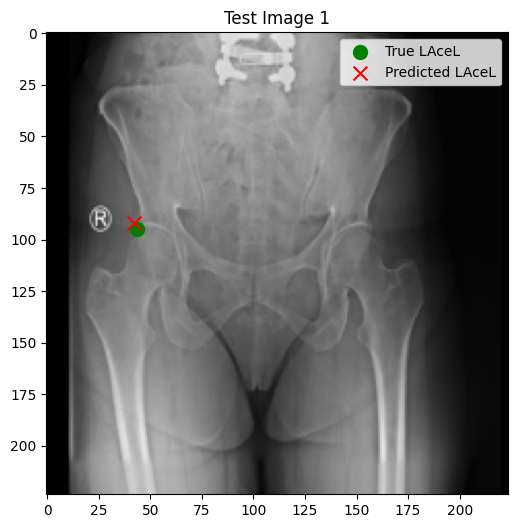

2.9002249043782555 -1.6400956827799433


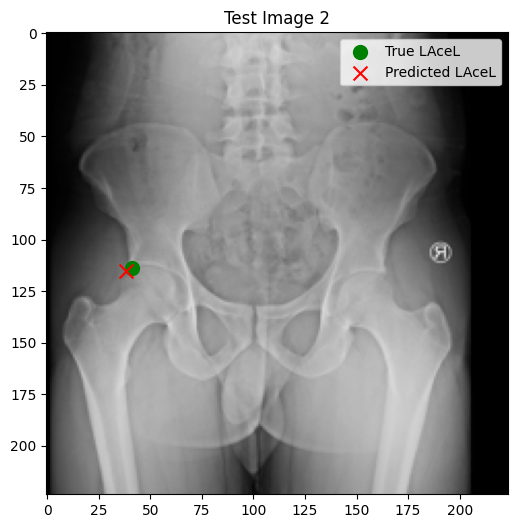

0.6873655497233102 -1.521182779947921


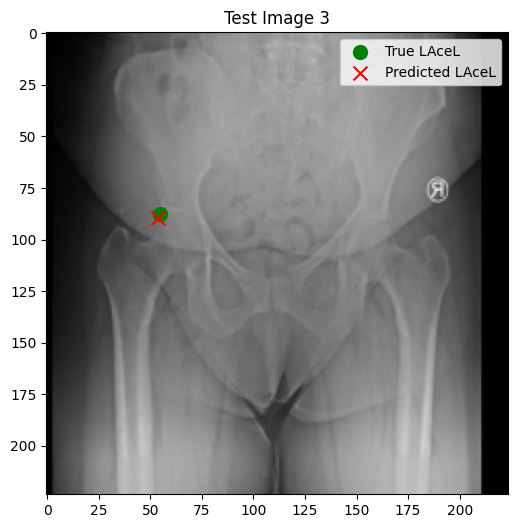

-1.266162811279294 0.17123708089192746


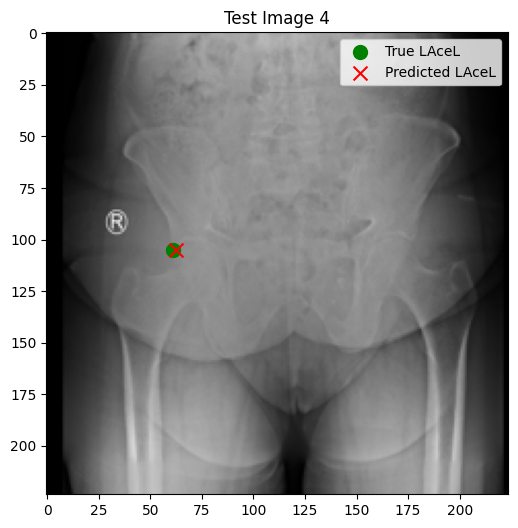

3.249672037760419 2.0146177368164047


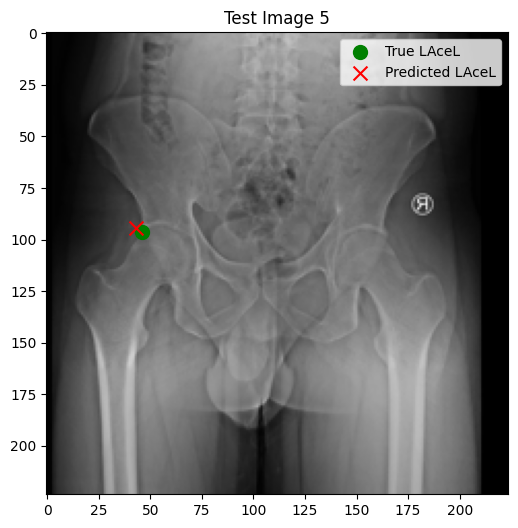

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True LAceL', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted LAceL', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd

# Load the trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first700.h5')

# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks[:, :2])

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Extract only the first landmark coordinates (LAceL-x and LAceL-y) for the test set
test_landmarks_first = test_landmarks[:, :2]

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LAceL1.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 2s 96ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LAceL1.csv


In [ ]:
import tensorflow as tf
import numpy as np

# Load the trained model
model = tf.keras.models.load_model('/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first700.h5')

# Extract only the first landmark coordinates (LAceL-x and LAceL-y) for the test set
test_landmarks_first = test_landmarks[:, :2]

print("Model and datasets loaded successfully.")


Model and datasets loaded successfully.


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 1s 102ms/step
Maximum error in x direction: 8.880375417073566
Maximum error in y direction: 9.132934631347652


#Part 2


##save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LAceL-x", "LAceL-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y -  crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LAceL-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LAceL-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 22ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped1.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped1.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped1.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped1.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped1.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped1.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped1.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped1.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped1.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped1.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped1.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped1.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_13"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_14 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_14[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first_part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
37/37 [==============================] - 20s 295ms/step - loss: 138.2731 - mae: 97.3463 - euclidean_distance: 138.2731 - val_loss: 338.1774 - val_mae: 234.4358 - val_euclidean_distance: 338.1774
Epoch 2/400
37/37 [==============================] - 4s 122ms/step - loss: 45.3767 - mae: 30.5571 - euclidean_distance: 45.3767 - val_loss: 103.1679 - val_mae: 71.6901 - val_euclidean_distance: 103.1679
Epoch 3/400
37/37 [==============================] - 6s 164ms/step - loss: 23.1710 - mae: 14.8290 - euclidean_distance: 23.1710 - val_loss: 27.0437 - val_mae: 17.0310 - val_euclidean_distance: 27.0437
Epoch 4/400
37/37 [==============================] - 3s 86ms/step - loss: 21.5132 - mae: 13.8436 - euclidean_distance: 21.5132 - val_loss: 33.6584 - val_mae: 21.4448 - val_euclidean_distance: 33.6584
Epoch 5/400
37/37 [==============================] - 3s 85ms/step - loss: 21.3449 - mae: 13.7657 - euclidean_distance: 21.3449 - val_loss: 40.0239 - val_mae: 25.9055 - val_euclidean_distanc

In [ ]:
#checkpoint_path = '/content/drive/MyDrive/HIP/resnet50_landmarks_600.h5'
#checkpoint_path = '/content/drive/MyDrive/HIP/resnet50_landmarks_601.h5'
#checkpoint_path = '/content/drive/MyDrive/HIP/resnet50_landmarks_602.h5'
#checkpoint_path = '/content/drive/MyDrive/HIP/resnet50_landmarks_602.h5'
#checkpoint_path = '/content/drive/MyDrive/HIP/resnet50_landmarks_611.h5'
#checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_first_part2.h5'

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 96ms/step - loss: 8.4939 - mae: 5.3440 - euclidean_distance: 8.4939
Test Loss: 8.49386215209961, Test MAE: 5.3439788818359375, Test Euclidean Distance: 1.6987724304199219 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LAceL-x', 'LAceL-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_and_mae1.csv', index=False)


4/4 [==============================] - 1s 104ms/step


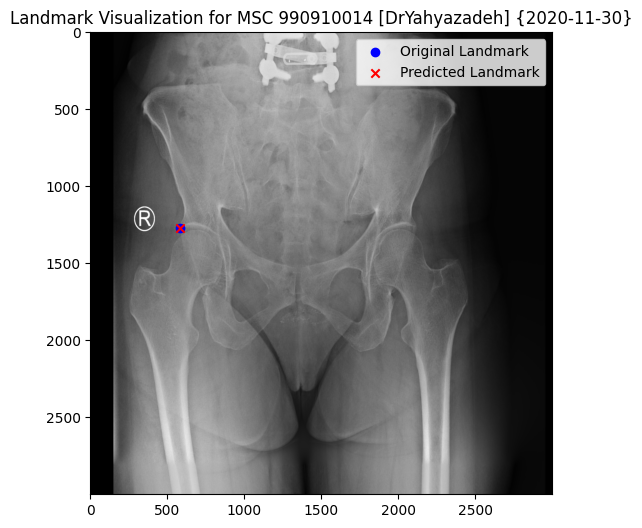

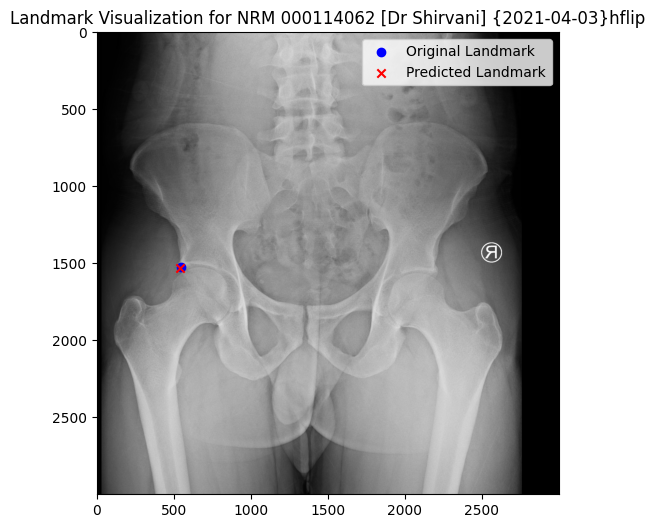

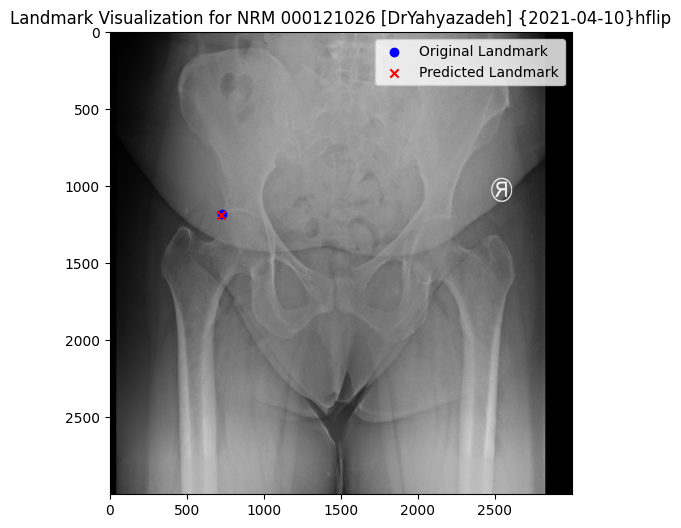

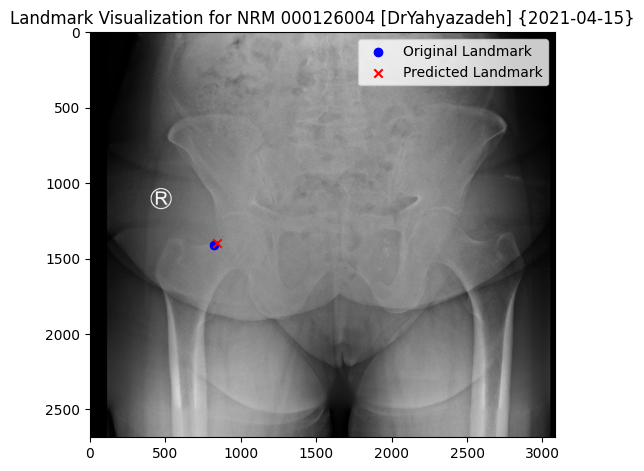

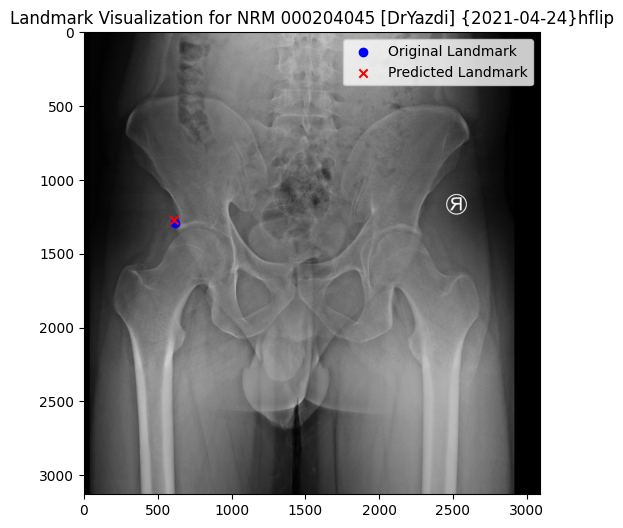

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_and_mae1.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


In [ ]:
test_landmarks.shape

(127, 2)

#Landmark2(LHeadMed)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 2:4]
val_landmarks_first = val_landmarks[:, 2:4]
test_landmarks_first = test_landmarks[:, 2:4]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)

x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)


# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_second700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 8877.4248 - mae: 91.0784

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 53s 1s/step - loss: 8877.4248 - mae: 91.0784 - val_loss: 5033.7349 - val_mae: 66.7111
Epoch 2/400
19/19 [==============================] - 6s 327ms/step - loss: 5922.8809 - mae: 72.9067 - val_loss: 7232.9873 - val_mae: 81.9496
Epoch 3/400
19/19 [==============================] - 7s 347ms/step - loss: 1720.0411 - mae: 34.3926 - val_loss: 98749.8203 - val_mae: 311.9144
Epoch 4/400
19/19 [==============================] - 7s 347ms/step - loss: 491.9191 - mae: 17.9280 - val_loss: 36585.8984 - val_mae: 189.9395
Epoch 5/400
19/19 [==============================] - 6s 334ms/step - loss: 444.9202 - mae: 17.1279 - val_loss: 6395.8115 - val_mae: 77.6932
Epoch 6/400
19/19 [==============================] - 14s 772ms/step - loss: 400.5445 - mae: 16.4235 - val_loss: 886.6261 - val_mae: 26.0723
Epoch 7/400
19/19 [==============================] - 9s 466ms/step - loss: 381.2678 - mae: 16.0806 - val_loss: 391.4321 - val_mae: 16.2517
Epoch 8/400
19/19 [=========

4/4 [==============================] - 0s 99ms/step - loss: 9.2894 - mae: 1.9458
Test Loss: 9.289426803588867
Test MAE: 1.9457920789718628
4/4 [==============================] - 1s 86ms/step
0.7372584940592475 1.0809579874674426


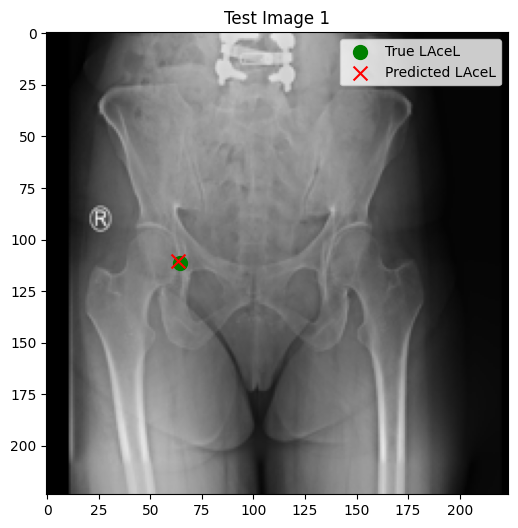

2.7098753560384097 0.3326492919921975


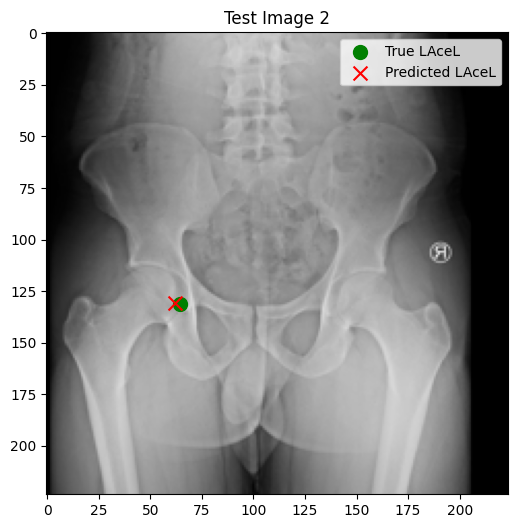

2.0169195760091156 0.17834914143880098


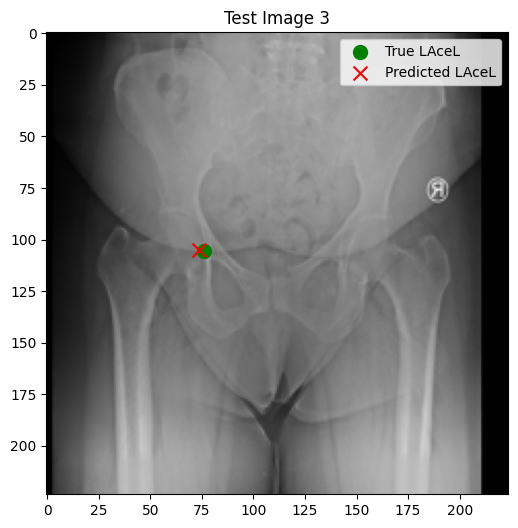

3.4399585367838483 -2.73460412597656


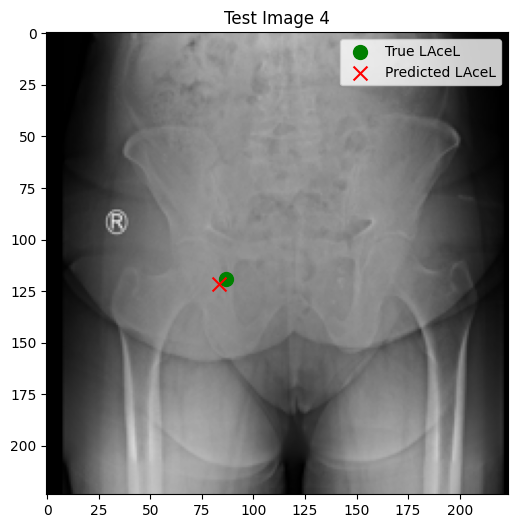

3.0071644897460885 -0.1552992553710908


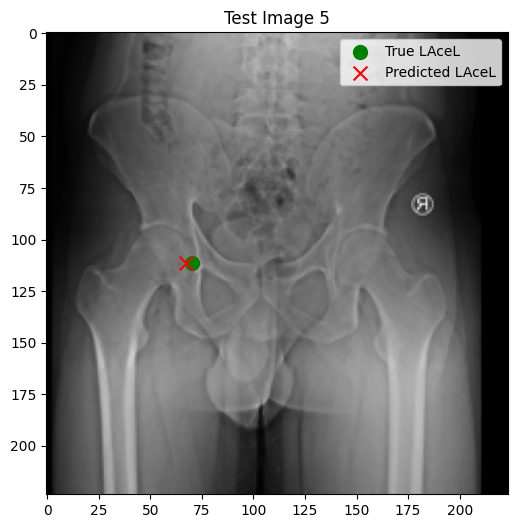

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True LAceL', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted LAceL', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)


# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LHeadMed.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 86ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LHeadMed.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 99ms/step
Maximum error in x direction: 15.34600815836589
Maximum error in y direction: 19.44808264160156


#Part 2_Landmark_2_LHeadMed

##save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_second700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LHeadMed-x", "LHeadMed-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []

crop_size=224*2

# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))

    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y -  crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LHeadMed-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LHeadMed-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details2.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 21ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped2.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped2.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped2.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped2.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped2.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped2.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##train


In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped2.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped2.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped2.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped2.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped2.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped2.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_8[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/second.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
37/37 [==============================] - 20s 280ms/step - loss: 137.6923 - mae: 96.8320 - euclidean_distance: 137.6923 - val_loss: 338.6606 - val_mae: 232.9165 - val_euclidean_distance: 338.6606
Epoch 2/400
37/37 [==============================] - 5s 130ms/step - loss: 40.1390 - mae: 26.1153 - euclidean_distance: 40.1390 - val_loss: 33.2957 - val_mae: 22.0339 - val_euclidean_distance: 33.2957
Epoch 3/400
37/37 [==============================] - 3s 92ms/step - loss: 19.2533 - mae: 12.6056 - euclidean_distance: 19.2533 - val_loss: 46.3748 - val_mae: 31.3011 - val_euclidean_distance: 46.3748
Epoch 4/400
37/37 [==============================] - 3s 95ms/step - loss: 18.3321 - mae: 11.9003 - euclidean_distance: 18.3321 - val_loss: 40.5673 - val_mae: 27.0600 - val_euclidean_distance: 40.5673
Epoch 5/400
37/37 [==============================] - 4s 96ms/step - loss: 17.1045 - mae: 11.1153 - euclidean_distance: 17.1045 - val_loss: 45.3504 - val_mae: 30.5332 - val_euclidean_distance: 

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
crop_size=224*2
# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 97ms/step - loss: 10.8174 - mae: 6.7426 - euclidean_distance: 10.8174
Test Loss: 10.817394256591797, Test MAE: 6.74260950088501, Test Euclidean Distance: 2.163478851318359 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LHeadMed-x', 'LHeadMed-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details2.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x *  crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size/ 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadMed2.csv', index=False)


4/4 [==============================] - 1s 99ms/step


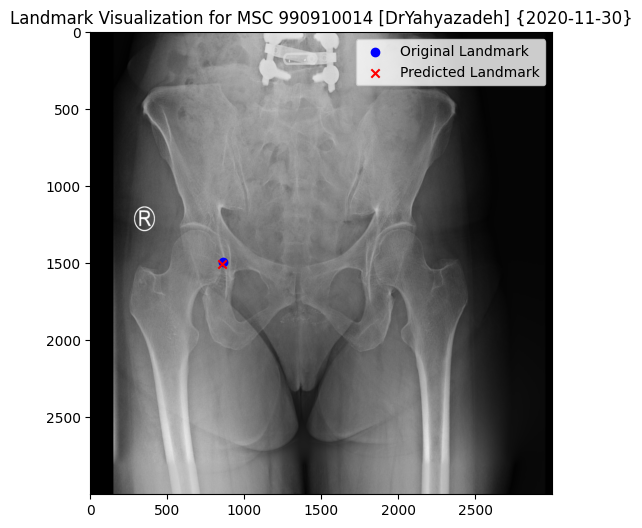

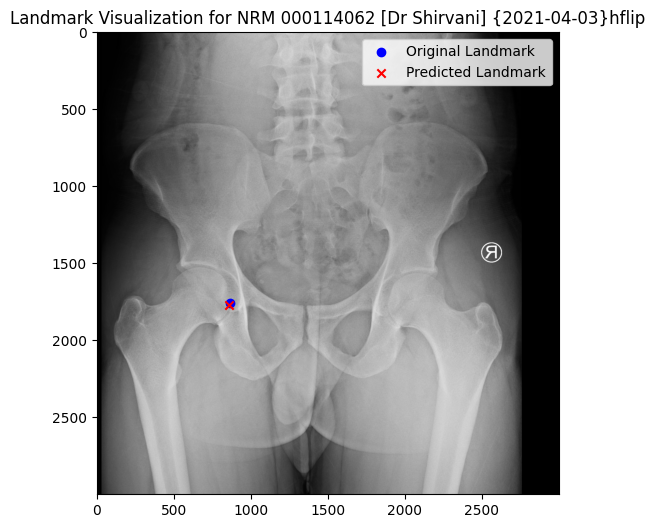

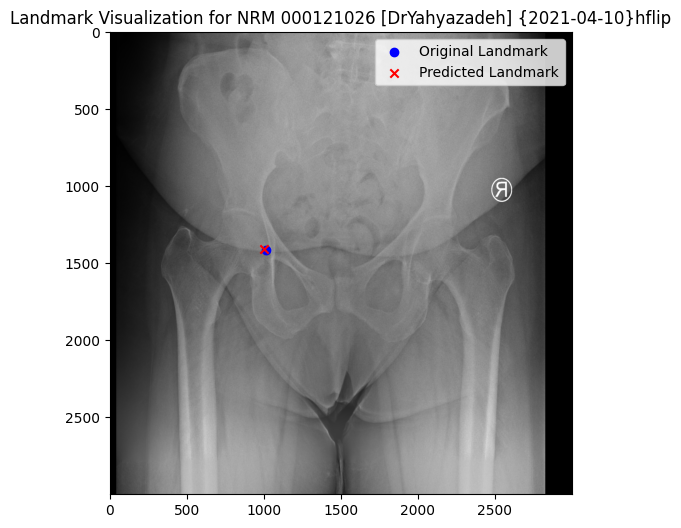

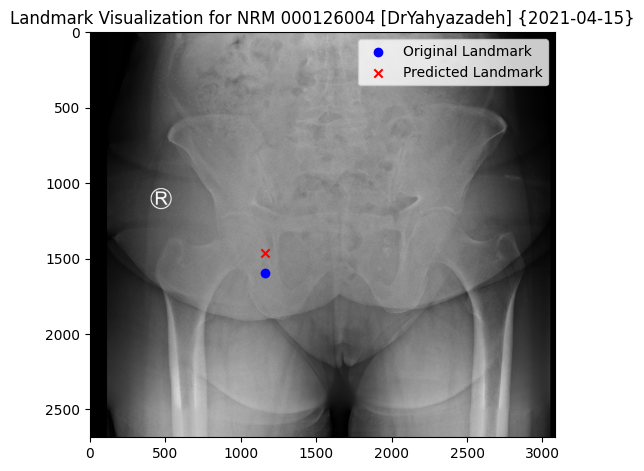

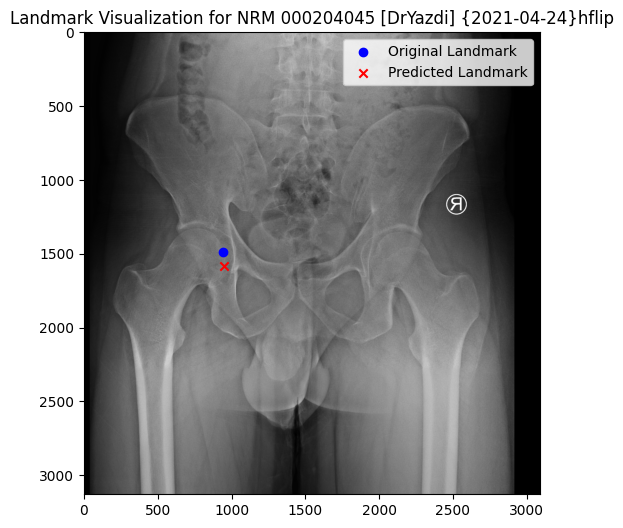

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadMed.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark3(LHeadLat)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 4:6]
val_landmarks_first = val_landmarks[:, 4:6]
test_landmarks_first = test_landmarks[:, 4:6]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_third700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 6639.2578 - mae: 75.6411

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 54s 962ms/step - loss: 6639.2578 - mae: 75.6411 - val_loss: 5739.2979 - val_mae: 69.3481
Epoch 2/400
19/19 [==============================] - 8s 448ms/step - loss: 5144.5488 - mae: 64.5955 - val_loss: 1036.6007 - val_mae: 29.4021
Epoch 3/400
19/19 [==============================] - 6s 330ms/step - loss: 2380.9751 - mae: 39.6694 - val_loss: 8622.6631 - val_mae: 88.5770
Epoch 4/400
19/19 [==============================] - 6s 320ms/step - loss: 591.2059 - mae: 19.6993 - val_loss: 7633.9434 - val_mae: 81.6889
Epoch 5/400
19/19 [==============================] - 6s 318ms/step - loss: 218.6917 - mae: 11.6641 - val_loss: 1856.6443 - val_mae: 37.8922
Epoch 6/400
19/19 [==============================] - 14s 754ms/step - loss: 198.7633 - mae: 11.0399 - val_loss: 146.1112 - val_mae: 9.6630
Epoch 7/400
19/19 [==============================] - 8s 425ms/step - loss: 183.7373 - mae: 10.5363 - val_loss: 94.2921 - val_mae: 7.2184
Epoch 8/400
19/19 [=============

4/4 [==============================] - 0s 93ms/step - loss: 7.0540 - mae: 2.0738
Test Loss: 7.053982257843018
Test MAE: 2.0737645626068115
4/4 [==============================] - 1s 87ms/step
-0.21529947916666714 -1.4271746622721366


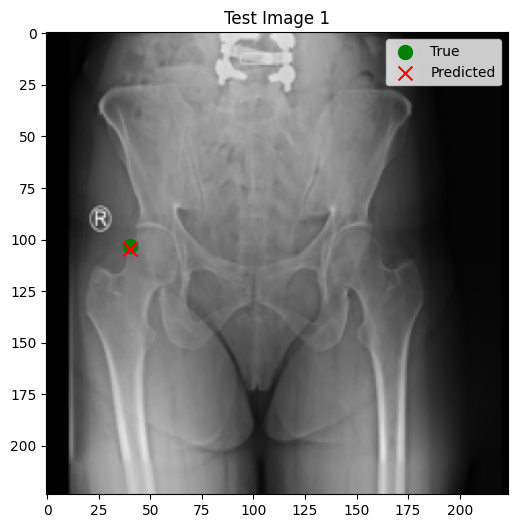

-2.2892610575358106 1.6176326497395763


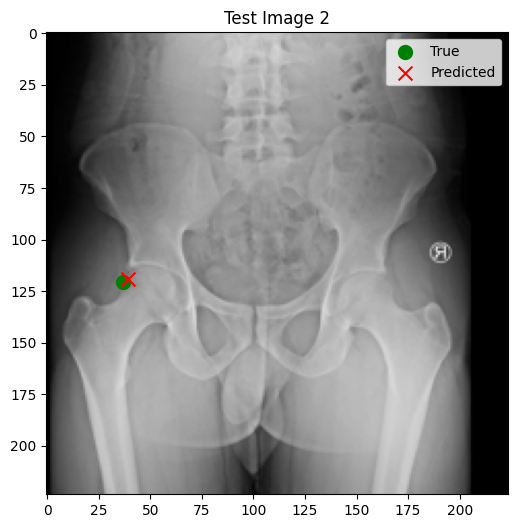

2.5583772379557317 -4.296798278808595


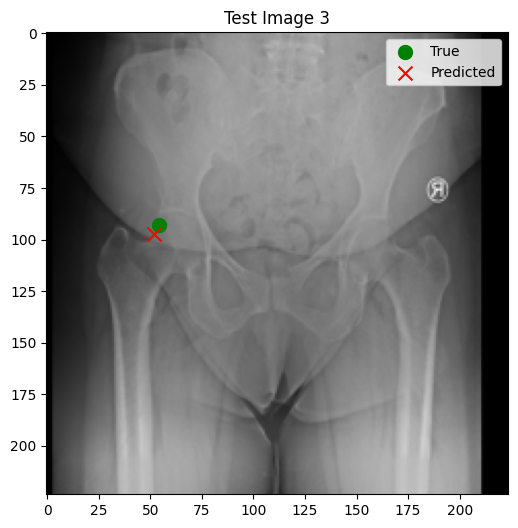

0.9442231547037778 2.722828653971348


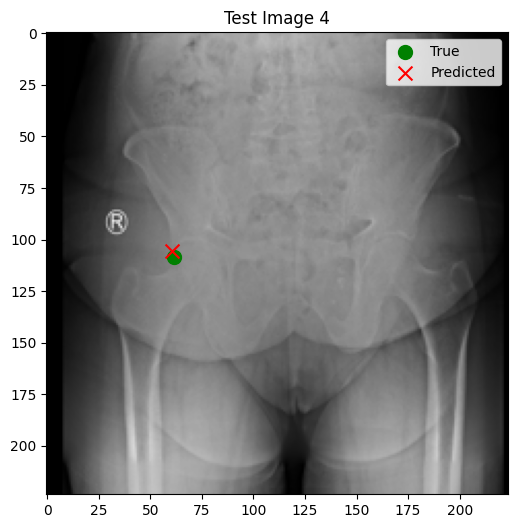

0.044403076171875 -1.3509334106445294


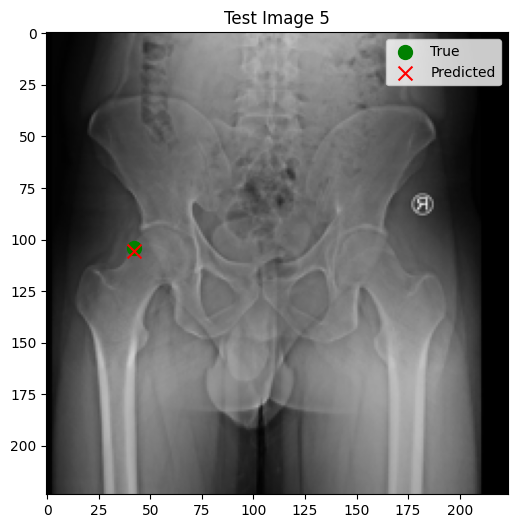

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LHeadLat3.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 84ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LHeadLat3.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 86ms/step
Maximum error in x direction: 5.6886082865397185
Maximum error in y direction: 11.21245292154947


#Part 2_Landmark_3_LHeadLat


##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_third700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LHeadLat-x", "LHeadLat-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []

crop_size=224*2

# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LHeadLat-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LHeadLat-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details3.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 28ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped3.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped3.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped3.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped3.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped3.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped3.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped3.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped3.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped3.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped3.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped3.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped3.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.05)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_12"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_13 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_13[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_third_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 146.8832 - mae: 103.4278 - euclidean_distance: 146.8832

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 15s 162ms/step - loss: 146.6939 - mae: 103.2968 - euclidean_distance: 146.6939 - val_loss: 170.1485 - val_mae: 108.8722 - val_euclidean_distance: 170.1485
Epoch 2/400
37/37 [==============================] - 5s 126ms/step - loss: 74.7857 - mae: 51.1049 - euclidean_distance: 74.7857 - val_loss: 114.0060 - val_mae: 78.8260 - val_euclidean_distance: 114.0060
Epoch 3/400
37/37 [==============================] - 5s 136ms/step - loss: 21.2175 - mae: 13.5715 - euclidean_distance: 21.2175 - val_loss: 30.1090 - val_mae: 19.0188 - val_euclidean_distance: 30.1090
Epoch 4/400
37/37 [==============================] - 3s 91ms/step - loss: 17.4949 - mae: 11.1443 - euclidean_distance: 17.4949 - val_loss: 36.1612 - val_mae: 22.8301 - val_euclidean_distance: 36.1612
Epoch 5/400
37/37 [==============================] - 3s 92ms/step - loss: 16.6506 - mae: 10.6217 - euclidean_distance: 16.6506 - val_loss: 42.8464 - val_mae: 27.5454 - val_euclidean_distance: 42.8464


##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 101ms/step - loss: 11.9526 - mae: 7.8387 - euclidean_distance: 11.9526
Test Loss: 11.952606201171875, Test MAE: 7.838651657104492, Test Euclidean Distance: 2.3905212402343747 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LHeadLat-x', 'LHeadLat-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details3.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLat3.csv', index=False)


4/4 [==============================] - 1s 86ms/step


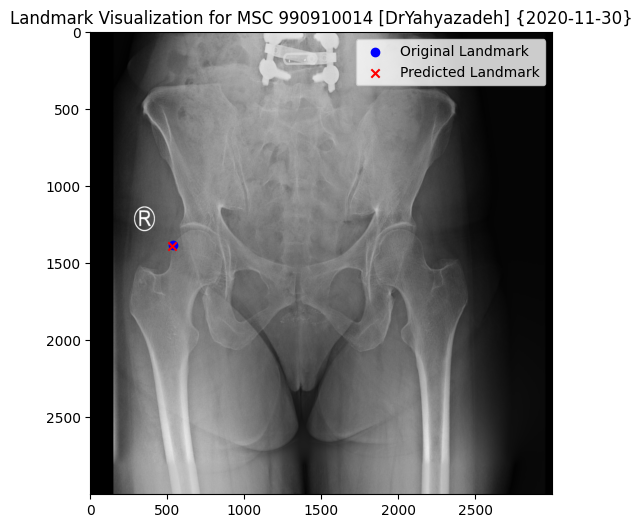

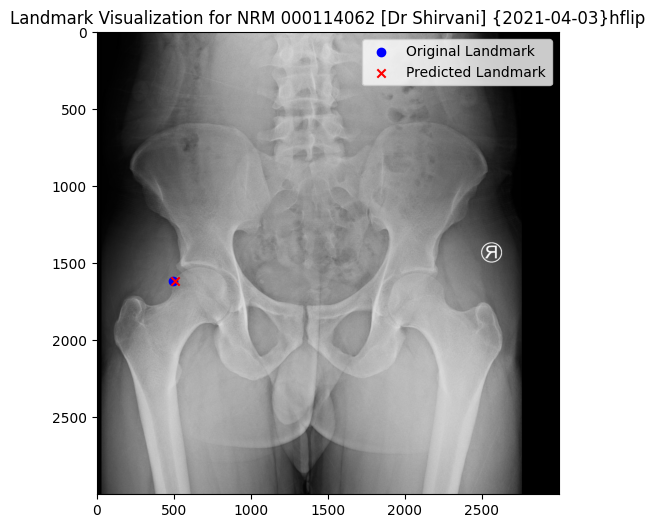

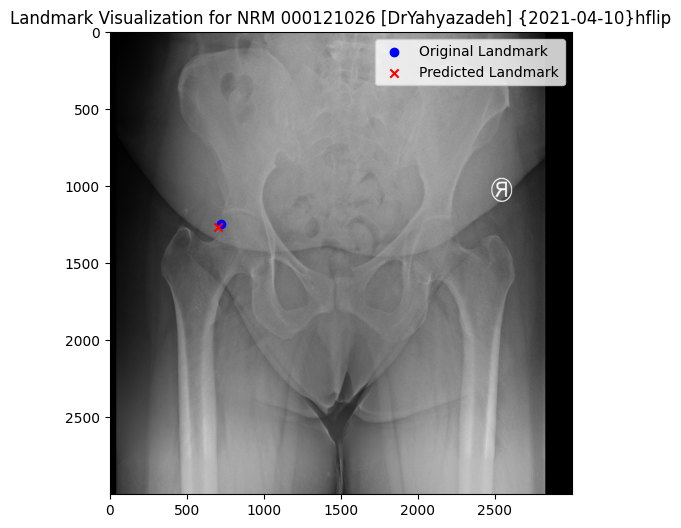

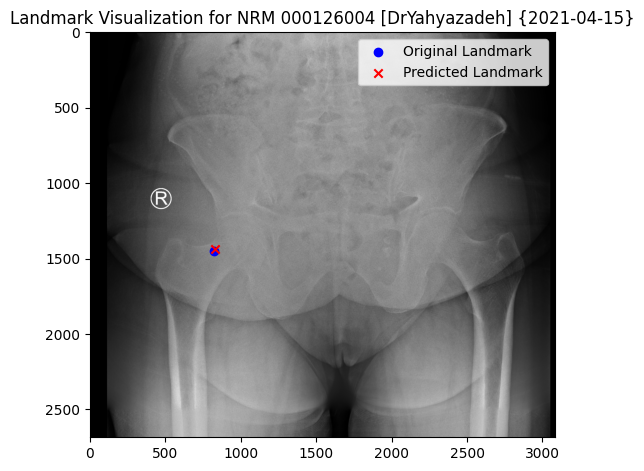

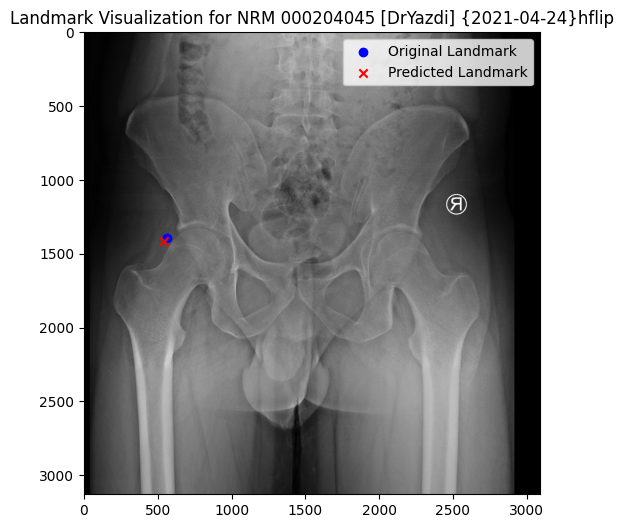

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLat3.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark4(LHeadProx)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 6:8]
val_landmarks_first = val_landmarks[:, 6:8]
test_landmarks_first = test_landmarks[:, 6:8]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 0s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_fourth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 5769.4639 - mae: 73.8119

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 62s 1s/step - loss: 5769.4639 - mae: 73.8119 - val_loss: 3376.9443 - val_mae: 55.8353
Epoch 2/400
19/19 [==============================] - 6s 324ms/step - loss: 2997.9973 - mae: 50.8470 - val_loss: 5906.8472 - val_mae: 72.5528
Epoch 3/400
19/19 [==============================] - 6s 330ms/step - loss: 1491.9579 - mae: 31.4813 - val_loss: 6691.2993 - val_mae: 62.9752
Epoch 4/400
19/19 [==============================] - 12s 642ms/step - loss: 657.9044 - mae: 21.1232 - val_loss: 903.8943 - val_mae: 24.5592
Epoch 5/400
19/19 [==============================] - 8s 428ms/step - loss: 310.3655 - mae: 14.3597 - val_loss: 134.6896 - val_mae: 9.0902
Epoch 6/400
19/19 [==============================] - 6s 337ms/step - loss: 249.0719 - mae: 12.3187 - val_loss: 273.3339 - val_mae: 13.5500
Epoch 7/400
19/19 [==============================] - 6s 335ms/step - loss: 237.5612 - mae: 11.7454 - val_loss: 362.7484 - val_mae: 16.4509
Epoch 8/400
19/19 [================

4/4 [==============================] - 2s 766ms/step - loss: 4.8760 - mae: 1.7836
Test Loss: 4.875966548919678
Test MAE: 1.783562421798706
4/4 [==============================] - 1s 87ms/step
2.6438609380696647 1.715541300455726


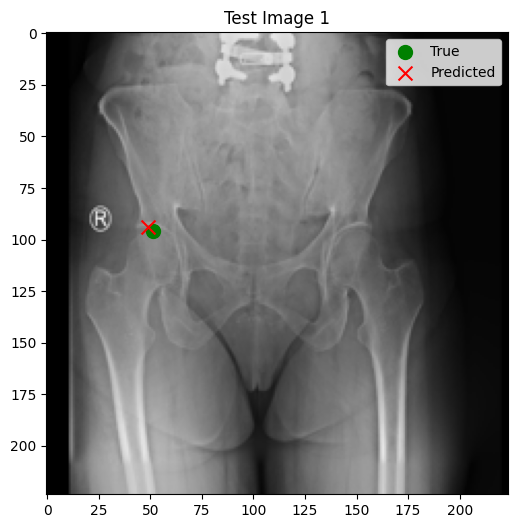

1.2276903244628912 1.152011922200515


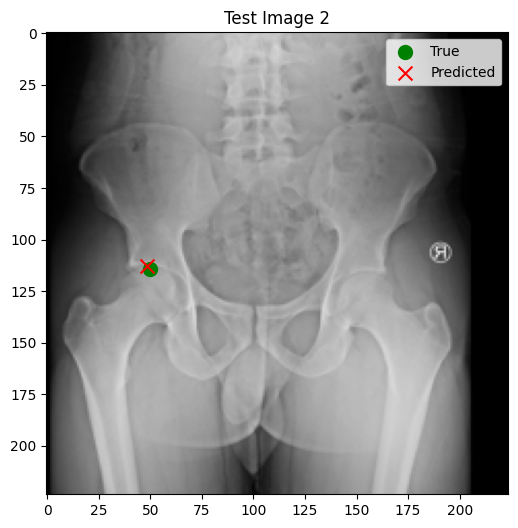

2.948163723307296 -1.9910558064778598


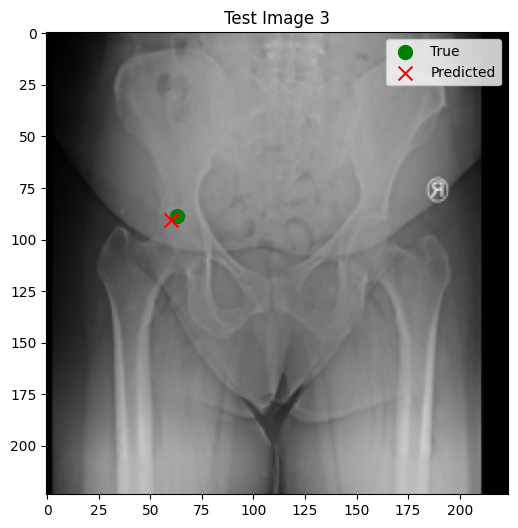

3.2619613714192752 -0.6842064819336002


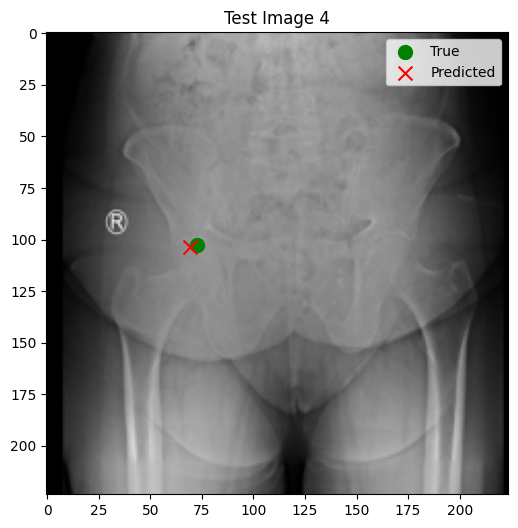

3.1975144923502583 -1.0278798761393233


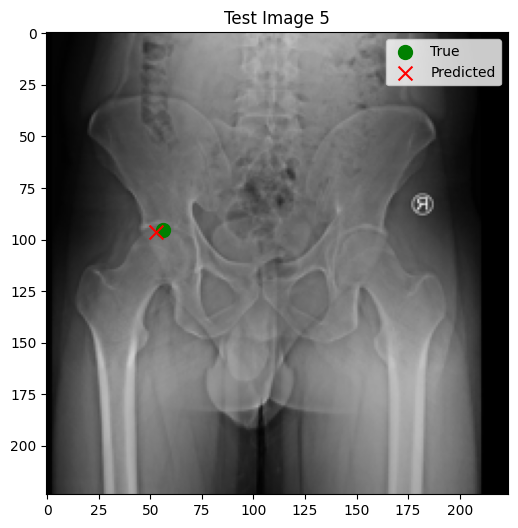

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LHeadProx4.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 86ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LHeadProx4.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 87ms/step
Maximum error in x direction: 6.558550740559895
Maximum error in y direction: 6.868354861897785


#Part 2_Landmark_4(LHeadProx)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_fourth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LHeadProx-x", "LHeadProx-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LHeadProx-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LHeadProx-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details4.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 21ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped4.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped4.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped4.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped4.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped4.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped4.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped4.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped4.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped4.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped4.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped4.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped4.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_fourth_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 142.0721 - mae: 99.9312 - euclidean_distance: 142.0721 

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 36s 634ms/step - loss: 141.7622 - mae: 99.7143 - euclidean_distance: 141.7622 - val_loss: 260.1332 - val_mae: 181.1903 - val_euclidean_distance: 260.1332
Epoch 2/400
37/37 [==============================] - 5s 135ms/step - loss: 40.8218 - mae: 26.8885 - euclidean_distance: 40.8218 - val_loss: 18.3082 - val_mae: 11.6735 - val_euclidean_distance: 18.3082
Epoch 3/400
37/37 [==============================] - 3s 90ms/step - loss: 21.0254 - mae: 13.4254 - euclidean_distance: 21.0254 - val_loss: 26.1008 - val_mae: 16.8270 - val_euclidean_distance: 26.1008
Epoch 4/400
37/37 [==============================] - 3s 93ms/step - loss: 19.4267 - mae: 12.4777 - euclidean_distance: 19.4267 - val_loss: 40.3333 - val_mae: 27.4030 - val_euclidean_distance: 40.3333
Epoch 5/400
37/37 [==============================] - 3s 89ms/step - loss: 17.9990 - mae: 11.5485 - euclidean_distance: 17.9990 - val_loss: 50.6194 - val_mae: 34.9111 - val_euclidean_distance: 50.6194
Epoc

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 97ms/step - loss: 5.5615 - mae: 3.4702 - euclidean_distance: 5.5615
Test Loss: 5.561460971832275, Test MAE: 3.470223903656006, Test Euclidean Distance: 1.112292194366455 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LHeadProx-x', 'LHeadProx-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details4.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadProx4.csv', index=False)


4/4 [==============================] - 1s 106ms/step


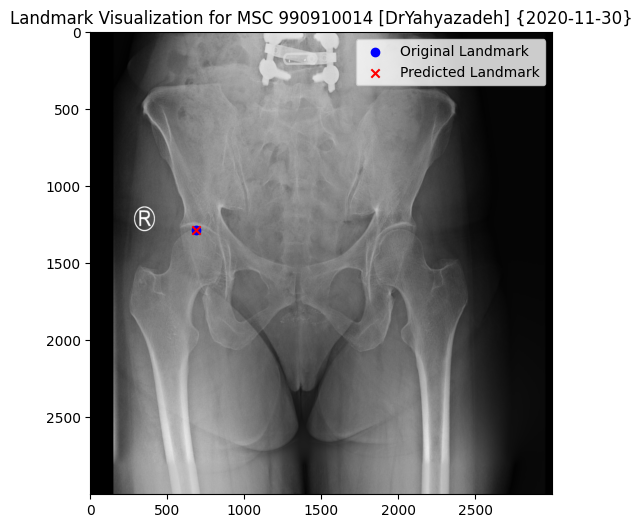

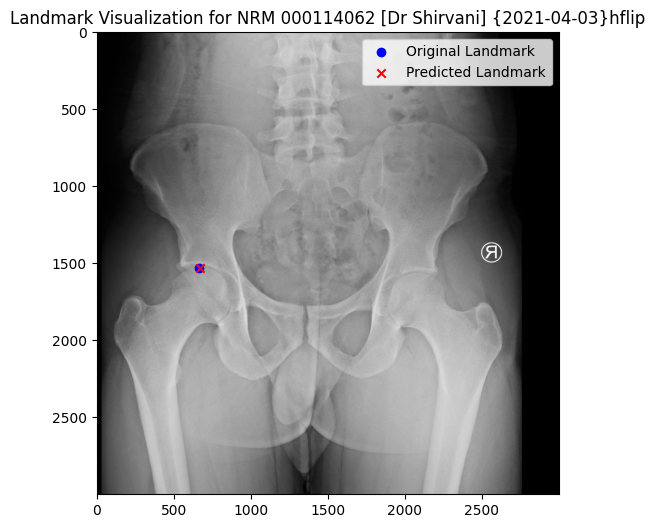

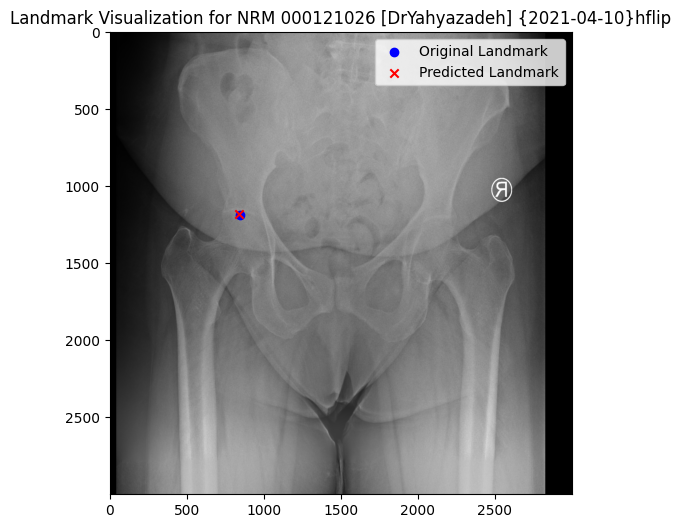

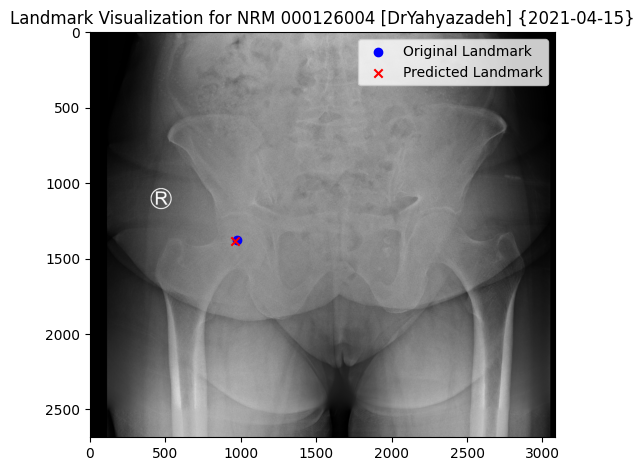

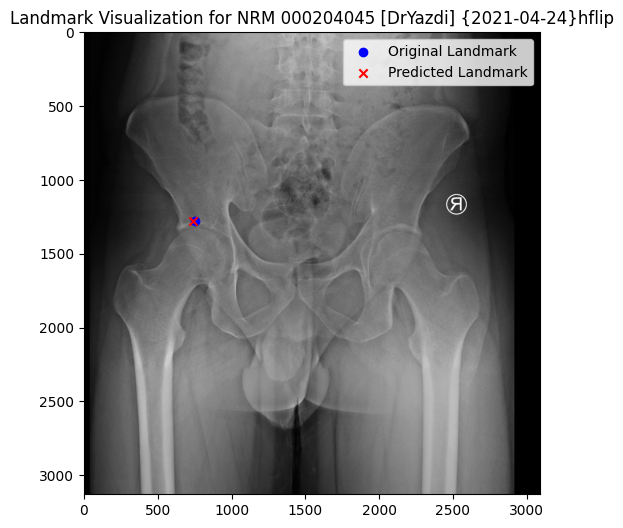

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadProx4.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark5(LHeadDist)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 8:10]
val_landmarks_first = val_landmarks[:, 8:10]
test_landmarks_first = test_landmarks[:, 8:10]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_fifth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 9857.6211 - mae: 94.9296

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 44s 742ms/step - loss: 9857.6211 - mae: 94.9296 - val_loss: 9292.2949 - val_mae: 92.9641
Epoch 2/400
19/19 [==============================] - 9s 465ms/step - loss: 8115.2627 - mae: 88.1351 - val_loss: 5926.3242 - val_mae: 75.0723
Epoch 3/400
19/19 [==============================] - 7s 342ms/step - loss: 5703.8833 - mae: 73.3865 - val_loss: 5981.8818 - val_mae: 66.9548
Epoch 4/400
19/19 [==============================] - 9s 457ms/step - loss: 4065.4617 - mae: 57.8915 - val_loss: 2083.0818 - val_mae: 37.2768
Epoch 5/400
19/19 [==============================] - 8s 439ms/step - loss: 2019.0786 - mae: 40.8952 - val_loss: 301.1222 - val_mae: 13.2484
Epoch 6/400
19/19 [==============================] - 8s 432ms/step - loss: 777.3494 - mae: 22.7146 - val_loss: 186.8978 - val_mae: 11.5744
Epoch 7/400
19/19 [==============================] - 6s 328ms/step - loss: 434.1224 - mae: 16.4215 - val_loss: 483.2509 - val_mae: 20.1797
Epoch 8/400
19/19 [==========

4/4 [==============================] - 0s 100ms/step - loss: 5.7483 - mae: 1.8594
Test Loss: 5.748327255249023
Test MAE: 1.8594069480895996
4/4 [==============================] - 1s 86ms/step
-0.296081929524739 0.6648319905598896


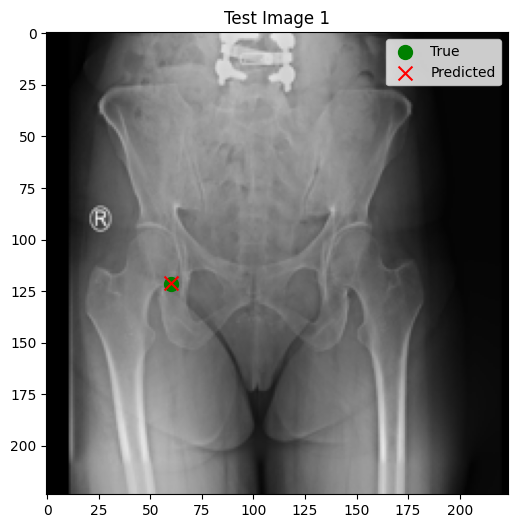

-3.3572053629557317 -0.019604125976570685


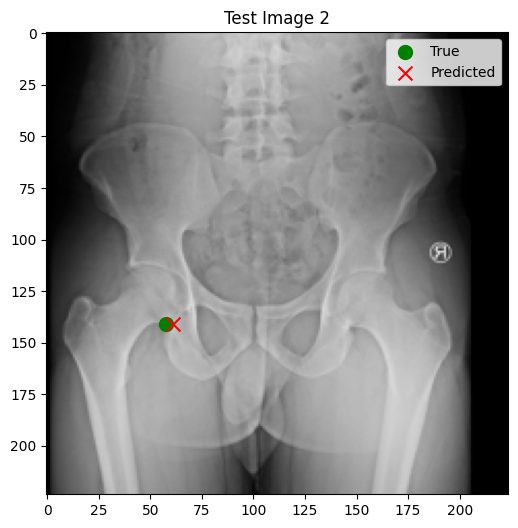

1.2342104288736948 -0.41164933268228765


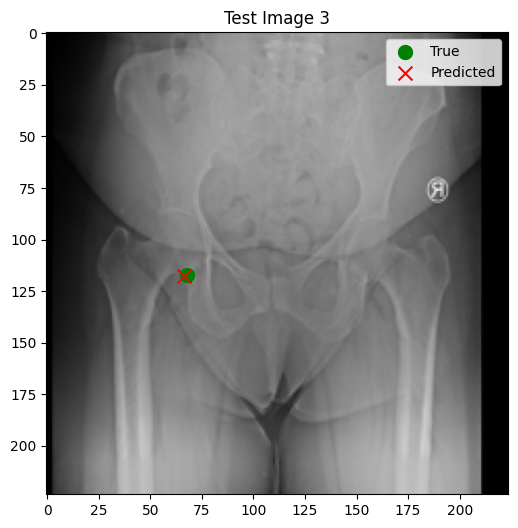

6.377775268554686 2.219083048502597


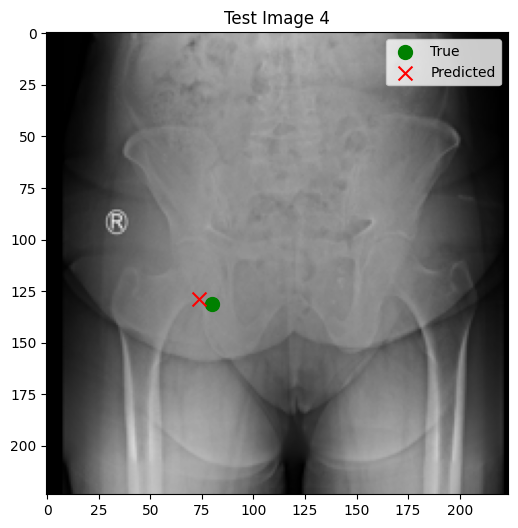

-0.995232716878256 2.2980749308268287


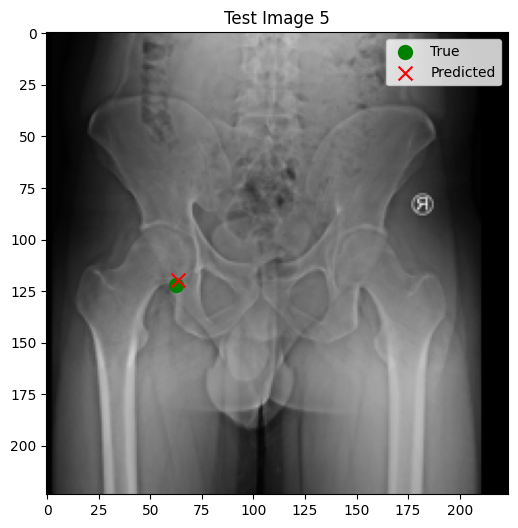

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LHeadDist5.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 87ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LHeadDist5.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 86ms/step
Maximum error in x direction: 7.791517537434899
Maximum error in y direction: 6.626972615559907


#Part 2_Landmark_5(LHeadDist)

##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_fifth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LHeadDist-x", "LHeadDist-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LHeadDist-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LHeadDist-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details5.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 23ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped5.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped5.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped5.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped5.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped5.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped5.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped5.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped5.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped5.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped5.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped5.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped5.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_5[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_fifth_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 132.5814 - mae: 92.7846 - euclidean_distance: 132.5814

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 31s 571ms/step - loss: 132.3177 - mae: 92.5930 - euclidean_distance: 132.3177 - val_loss: 337.7235 - val_mae: 215.5701 - val_euclidean_distance: 337.7235
Epoch 2/400
37/37 [==============================] - 5s 127ms/step - loss: 48.2124 - mae: 30.5805 - euclidean_distance: 48.2124 - val_loss: 56.4752 - val_mae: 36.3808 - val_euclidean_distance: 56.4752
Epoch 3/400
37/37 [==============================] - 5s 131ms/step - loss: 22.9924 - mae: 14.7830 - euclidean_distance: 22.9924 - val_loss: 32.0571 - val_mae: 19.7246 - val_euclidean_distance: 32.0571
Epoch 4/400
37/37 [==============================] - 3s 91ms/step - loss: 20.1865 - mae: 12.9728 - euclidean_distance: 20.1865 - val_loss: 44.9911 - val_mae: 29.5645 - val_euclidean_distance: 44.9911
Epoch 5/400
37/37 [==============================] - 3s 95ms/step - loss: 19.8929 - mae: 12.7288 - euclidean_distance: 19.8929 - val_loss: 36.0568 - val_mae: 23.0529 - val_euclidean_distance: 36.0568
Epo

##result

In [ ]:
#checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_fifth_landmark_Part2.h5'


In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 95ms/step - loss: 9.6600 - mae: 6.2507 - euclidean_distance: 9.6600
Test Loss: 9.660002708435059, Test MAE: 6.250707149505615, Test Euclidean Distance: 1.9320005416870116 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LHeadDist-x', 'LHeadDist-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details5.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadDistal5.csv', index=False)


4/4 [==============================] - 3s 102ms/step


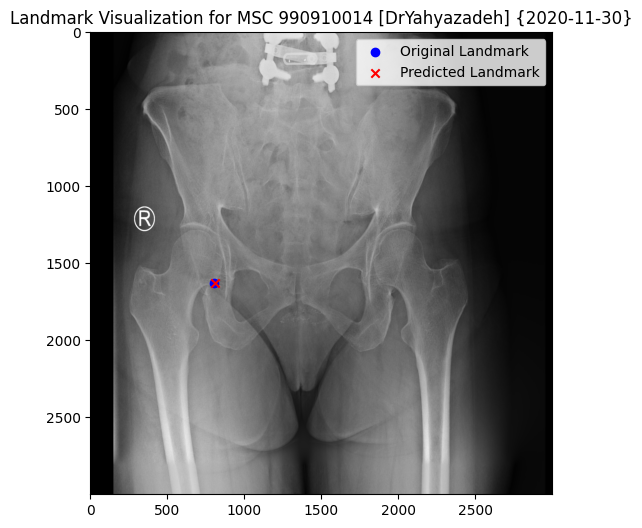

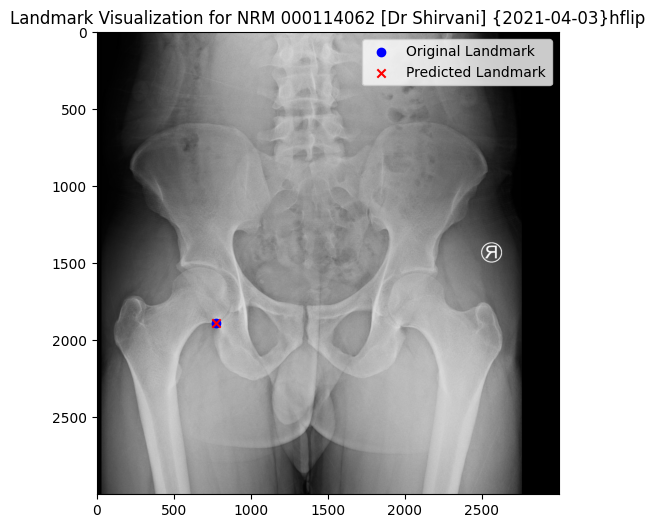

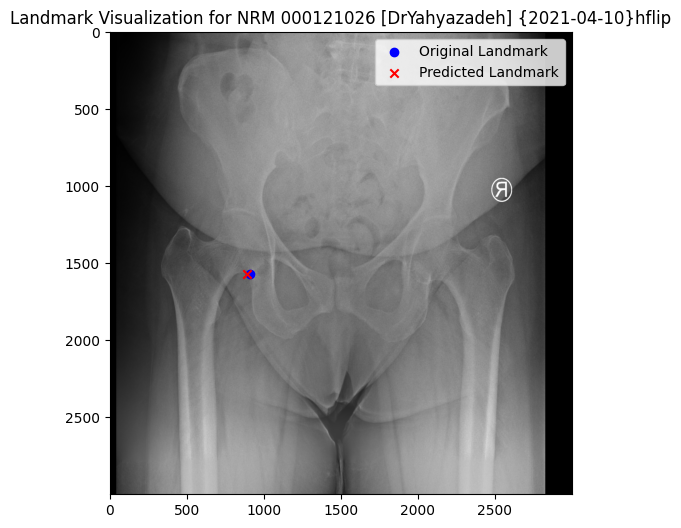

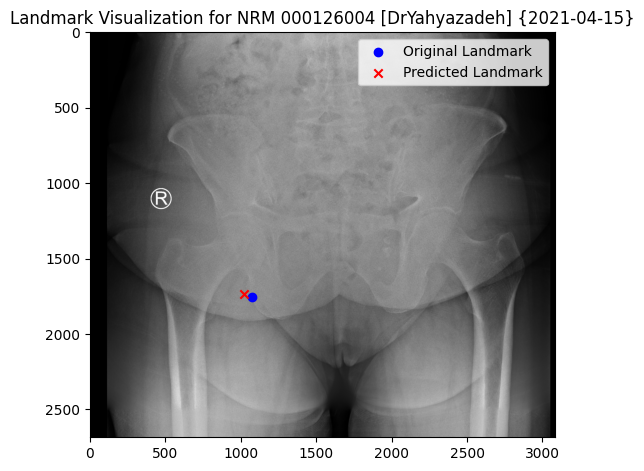

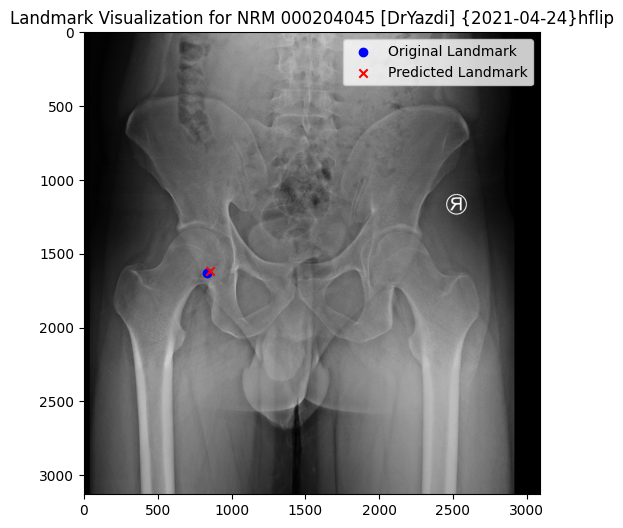

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadDistal5.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark6(LNeck3)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 10:12]
val_landmarks_first = val_landmarks[:, 10:12]
test_landmarks_first = test_landmarks[:, 10:12]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_6 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_6[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_sixth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 6368.6045 - mae: 72.1359

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 49s 1s/step - loss: 6368.6045 - mae: 72.1359 - val_loss: 2667.9097 - val_mae: 44.1401
Epoch 2/400
19/19 [==============================] - 6s 337ms/step - loss: 2382.6726 - mae: 40.5577 - val_loss: 3193.9558 - val_mae: 50.0526
Epoch 3/400
19/19 [==============================] - 6s 328ms/step - loss: 273.0031 - mae: 13.1776 - val_loss: 6055.0957 - val_mae: 69.5363
Epoch 4/400
19/19 [==============================] - 12s 677ms/step - loss: 191.4231 - mae: 11.1036 - val_loss: 852.9631 - val_mae: 25.2295
Epoch 5/400
19/19 [==============================] - 8s 436ms/step - loss: 159.1802 - mae: 9.8433 - val_loss: 150.0826 - val_mae: 9.1487
Epoch 6/400
19/19 [==============================] - 11s 598ms/step - loss: 135.1963 - mae: 9.2243 - val_loss: 75.3410 - val_mae: 6.2487
Epoch 7/400
19/19 [==============================] - 6s 337ms/step - loss: 143.4096 - mae: 9.3344 - val_loss: 259.3921 - val_mae: 14.1259
Epoch 8/400
19/19 [=====================

4/4 [==============================] - 0s 100ms/step - loss: 8.6083 - mae: 2.2695
Test Loss: 8.608345031738281
Test MAE: 2.269543170928955
4/4 [==============================] - 1s 87ms/step
1.8454493001302055 1.8634019571940144


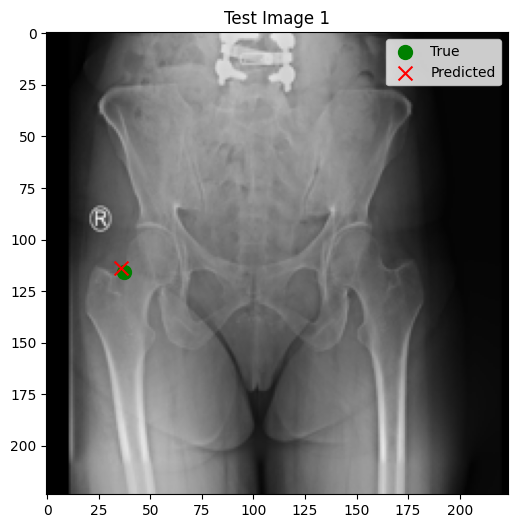

2.242588277180989 2.0349946289062473


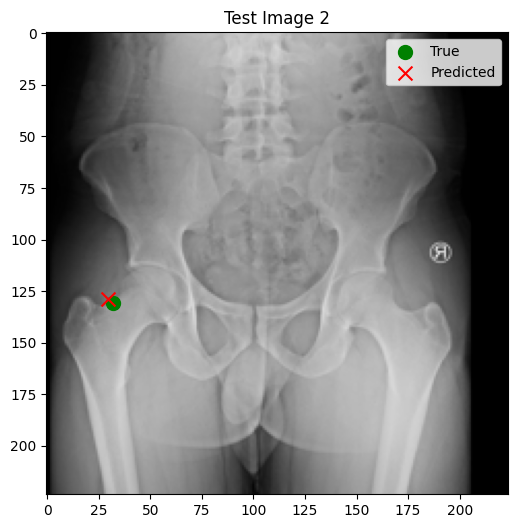

3.033197587646484 -3.437256402018221


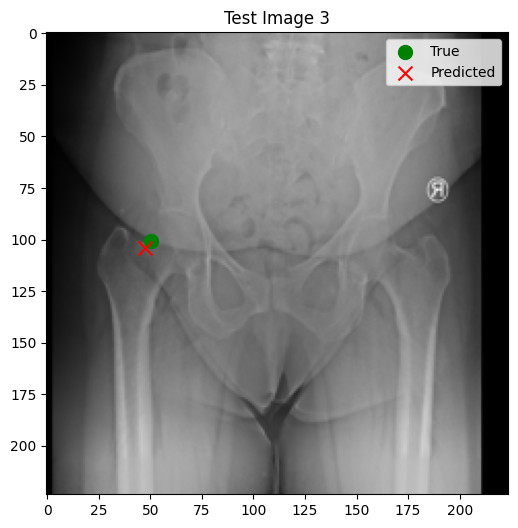

2.46139939371745 0.8027856241861997


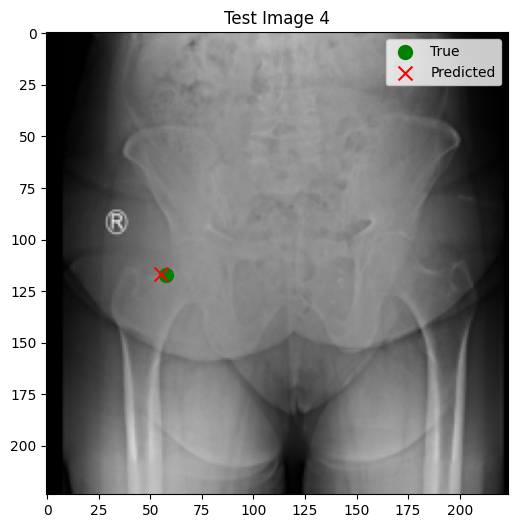

2.3410322128906245 -0.9949479436848918


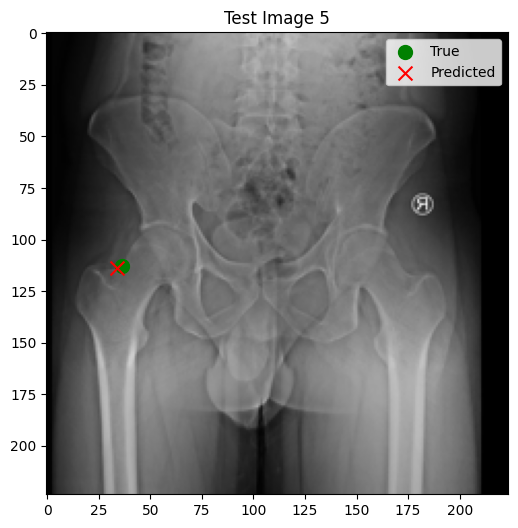

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LNeck3_6.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 85ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LNeck3_6.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 86ms/step
Maximum error in x direction: 12.597160688720699
Maximum error in y direction: 7.443200351399739


#Part 2_Landmark_6(LNeck3)

##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_sixth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LNeck3-x", "LNeck3-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2

# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LNeck3-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LNeck3-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details6.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 48ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped6.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped6.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped6.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped6.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped6.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped6.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped6.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped6.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped6.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped6.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped6.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped6.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_7[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_sixth_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 156.9451 - mae: 110.4161 - euclidean_distance: 156.9451

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 31s 530ms/step - loss: 156.7962 - mae: 110.3138 - euclidean_distance: 156.7962 - val_loss: 230.4158 - val_mae: 124.5938 - val_euclidean_distance: 230.4158
Epoch 2/400
37/37 [==============================] - 5s 129ms/step - loss: 95.4358 - mae: 63.6806 - euclidean_distance: 95.4358 - val_loss: 128.2146 - val_mae: 72.0998 - val_euclidean_distance: 128.2146
Epoch 3/400
37/37 [==============================] - 5s 124ms/step - loss: 34.4955 - mae: 21.7584 - euclidean_distance: 34.4955 - val_loss: 34.3607 - val_mae: 22.2914 - val_euclidean_distance: 34.3607
Epoch 4/400
37/37 [==============================] - 3s 86ms/step - loss: 20.1650 - mae: 13.0572 - euclidean_distance: 20.1650 - val_loss: 41.0552 - val_mae: 26.8196 - val_euclidean_distance: 41.0552
Epoch 5/400
37/37 [==============================] - 3s 90ms/step - loss: 19.4670 - mae: 12.6767 - euclidean_distance: 19.4670 - val_loss: 45.8848 - val_mae: 30.3475 - val_euclidean_distance: 45.8848


##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 93ms/step - loss: 7.2006 - mae: 4.6156 - euclidean_distance: 7.2006
Test Loss: 7.200594425201416, Test MAE: 4.615574359893799, Test Euclidean Distance: 1.440118885040283 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LNeck3-x', 'LNeck3-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details6.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLNeck3_6.csv', index=False)


4/4 [==============================] - 1s 87ms/step


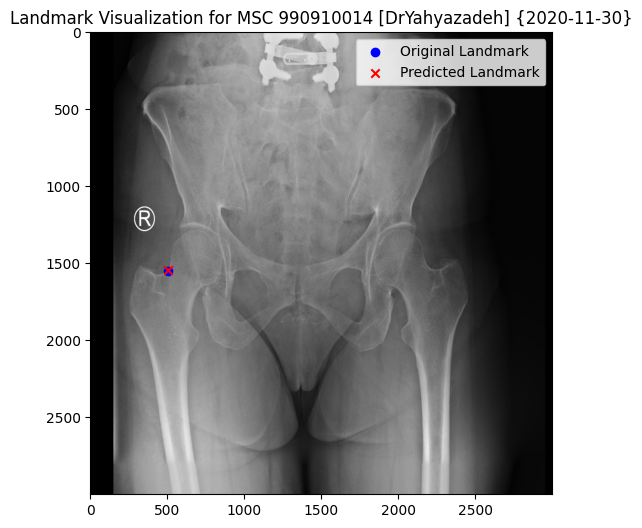

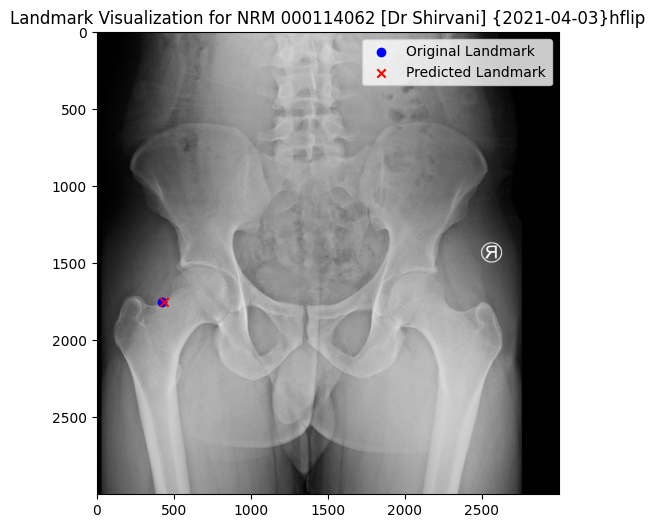

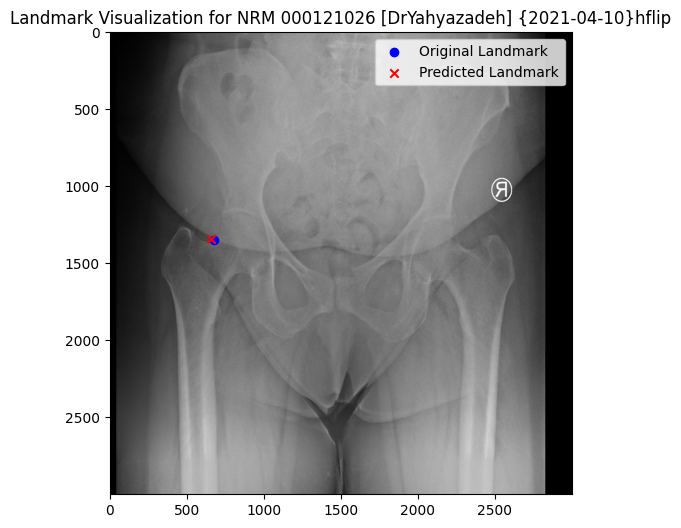

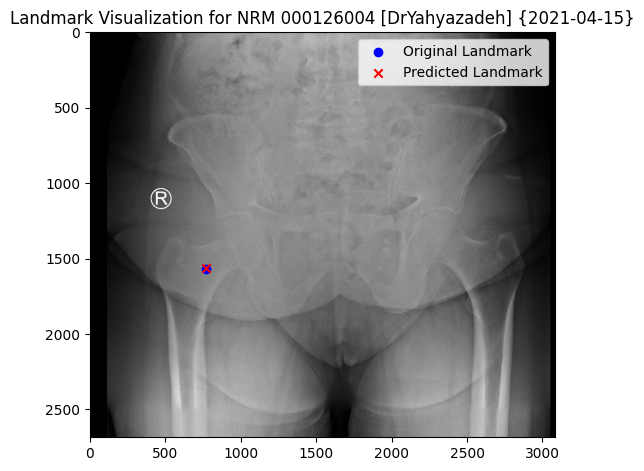

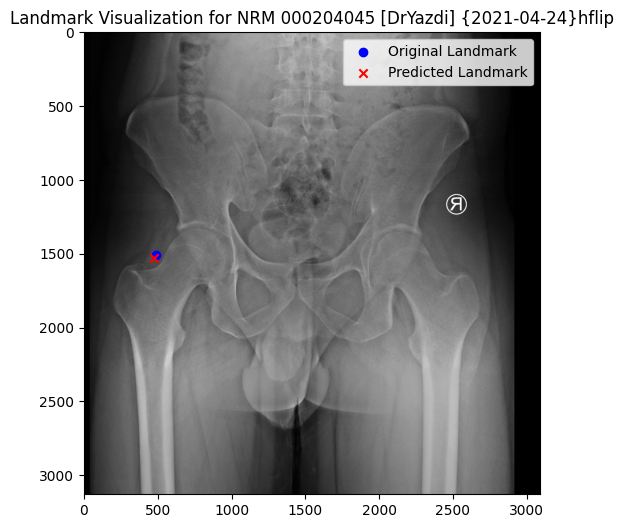

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLNeck3_6.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark7(LNeck8)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 12:14]
val_landmarks_first = val_landmarks[:, 12:14]
test_landmarks_first = test_landmarks[:, 12:14]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_8[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_seventh700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 9286.0703 - mae: 90.0003

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 50s 1s/step - loss: 9286.0703 - mae: 90.0003 - val_loss: 7431.6250 - val_mae: 80.6099
Epoch 2/400
19/19 [==============================] - 10s 541ms/step - loss: 5896.1885 - mae: 71.6729 - val_loss: 6829.5088 - val_mae: 66.5320
Epoch 3/400
19/19 [==============================] - 6s 330ms/step - loss: 1348.5638 - mae: 31.4689 - val_loss: 36397.1562 - val_mae: 165.4550
Epoch 4/400
19/19 [==============================] - 6s 339ms/step - loss: 283.8929 - mae: 13.1419 - val_loss: 7571.8838 - val_mae: 76.8718
Epoch 5/400
19/19 [==============================] - 18s 1s/step - loss: 241.6799 - mae: 11.9731 - val_loss: 506.8334 - val_mae: 18.9562
Epoch 6/400
19/19 [==============================] - 6s 330ms/step - loss: 197.0735 - mae: 10.9871 - val_loss: 561.0850 - val_mae: 20.4440
Epoch 7/400
19/19 [==============================] - 10s 547ms/step - loss: 187.6758 - mae: 10.5898 - val_loss: 160.9823 - val_mae: 10.0410
Epoch 8/400
19/19 [=============

4/4 [==============================] - 0s 95ms/step - loss: 3.4776 - mae: 1.4620
Test Loss: 3.47758150100708
Test MAE: 1.4620155096054077
4/4 [==============================] - 1s 86ms/step
1.7756971638997427 0.6824744466145773


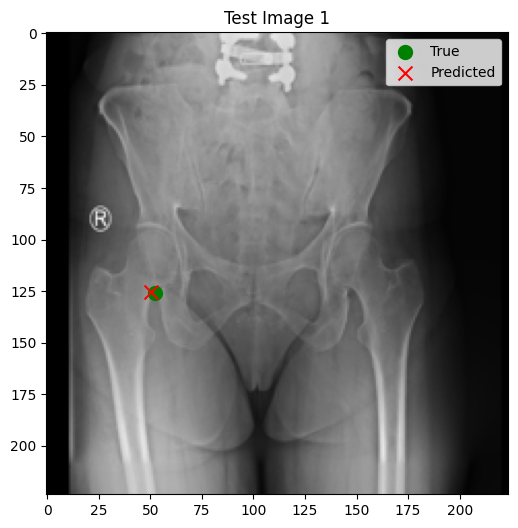

-2.872854258219398 -2.4356429850260497


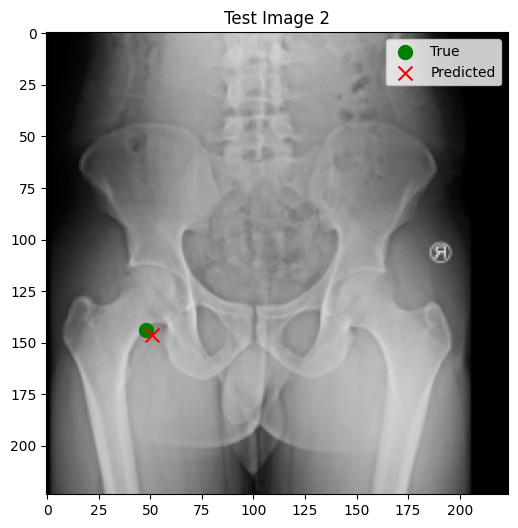

3.1793943853352857 1.2530375366210933


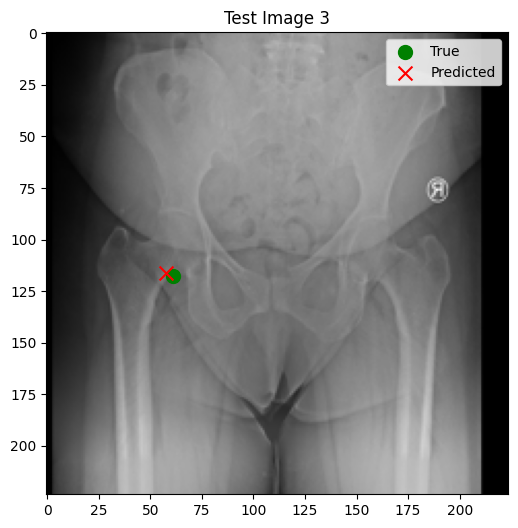

0.2185104436848917 1.1967707112630137


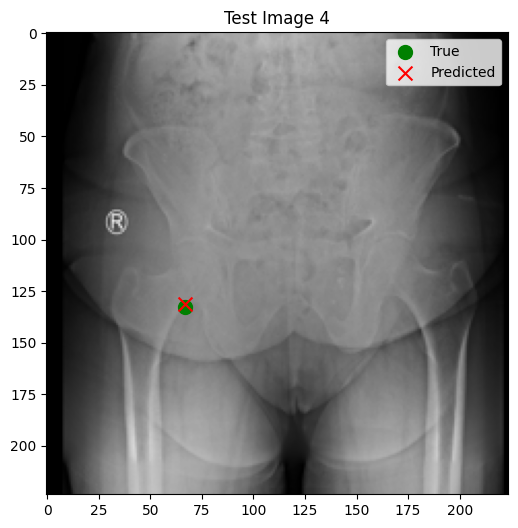

0.011179402669270644 1.3479374933268247


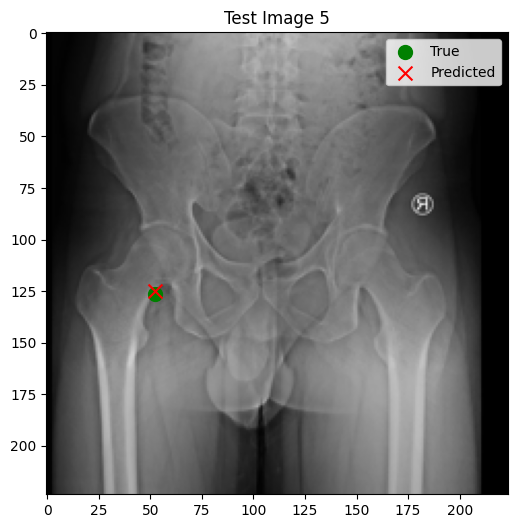

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LNeck8_7.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 87ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LNeck8_7.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 87ms/step
Maximum error in x direction: 5.185880635579423
Maximum error in y direction: 5.664174072265638


#Part 2_Landmark_7(LNeck8)

##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_seventh700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LNeck8-x", "LNeck8-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2

# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LNeck8-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LNeck8-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details7.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 23ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped7.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped7.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped7.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped7.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped7.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped7.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped7.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped7.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped7.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped7.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped7.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped7.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_8"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_9 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_9[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_seventh_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 161.6714 - mae: 114.1181 - euclidean_distance: 161.6714

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 25s 422ms/step - loss: 161.6899 - mae: 114.1325 - euclidean_distance: 161.6899 - val_loss: 142.8821 - val_mae: 83.9563 - val_euclidean_distance: 142.8821
Epoch 2/400
37/37 [==============================] - 10s 265ms/step - loss: 146.5648 - mae: 102.6478 - euclidean_distance: 146.5648 - val_loss: 98.5429 - val_mae: 66.3867 - val_euclidean_distance: 98.5429
Epoch 3/400
37/37 [==============================] - 10s 279ms/step - loss: 103.4796 - mae: 71.5225 - euclidean_distance: 103.4796 - val_loss: 38.5570 - val_mae: 24.3791 - val_euclidean_distance: 38.5570
Epoch 4/400
37/37 [==============================] - 3s 93ms/step - loss: 44.4128 - mae: 28.6387 - euclidean_distance: 44.4128 - val_loss: 67.3054 - val_mae: 46.5741 - val_euclidean_distance: 67.3054
Epoch 5/400
37/37 [==============================] - 7s 191ms/step - loss: 31.4035 - mae: 20.1797 - euclidean_distance: 31.4035 - val_loss: 36.0618 - val_mae: 23.6627 - val_euclidean_distance: 36.

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 93ms/step - loss: 7.8630 - mae: 5.2559 - euclidean_distance: 7.8630
Test Loss: 7.8630051612854, Test MAE: 5.255945682525635, Test Euclidean Distance: 1.57260103225708 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LNeck8-x', 'LNeck8-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details7.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLNeck8_7.csv', index=False)


4/4 [==============================] - 1s 88ms/step


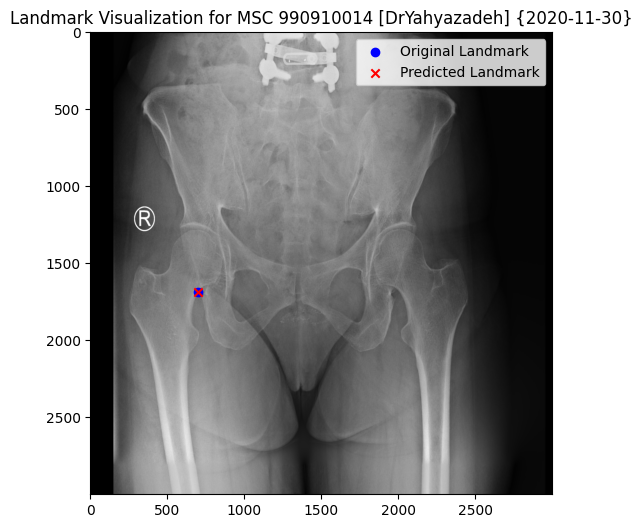

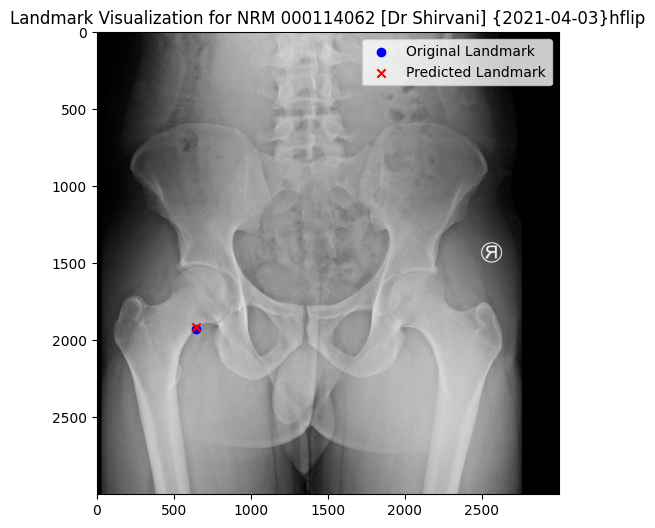

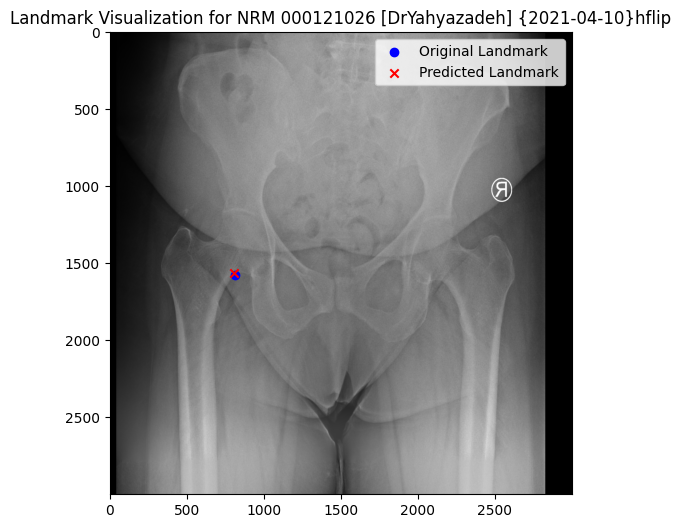

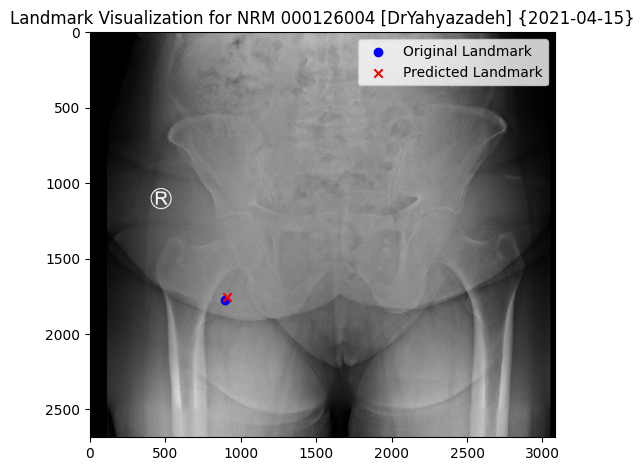

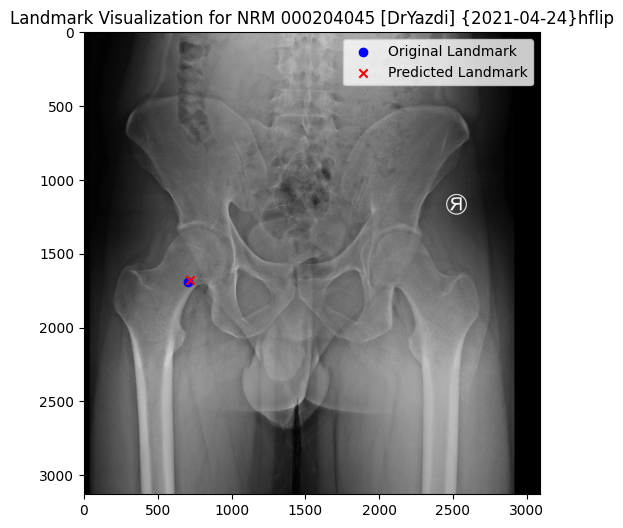

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LHeadLNeck8_7.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark8(LEnterLat)




In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 14:16]
val_landmarks_first = val_landmarks[:, 14:16]
test_landmarks_first = test_landmarks[:, 14:16]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_10 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_10[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_eighth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 22990.8477 - mae: 122.1290

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 48s 1s/step - loss: 22990.8477 - mae: 122.1290 - val_loss: 10680.5244 - val_mae: 76.8313
Epoch 2/400
19/19 [==============================] - 6s 340ms/step - loss: 11710.1885 - mae: 81.6645 - val_loss: 33531.6836 - val_mae: 177.7475
Epoch 3/400
19/19 [==============================] - 6s 342ms/step - loss: 2399.6648 - mae: 42.7757 - val_loss: 40358.4766 - val_mae: 193.9985
Epoch 4/400
19/19 [==============================] - 6s 339ms/step - loss: 1311.5470 - mae: 31.2759 - val_loss: 14859.2344 - val_mae: 117.5150
Epoch 5/400
19/19 [==============================] - 20s 1s/step - loss: 968.6519 - mae: 26.8329 - val_loss: 2549.6418 - val_mae: 49.1623
Epoch 6/400
19/19 [==============================] - 9s 463ms/step - loss: 735.2106 - mae: 22.9347 - val_loss: 358.1330 - val_mae: 14.9458
Epoch 7/400
19/19 [==============================] - 6s 329ms/step - loss: 597.8085 - mae: 20.4846 - val_loss: 537.3752 - val_mae: 20.9612
Epoch 8/400
19/19 [=====

4/4 [==============================] - 0s 97ms/step - loss: 9.6853 - mae: 2.2878
Test Loss: 9.685280799865723
Test MAE: 2.2877860069274902
4/4 [==============================] - 1s 86ms/step
0.2918930867513012 0.6860902913411451


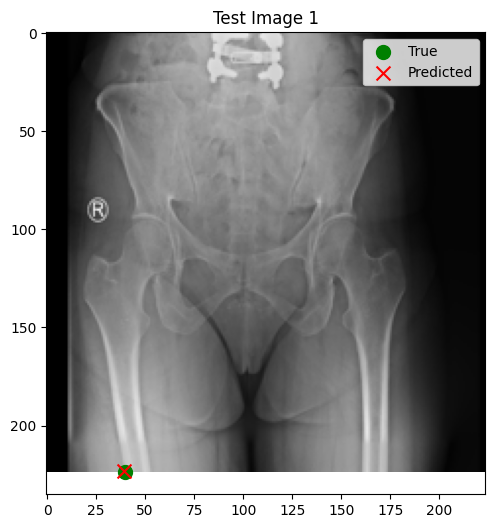

-2.593805755615236 1.22231465657552


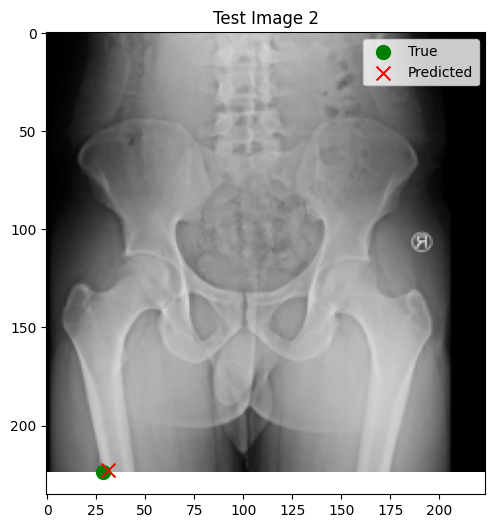

0.5981548868815096 0.7703188069661451


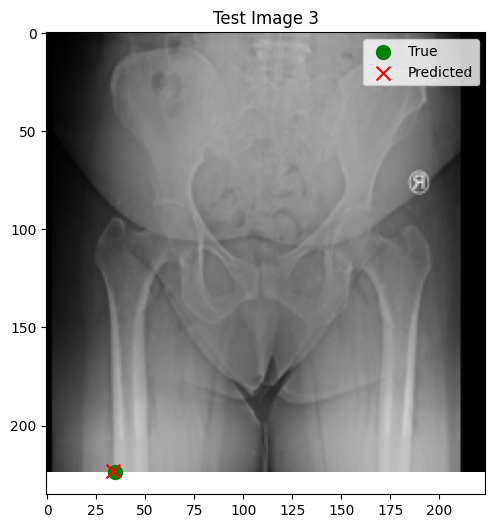

0.36234673055012934 -0.05702355957032523


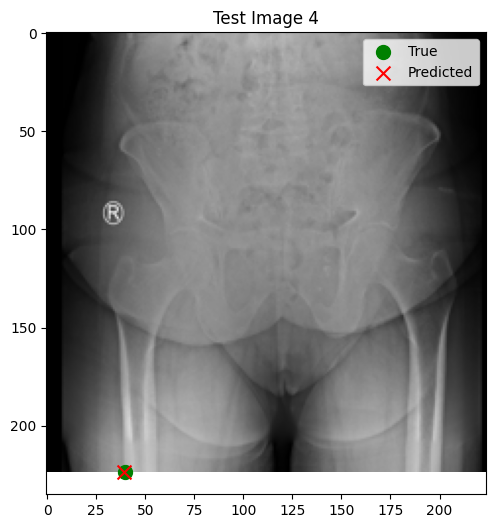

-1.3423053385416672 0.05542732747395007


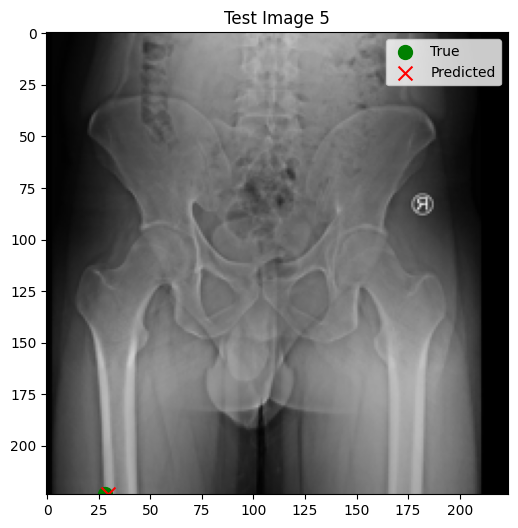

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LEnterLat8.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 88ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LEnterLat8.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 86ms/step
Maximum error in x direction: 11.367070315999342
Maximum error in y direction: 9.543758721354152


#Part 2_Landmark_8(LEnterLat)

##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_eighth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LEnterLat-x", "LEnterLat-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y +crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LEnterLat-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (orig_height - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details8.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 23ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped8.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped8.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped8.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped8.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped8.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped8.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped8.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped8.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped8.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped8.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped8.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped8.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_10"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_11 (InputLayer)       [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_11[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                       

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_eighth_landmark_Part2_1000.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 241.6049 - mae: 161.1885 - euclidean_distance: 241.6049

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 27s 454ms/step - loss: 241.4214 - mae: 161.0404 - euclidean_distance: 241.4214 - val_loss: 135.3914 - val_mae: 78.0776 - val_euclidean_distance: 135.3914
Epoch 2/400
37/37 [==============================] - 3s 90ms/step - loss: 161.1466 - mae: 100.6177 - euclidean_distance: 161.1466 - val_loss: 185.2821 - val_mae: 125.3979 - val_euclidean_distance: 185.2821
Epoch 3/400
37/37 [==============================] - 8s 211ms/step - loss: 47.8813 - mae: 30.4290 - euclidean_distance: 47.8813 - val_loss: 56.5149 - val_mae: 37.7042 - val_euclidean_distance: 56.5149
Epoch 4/400
37/37 [==============================] - 5s 131ms/step - loss: 32.1851 - mae: 20.7347 - euclidean_distance: 32.1851 - val_loss: 44.5700 - val_mae: 28.2946 - val_euclidean_distance: 44.5700
Epoch 5/400
37/37 [==============================] - 3s 89ms/step - loss: 31.9251 - mae: 20.4974 - euclidean_distance: 31.9251 - val_loss: 85.9292 - val_mae: 56.9329 - val_euclidean_distance: 85.92

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 92ms/step - loss: 2.9171 - mae: 1.8222 - euclidean_distance: 2.9171
Test Loss: 2.9171223640441895, Test MAE: 1.822235345840454, Test Euclidean Distance: 0.5834244728088379 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LEnterLat-x']

# Extract the landmark data from the DataFrame
test_landmarksx = df[landmark_columns].values

# Convert the extracted data to a NumPy array

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details8.csv')
test_transformation_details = transformation_details.iloc[test_indices]

orig_height = ['OrigHeight']
test_landmarksy = test_transformation_details[orig_height].values

test_landmarks_orgx = np.array(test_landmarksx)
test_landmarks_orgy = np.array(test_landmarksy)

test_landmarks_org = np.column_stack((test_landmarks_orgx, test_landmarks_orgy))

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LEnterLat8.csv', index=False)


4/4 [==============================] - 1s 86ms/step


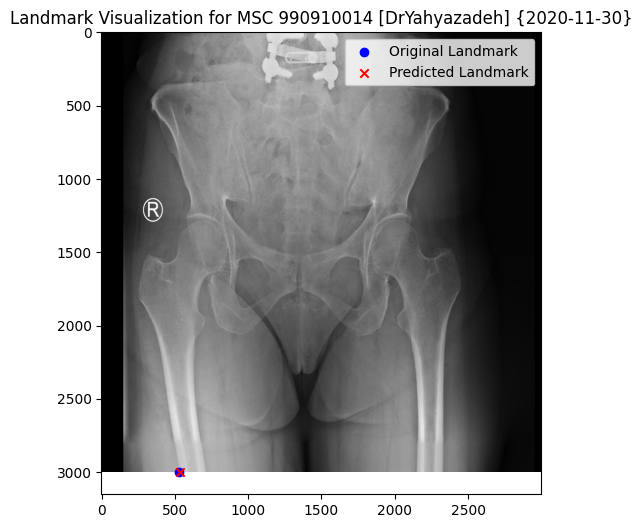

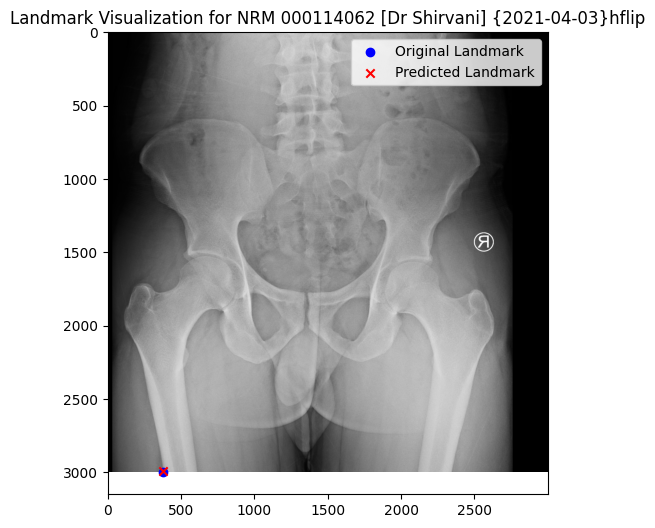

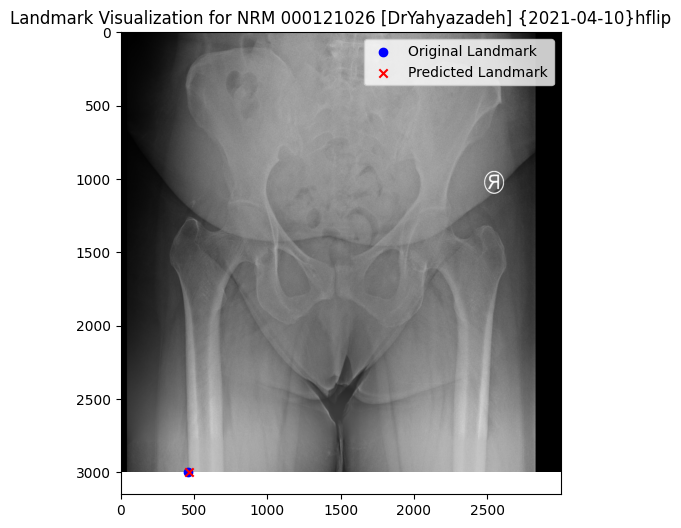

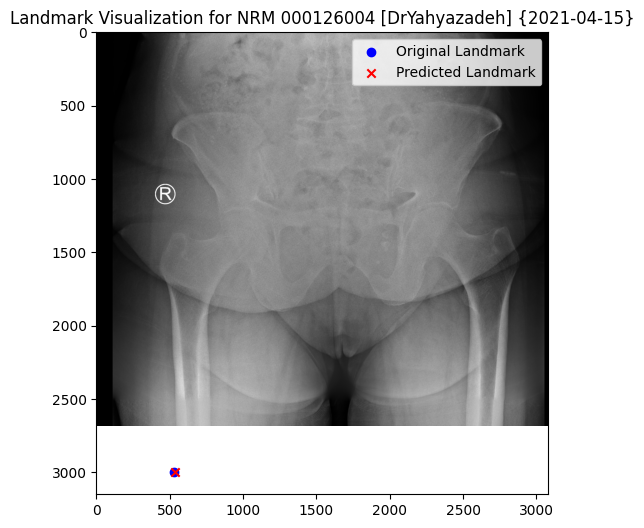

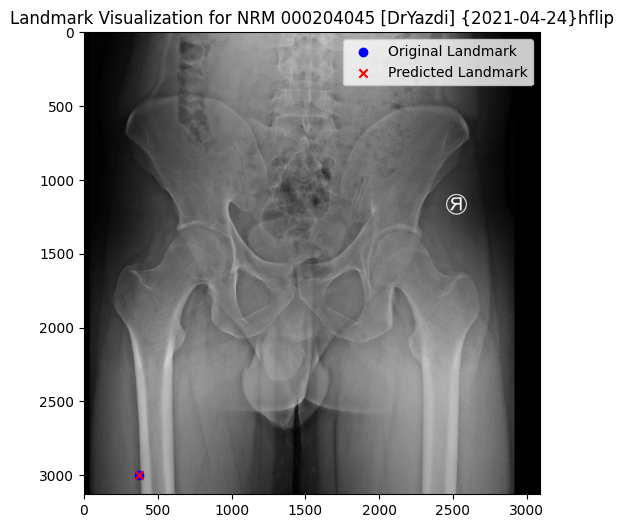

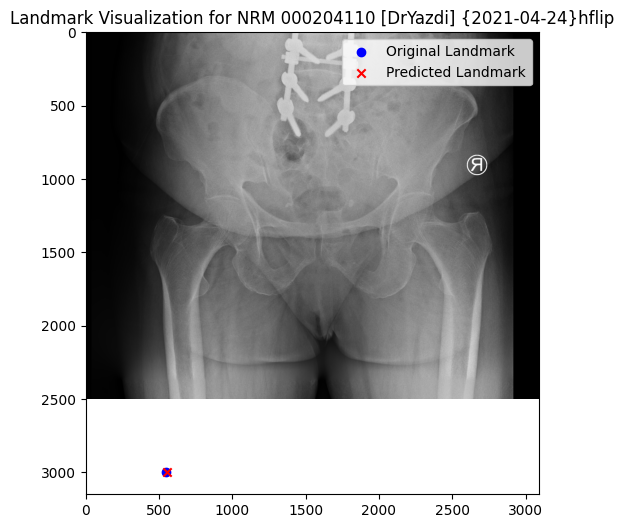

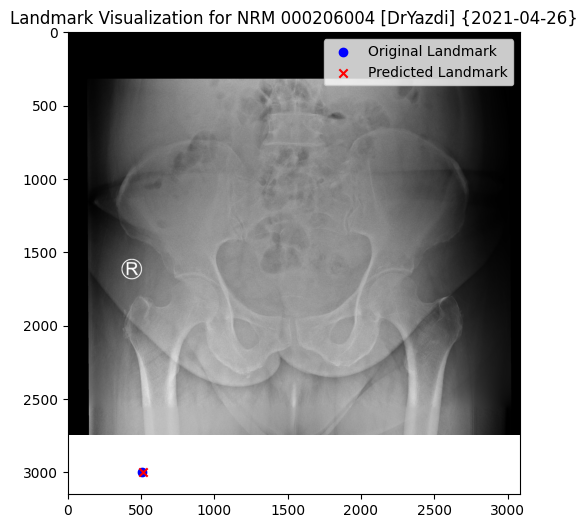

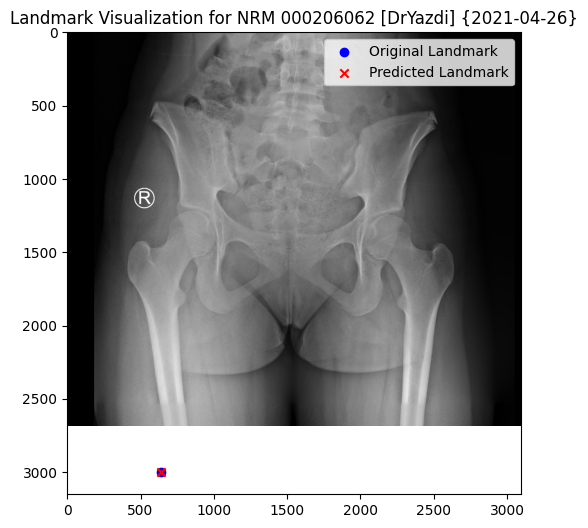

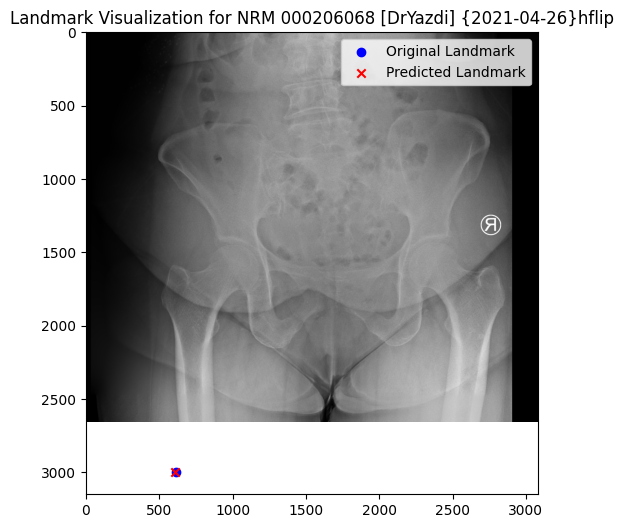

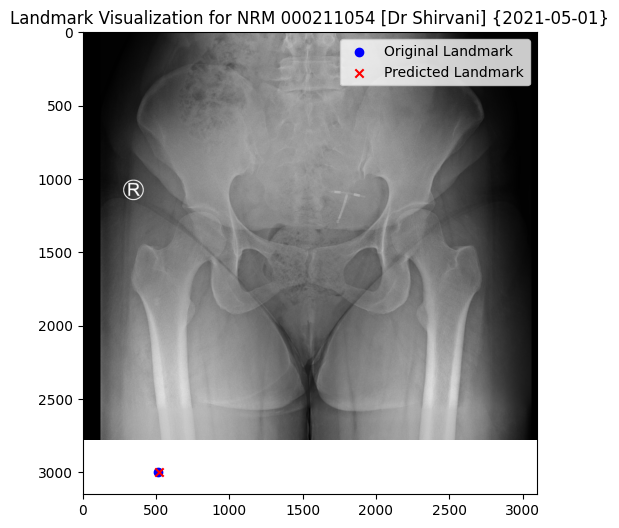

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LEnterLat8.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(10)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark9(LEnterMed)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 16:18]
val_landmarks_first = val_landmarks[:, 16:18]
test_landmarks_first = test_landmarks[:, 16:18]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 1s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_ninth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 25203.3594 - mae: 136.1420

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 59s 973ms/step - loss: 25203.3594 - mae: 136.1420 - val_loss: 17094.8379 - val_mae: 112.7644
Epoch 2/400
19/19 [==============================] - 8s 423ms/step - loss: 18085.3496 - mae: 115.1541 - val_loss: 1245.5852 - val_mae: 24.6916
Epoch 3/400
19/19 [==============================] - 6s 322ms/step - loss: 7067.2285 - mae: 69.2647 - val_loss: 12372.0703 - val_mae: 93.1239
Epoch 4/400
19/19 [==============================] - 6s 312ms/step - loss: 900.0335 - mae: 22.1175 - val_loss: 11836.3438 - val_mae: 91.3774
Epoch 5/400
19/19 [==============================] - 6s 326ms/step - loss: 500.6766 - mae: 17.2482 - val_loss: 4350.3770 - val_mae: 55.2471
Epoch 6/400
19/19 [==============================] - 10s 558ms/step - loss: 465.6989 - mae: 16.3879 - val_loss: 291.7996 - val_mae: 11.7205
Epoch 7/400
19/19 [==============================] - 6s 327ms/step - loss: 451.5876 - mae: 15.9646 - val_loss: 431.4688 - val_mae: 17.0881
Epoch 8/400
19/19 [==

4/4 [==============================] - 3s 782ms/step - loss: 7.1200 - mae: 2.0455
Test Loss: 7.120000839233398
Test MAE: 2.0454788208007812
4/4 [==============================] - 2s 88ms/step
0.5796968688964839 -1.75201416015625


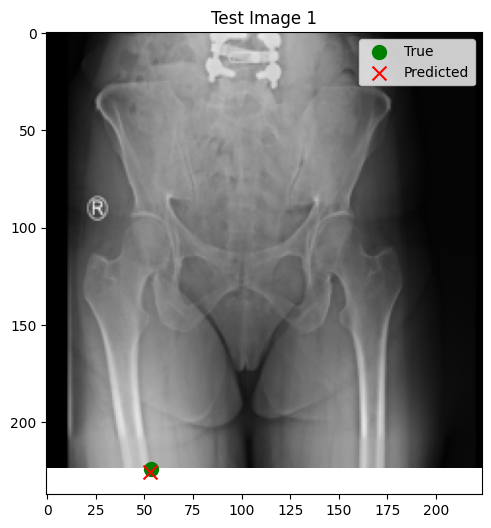

-1.5948759460449224 -2.7052764892578125


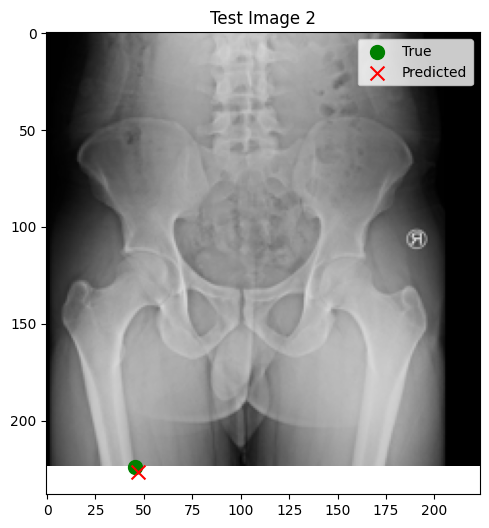

1.2112097066243521 0.213134765625


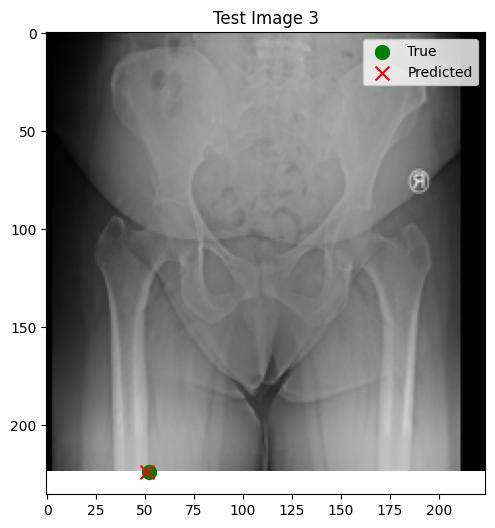

1.4087078653971332 -1.8721466064453125


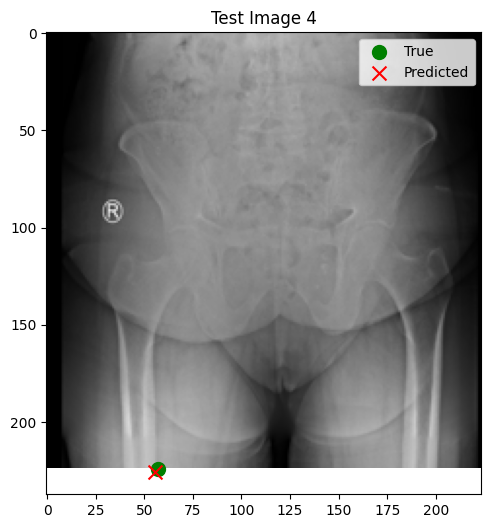

-0.7392667643229132 -4.0719757080078125


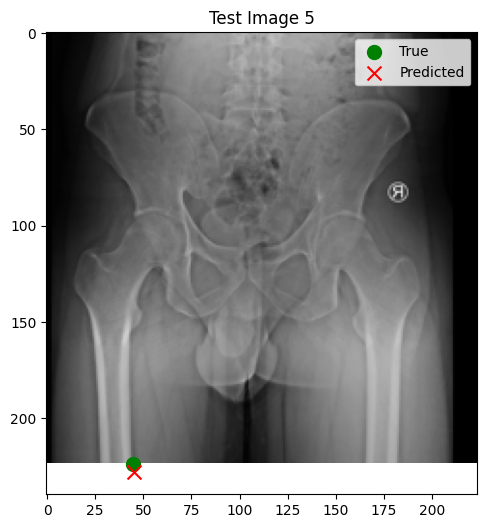

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LEnterMed_9.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 86ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LEnterMed_9.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 110ms/step
Maximum error in x direction: 14.201598449707031
Maximum error in y direction: 9.599441528320312


#Part 2_Landmark_9(LEnterMed)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_ninth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LEnterMed-x", "LEnterMed-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y +crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LEnterMed-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (orig_height - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details9.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 23ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped9.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped9.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped9.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped9.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped9.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped9.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped9.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped9.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped9.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped9.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped9.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped9.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_ninth_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 236.4673 - mae: 159.5658 - euclidean_distance: 236.4673

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 29s 439ms/step - loss: 236.3123 - mae: 159.4323 - euclidean_distance: 236.3123 - val_loss: 134.7761 - val_mae: 90.6346 - val_euclidean_distance: 134.7761
Epoch 2/400
37/37 [==============================] - 3s 86ms/step - loss: 120.9722 - mae: 81.8304 - euclidean_distance: 120.9722 - val_loss: 267.2180 - val_mae: 180.7098 - val_euclidean_distance: 267.2180
Epoch 3/400
37/37 [==============================] - 5s 130ms/step - loss: 32.0549 - mae: 20.4389 - euclidean_distance: 32.0549 - val_loss: 55.5919 - val_mae: 36.6588 - val_euclidean_distance: 55.5919
Epoch 4/400
37/37 [==============================] - 3s 91ms/step - loss: 30.8190 - mae: 19.8231 - euclidean_distance: 30.8190 - val_loss: 82.6716 - val_mae: 54.9807 - val_euclidean_distance: 82.6716
Epoch 5/400
37/37 [==============================] - 3s 86ms/step - loss: 28.2410 - mae: 18.0247 - euclidean_distance: 28.2410 - val_loss: 67.6368 - val_mae: 44.5068 - val_euclidean_distance: 67.6368

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 103ms/step - loss: 2.8560 - mae: 1.7298 - euclidean_distance: 2.8560
Test Loss: 2.8559632301330566, Test MAE: 1.729822039604187, Test Euclidean Distance: 0.5711926460266112 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LEnterMed-x']

# Extract the landmark data from the DataFrame
test_landmarksx = df[landmark_columns].values

# Convert the extracted data to a NumPy array

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details9.csv')
test_transformation_details = transformation_details.iloc[test_indices]

orig_height = ['OrigHeight']
test_landmarksy = test_transformation_details[orig_height].values

test_landmarks_orgx = np.array(test_landmarksx)
test_landmarks_orgy = np.array(test_landmarksy)

test_landmarks_org = np.column_stack((test_landmarks_orgx, test_landmarks_orgy))

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance (MAE) for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LEnterMed9.csv', index=False)


4/4 [==============================] - 2s 109ms/step


In [ ]:
test_landmarks_orgy.shape

(127, 1)

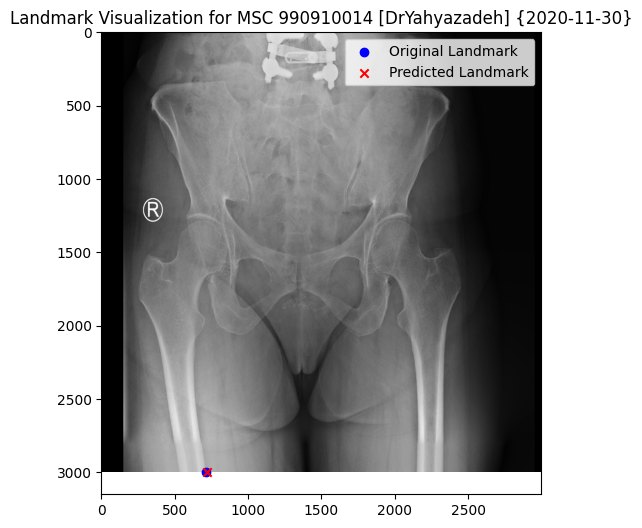

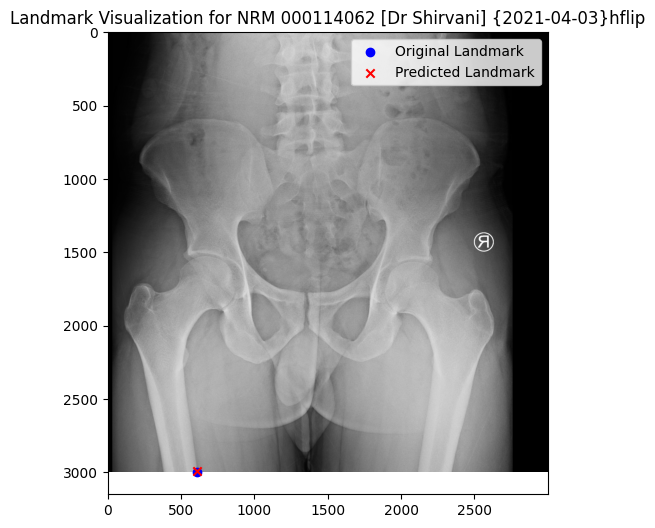

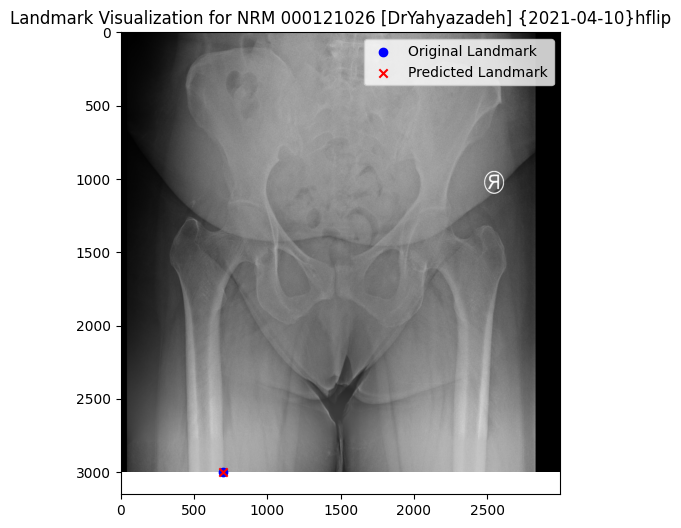

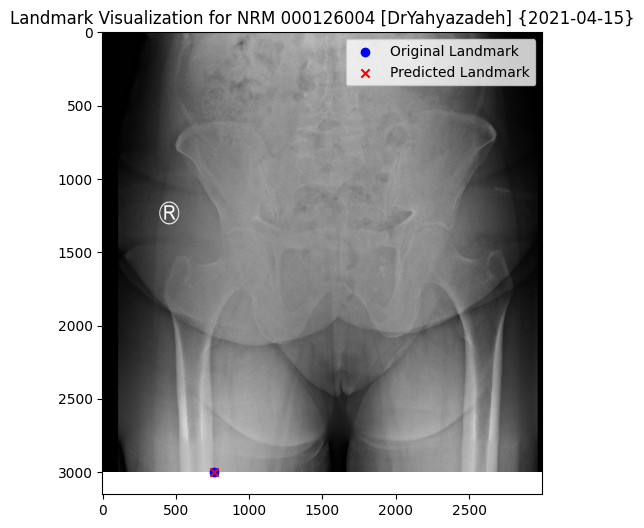

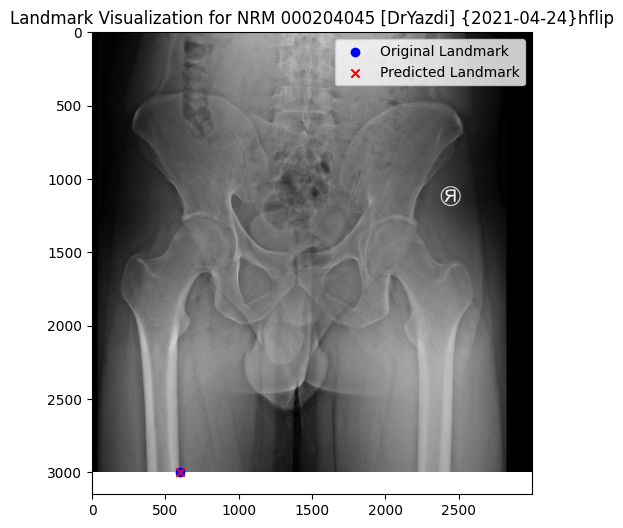

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LEnterMed9.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")


    # Load the image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark10(LShaftLat)

In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 18:20]
val_landmarks_first = val_landmarks[:, 18:20]
test_landmarks_first = test_landmarks[:, 18:20]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_tenth700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 11060.2334 - mae: 85.0180

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 49s 986ms/step - loss: 11060.2334 - mae: 85.0180 - val_loss: 5404.8804 - val_mae: 56.9870
Epoch 2/400
19/19 [==============================] - 6s 323ms/step - loss: 5617.4907 - mae: 58.1559 - val_loss: 12794.9893 - val_mae: 107.0796
Epoch 3/400
19/19 [==============================] - 6s 337ms/step - loss: 1944.1810 - mae: 40.4872 - val_loss: 21929.4629 - val_mae: 142.9994
Epoch 4/400
19/19 [==============================] - 6s 330ms/step - loss: 826.9846 - mae: 24.5941 - val_loss: 8447.9766 - val_mae: 83.7774
Epoch 5/400
19/19 [==============================] - 15s 793ms/step - loss: 370.8871 - mae: 15.2884 - val_loss: 2090.3108 - val_mae: 37.6864
Epoch 6/400
19/19 [==============================] - 8s 425ms/step - loss: 274.6199 - mae: 12.9523 - val_loss: 160.4199 - val_mae: 8.8625
Epoch 7/400
19/19 [==============================] - 6s 331ms/step - loss: 274.5850 - mae: 12.8903 - val_loss: 593.3636 - val_mae: 20.7817
Epoch 8/400
19/19 [======

4/4 [==============================] - 0s 92ms/step - loss: 6.7232 - mae: 1.9566
Test Loss: 6.723239898681641
Test MAE: 1.9565848112106323
4/4 [==============================] - 1s 86ms/step
-1.5080334828694646 -1.4046563313802096


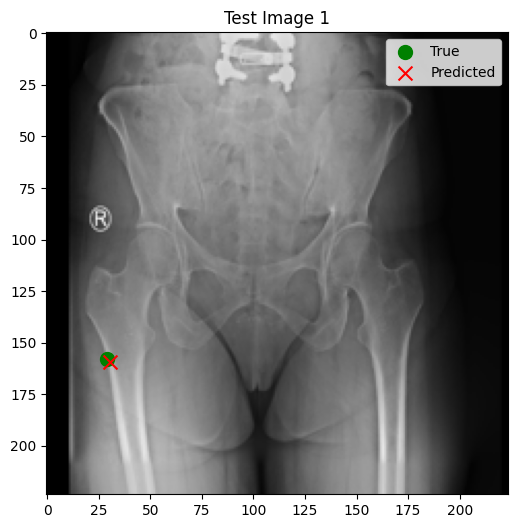

-1.3462837880452483 2.769503987630202


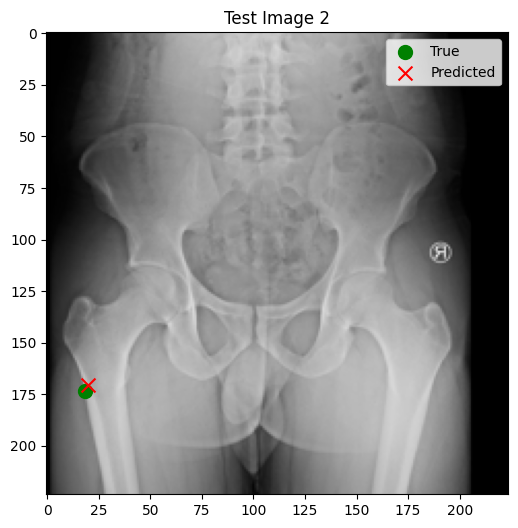

0.2576401875813801 0.9477345377604252


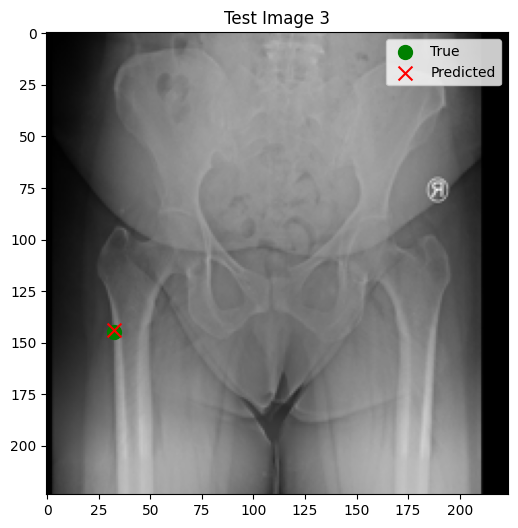

-1.0828819615071623 3.903422376953131


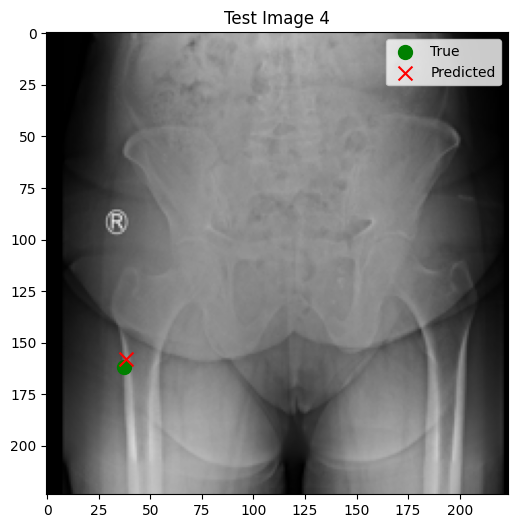

0.0860784098307299 -1.2850146347656164


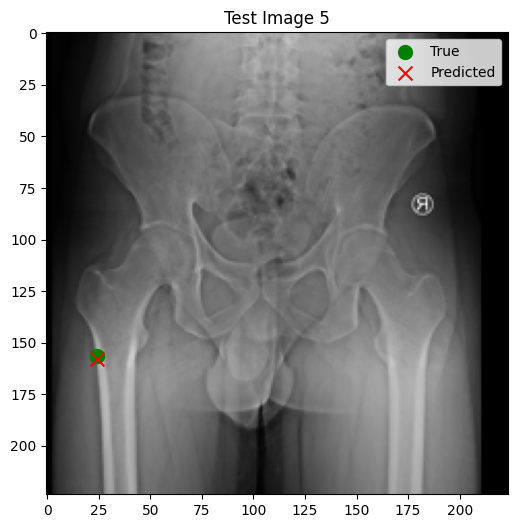

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LShaftLat_10.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 86ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LShaftLat_9.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 86ms/step
Maximum error in x direction: 4.603604842183431
Maximum error in y direction: 12.367456610677095


#Part 2_Landmark_10(LShaftLat)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_tenth700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LShaftLat-x", "LShaftLat-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LShaftLat-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LShaftLat-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details10.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 25ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped10.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped10.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped10.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped10.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped10.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped10.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped10.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped10.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped10.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped10.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped10.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped10.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_tenth_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 126.7109 - mae: 88.9901 - euclidean_distance: 126.7109

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 26s 435ms/step - loss: 126.4072 - mae: 88.7735 - euclidean_distance: 126.4072 - val_loss: 235.3685 - val_mae: 160.6193 - val_euclidean_distance: 235.3685
Epoch 2/400
37/37 [==============================] - 5s 141ms/step - loss: 36.6010 - mae: 23.9009 - euclidean_distance: 36.6010 - val_loss: 37.2896 - val_mae: 24.2861 - val_euclidean_distance: 37.2896
Epoch 3/400
37/37 [==============================] - 5s 136ms/step - loss: 21.2895 - mae: 13.7568 - euclidean_distance: 21.2895 - val_loss: 30.9244 - val_mae: 19.6352 - val_euclidean_distance: 30.9244
Epoch 4/400
37/37 [==============================] - 3s 86ms/step - loss: 20.6717 - mae: 13.2383 - euclidean_distance: 20.6717 - val_loss: 45.2196 - val_mae: 29.8525 - val_euclidean_distance: 45.2196
Epoch 5/400
37/37 [==============================] - 3s 88ms/step - loss: 20.6522 - mae: 13.3186 - euclidean_distance: 20.6522 - val_loss: 32.1048 - val_mae: 20.5569 - val_euclidean_distance: 32.1048
Epo

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 93ms/step - loss: 12.4856 - mae: 7.4200 - euclidean_distance: 12.4856
Test Loss: 12.485614776611328, Test MAE: 7.419981002807617, Test Euclidean Distance: 2.4971229553222654 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LShaftLat-x', 'LShaftLat-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details10.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LShaftLat10.csv', index=False)


4/4 [==============================] - 2s 104ms/step


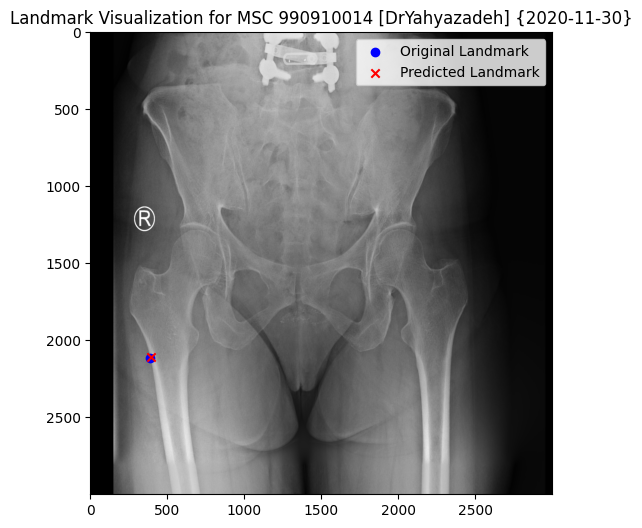

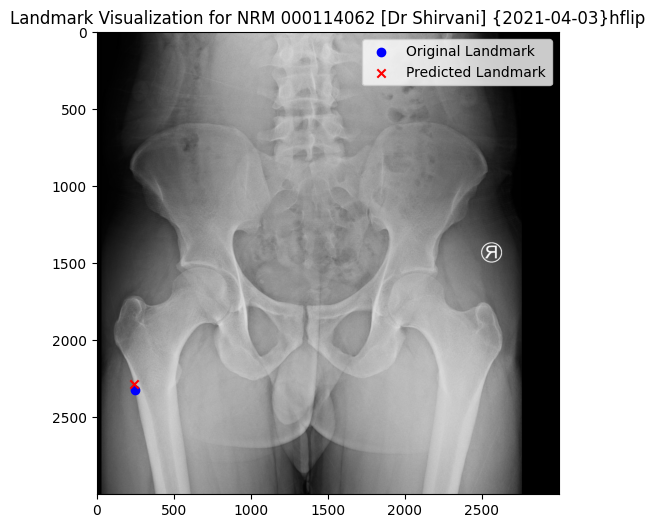

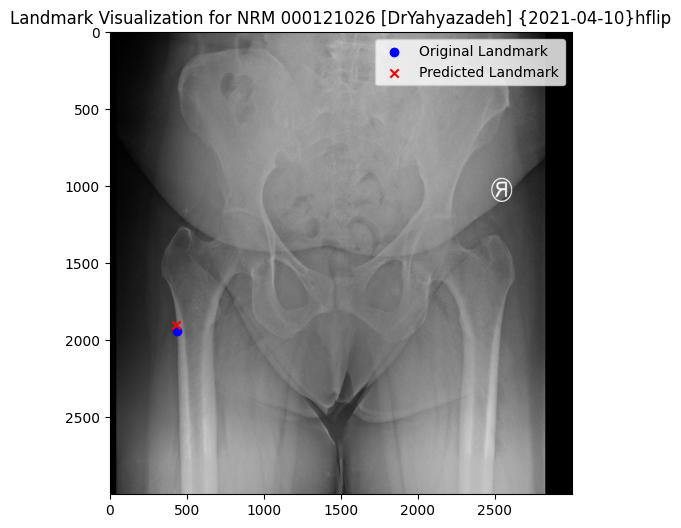

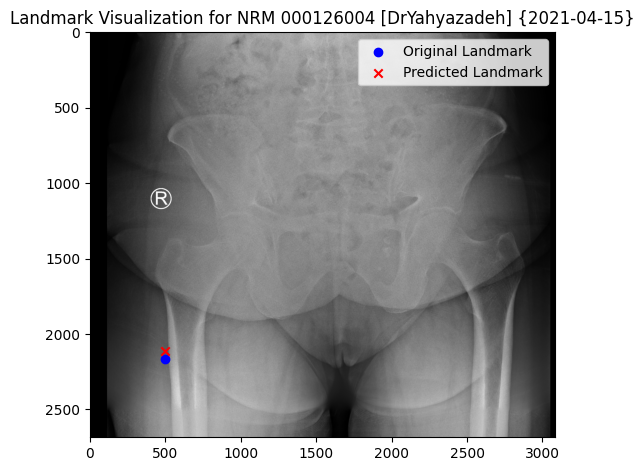

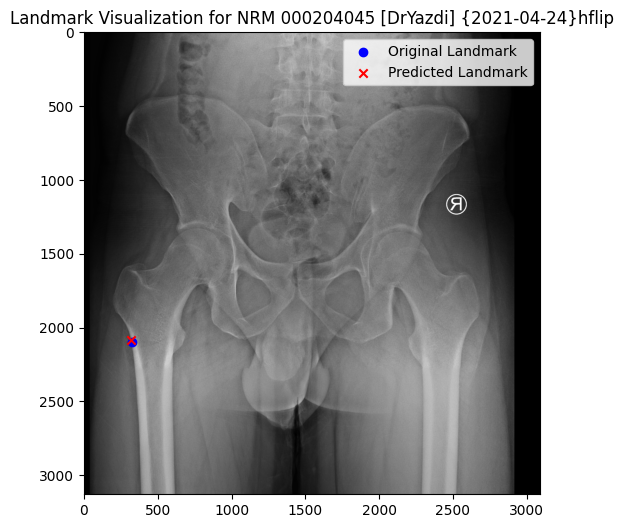

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LShaftLat10.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark11(LShaftMed)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 20:22]
val_landmarks_first = val_landmarks[:, 20:22]
test_landmarks_first = test_landmarks[:, 20:22]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_5 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_5[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_eleventh700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 12765.5020 - mae: 99.4510

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 51s 1s/step - loss: 12765.5020 - mae: 99.4510 - val_loss: 10179.7881 - val_mae: 88.2915
Epoch 2/400
19/19 [==============================] - 10s 533ms/step - loss: 9574.3398 - mae: 86.4959 - val_loss: 505.8216 - val_mae: 19.1035
Epoch 3/400
19/19 [==============================] - 7s 343ms/step - loss: 4431.1143 - mae: 59.6962 - val_loss: 5961.2222 - val_mae: 58.2168
Epoch 4/400
19/19 [==============================] - 7s 345ms/step - loss: 1070.8778 - mae: 25.9578 - val_loss: 4165.9937 - val_mae: 56.2089
Epoch 5/400
19/19 [==============================] - 14s 759ms/step - loss: 513.8609 - mae: 17.6338 - val_loss: 481.3719 - val_mae: 17.5649
Epoch 6/400
19/19 [==============================] - 9s 459ms/step - loss: 493.5697 - mae: 17.4830 - val_loss: 139.0186 - val_mae: 8.2641
Epoch 7/400
19/19 [==============================] - 6s 341ms/step - loss: 427.7560 - mae: 15.9862 - val_loss: 584.6453 - val_mae: 18.1384
Epoch 8/400
19/19 [============

4/4 [==============================] - 0s 95ms/step - loss: 12.4562 - mae: 2.5425
Test Loss: 12.456158638000488
Test MAE: 2.542510986328125
4/4 [==============================] - 1s 85ms/step
-1.4665905965169301 2.7120729573567814


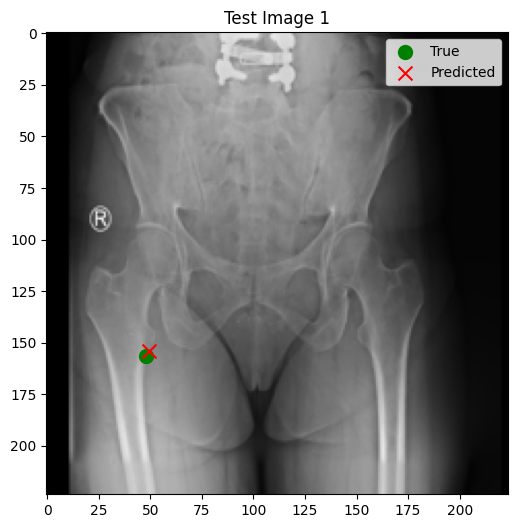

-5.275862416585284 0.4081700032552078


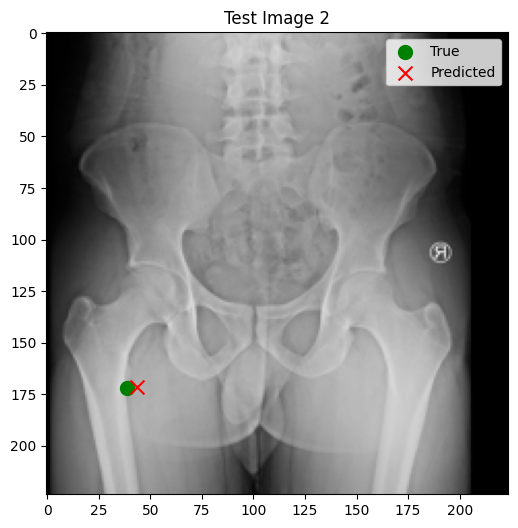

0.40810068766275975 2.338065185546867


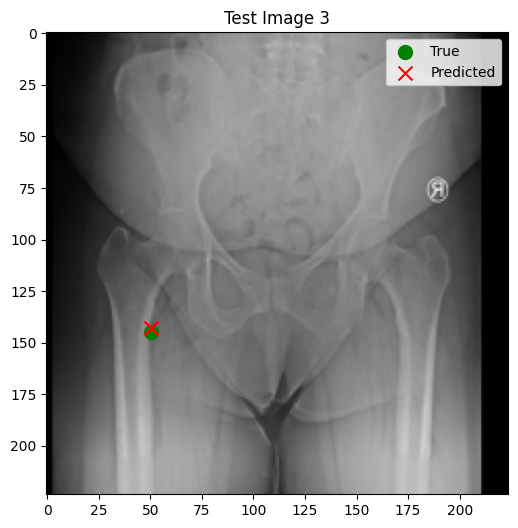

0.8213492533365852 7.108546346028646


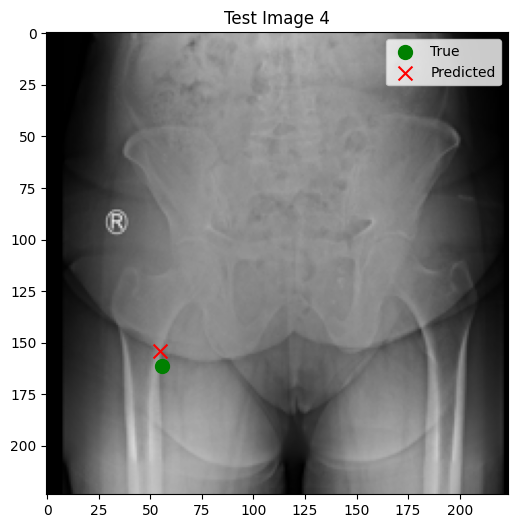

-2.987281192464195 1.4902973496093637


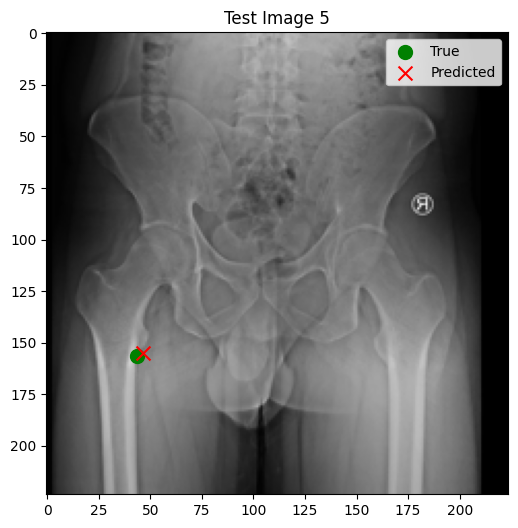

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LShaftMed_11.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 85ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LShaftMed_11.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 85ms/step
Maximum error in x direction: 9.66649853515625
Maximum error in y direction: 14.997769151367208


#Part 2_Landmark_11(LShaftMed)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_eleventh700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LShaftMed-x", "LShaftMed-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LShaftMed-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LShaftMed-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details11.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 31ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped11.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped11.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped11.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped11.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped11.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped11.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped11.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped11.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped11.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped11.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped11.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped11.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_6"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_7 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_7[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_eleventh_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
37/37 [==============================] - 20s 279ms/step - loss: 143.0028 - mae: 99.9543 - euclidean_distance: 143.0028 - val_loss: 211.1981 - val_mae: 148.2581 - val_euclidean_distance: 211.1981
Epoch 2/400
37/37 [==============================] - 5s 141ms/step - loss: 48.0177 - mae: 31.9723 - euclidean_distance: 48.0177 - val_loss: 52.4457 - val_mae: 34.9373 - val_euclidean_distance: 52.4457
Epoch 3/400
37/37 [==============================] - 5s 126ms/step - loss: 24.3824 - mae: 15.3906 - euclidean_distance: 24.3824 - val_loss: 42.6682 - val_mae: 27.2685 - val_euclidean_distance: 42.6682
Epoch 4/400
37/37 [==============================] - 5s 133ms/step - loss: 22.3217 - mae: 14.3281 - euclidean_distance: 22.3217 - val_loss: 40.7817 - val_mae: 25.9058 - val_euclidean_distance: 40.7817
Epoch 5/400
37/37 [==============================] - 3s 94ms/step - loss: 22.1851 - mae: 14.0742 - euclidean_distance: 22.1851 - val_loss: 49.4384 - val_mae: 31.9943 - val_euclidean_distance

##result


In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 97ms/step - loss: 8.7786 - mae: 5.1725 - euclidean_distance: 8.7786
Test Loss: 8.77855110168457, Test MAE: 5.172511100769043, Test Euclidean Distance: 1.7557102203369137 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LShaftMed-x', 'LShaftMed-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details11.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LShaftMed11.csv', index=False)


4/4 [==============================] - 0s 104ms/step


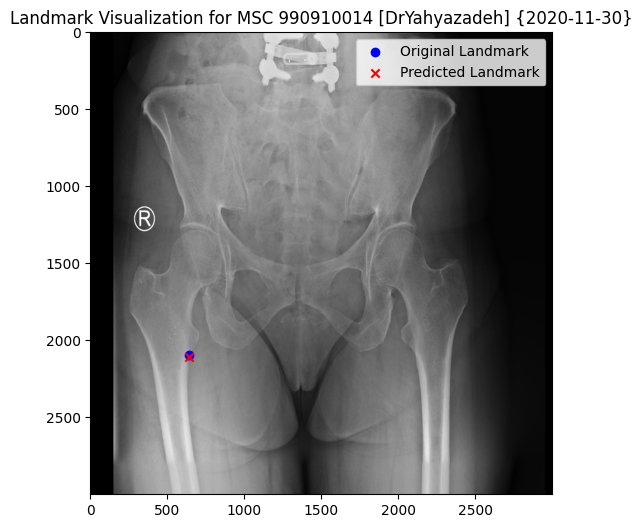

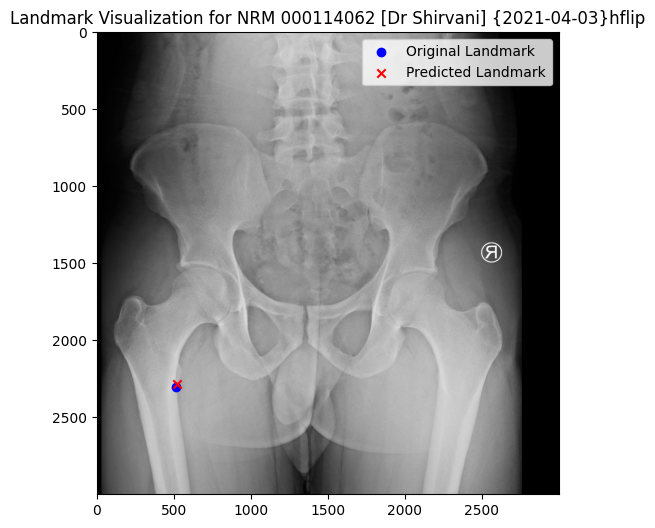

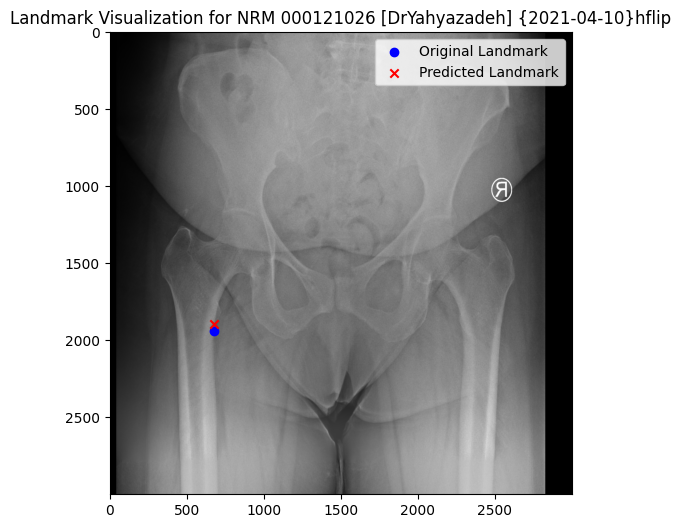

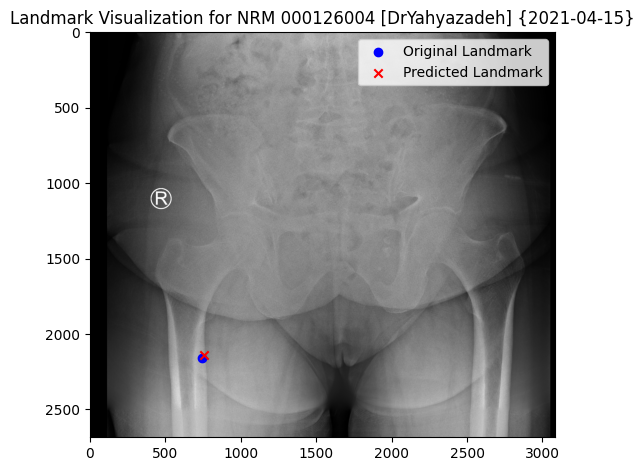

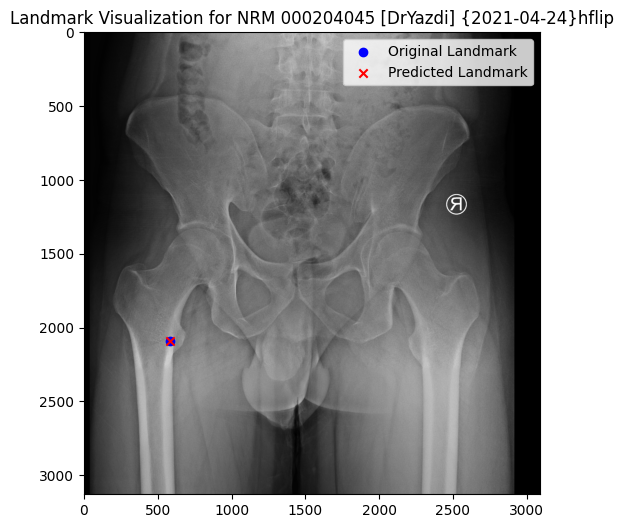

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LShaftMed11.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark12(LLesser)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 22:24]
val_landmarks_first = val_landmarks[:, 22:24]
test_landmarks_first = test_landmarks[:, 22:24]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 5s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_12th700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 11157.9092 - mae: 95.2942

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 61s 1s/step - loss: 11157.9092 - mae: 95.2942 - val_loss: 6488.6343 - val_mae: 71.6264
Epoch 2/400
19/19 [==============================] - 8s 424ms/step - loss: 5702.2871 - mae: 65.5885 - val_loss: 3539.7136 - val_mae: 55.3467
Epoch 3/400
19/19 [==============================] - 6s 318ms/step - loss: 775.3293 - mae: 20.7339 - val_loss: 12330.4482 - val_mae: 103.5474
Epoch 4/400
19/19 [==============================] - 8s 433ms/step - loss: 330.6432 - mae: 14.3128 - val_loss: 1889.9352 - val_mae: 38.3928
Epoch 5/400
19/19 [==============================] - 8s 445ms/step - loss: 250.3180 - mae: 12.2710 - val_loss: 146.8922 - val_mae: 9.2500
Epoch 6/400
19/19 [==============================] - 6s 325ms/step - loss: 247.6248 - mae: 12.3568 - val_loss: 274.5136 - val_mae: 13.3939
Epoch 7/400
19/19 [==============================] - 6s 329ms/step - loss: 243.0233 - mae: 11.9537 - val_loss: 309.7535 - val_mae: 14.7363
Epoch 8/400
19/19 [==============

4/4 [==============================] - 2s 742ms/step - loss: 9.2706 - mae: 2.3080
Test Loss: 9.27060604095459
Test MAE: 2.308011293411255
4/4 [==============================] - 2s 89ms/step
1.0471790568033867 0.5679313964843686


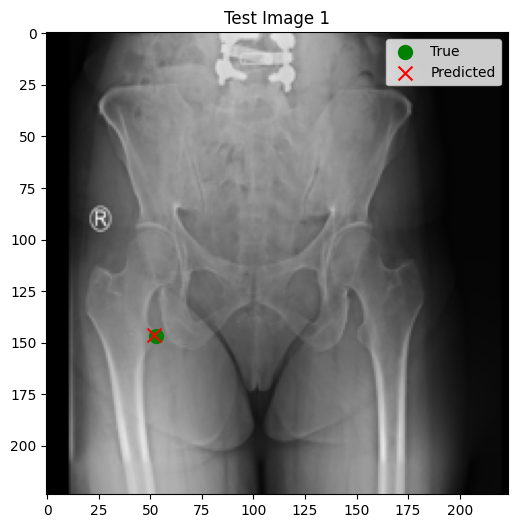

-1.747808858235679 -0.3570053304036378


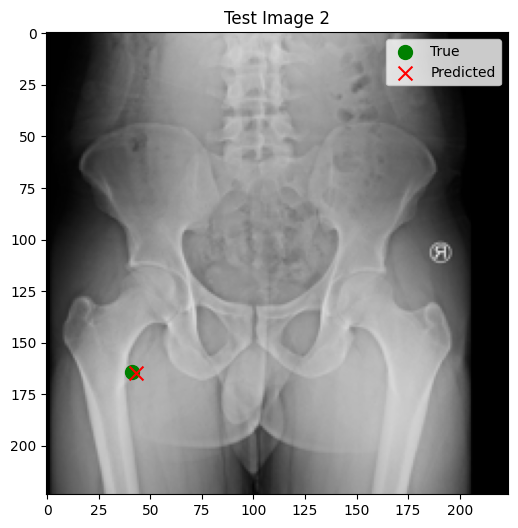

1.0371000976562499 1.0629593912760527


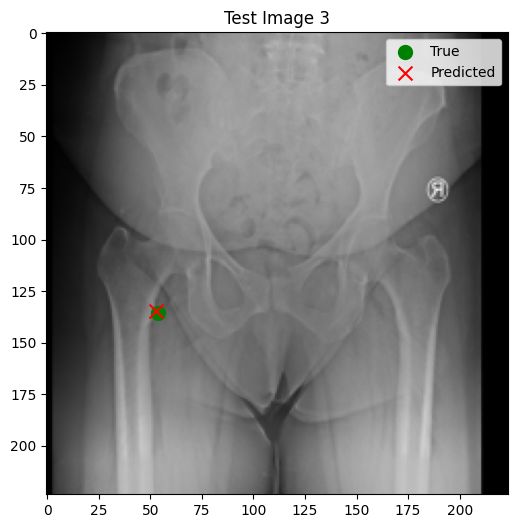

2.366258280436199 6.878243204752607


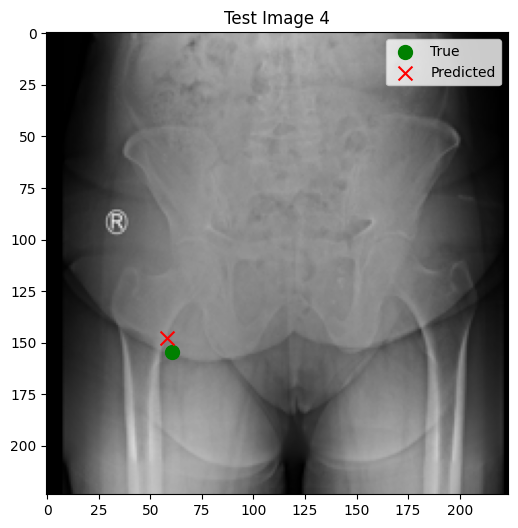

-0.23811737060546534 1.756424194335949


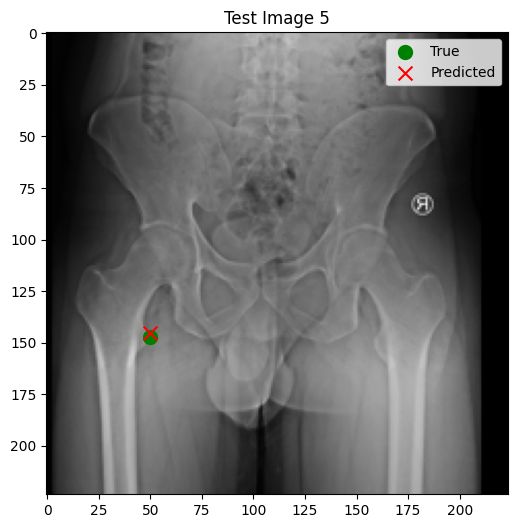

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LLesser_12.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 86ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LLesser_12.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 87ms/step
Maximum error in x direction: 7.7903256937662775
Maximum error in y direction: 11.130845947265612


#Part 2_Landmark_12(LLesser)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_12th700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LLesser-x", "LLesser-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LLesser-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LLesser-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details12.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 24ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped12.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped12.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped12.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped12.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped12.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped12.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped12.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped12.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped12.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped12.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped12.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped12.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_12th_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 142.0878 - mae: 100.1325 - euclidean_distance: 142.0878

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 52s 1s/step - loss: 141.7876 - mae: 99.9111 - euclidean_distance: 141.7876 - val_loss: 250.7226 - val_mae: 176.1643 - val_euclidean_distance: 250.7226
Epoch 2/400
37/37 [==============================] - 5s 143ms/step - loss: 40.2494 - mae: 27.2630 - euclidean_distance: 40.2494 - val_loss: 32.5569 - val_mae: 20.8893 - val_euclidean_distance: 32.5569
Epoch 3/400
37/37 [==============================] - 3s 90ms/step - loss: 21.5194 - mae: 13.9278 - euclidean_distance: 21.5194 - val_loss: 41.6689 - val_mae: 26.9392 - val_euclidean_distance: 41.6689
Epoch 4/400
37/37 [==============================] - 3s 89ms/step - loss: 20.3466 - mae: 13.0576 - euclidean_distance: 20.3466 - val_loss: 53.4608 - val_mae: 35.6584 - val_euclidean_distance: 53.4608
Epoch 5/400
37/37 [==============================] - 3s 90ms/step - loss: 20.5283 - mae: 13.2947 - euclidean_distance: 20.5283 - val_loss: 35.8526 - val_mae: 22.8357 - val_euclidean_distance: 35.8526
Epoch 6

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 92ms/step - loss: 11.9937 - mae: 7.4468 - euclidean_distance: 11.9937
Test Loss: 11.993727684020996, Test MAE: 7.446825981140137, Test Euclidean Distance: 2.398745536804199 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LLesser-x', 'LLesser-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details12.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LLesser12.csv', index=False)


4/4 [==============================] - 1s 104ms/step


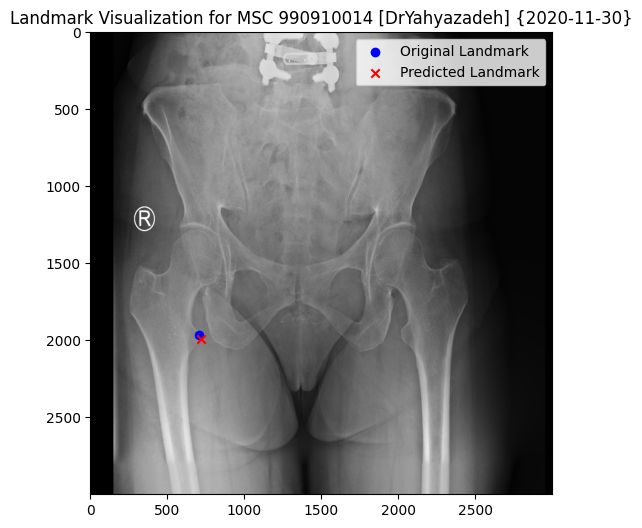

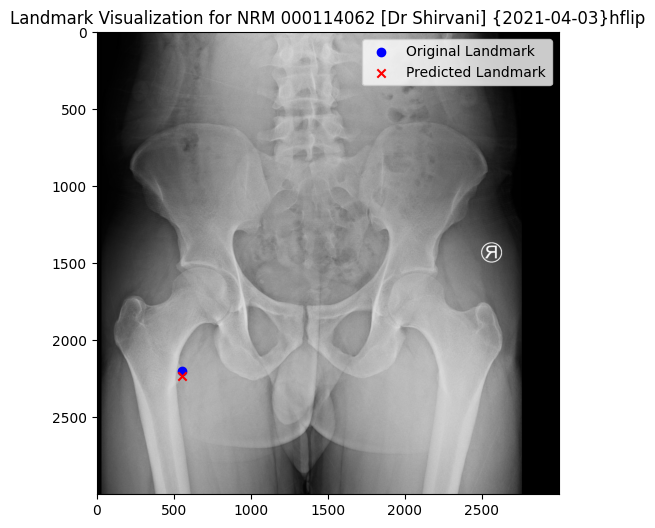

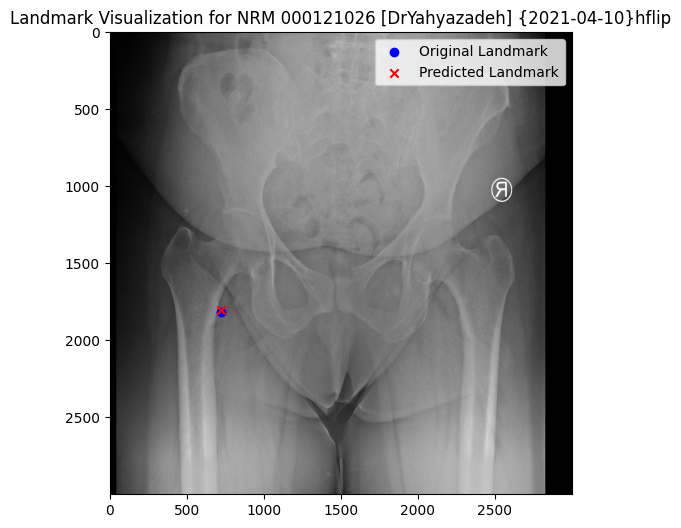

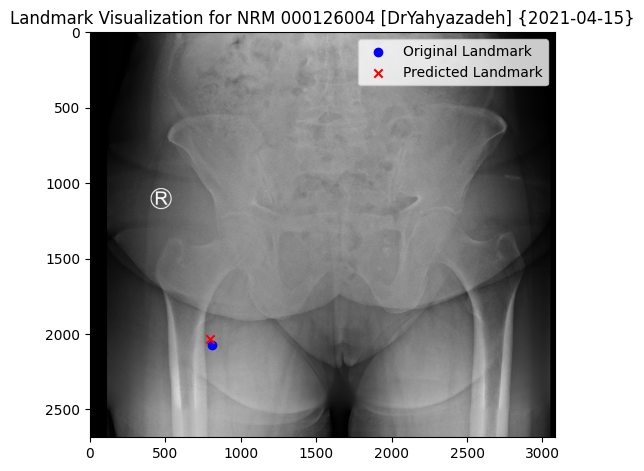

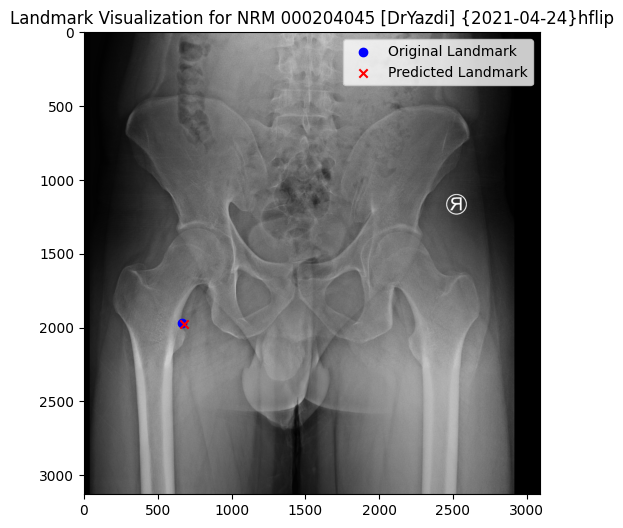

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LLesser12.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark13(RLesser)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 24:26]
val_landmarks_first = val_landmarks[:, 24:26]
test_landmarks_first = test_landmarks[:, 24:26]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 5s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_13th700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 24022.6426 - mae: 153.7681

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 60s 857ms/step - loss: 24022.6426 - mae: 153.7681 - val_loss: 20195.2070 - val_mae: 140.1628
Epoch 2/400
19/19 [==============================] - 6s 302ms/step - loss: 18126.1621 - mae: 131.9447 - val_loss: 76772.0859 - val_mae: 236.7738
Epoch 3/400
19/19 [==============================] - 6s 306ms/step - loss: 8625.7549 - mae: 85.7626 - val_loss: 246572.7344 - val_mae: 485.1528
Epoch 4/400
19/19 [==============================] - 6s 304ms/step - loss: 2163.6646 - mae: 37.7911 - val_loss: 173258.4531 - val_mae: 412.4858
Epoch 5/400
19/19 [==============================] - 13s 710ms/step - loss: 773.0579 - mae: 21.9090 - val_loss: 11093.2617 - val_mae: 103.2083
Epoch 6/400
19/19 [==============================] - 8s 425ms/step - loss: 679.5967 - mae: 20.8297 - val_loss: 270.2737 - val_mae: 12.8651
Epoch 7/400
19/19 [==============================] - 6s 307ms/step - loss: 678.4367 - mae: 20.4928 - val_loss: 482.8491 - val_mae: 19.6668
Epoch 8/400


4/4 [==============================] - 2s 712ms/step - loss: 13.2617 - mae: 2.8949
Test Loss: 13.261667251586914
Test MAE: 2.8949148654937744
4/4 [==============================] - 1s 84ms/step
-0.4972257486979288 -0.5902294108072965


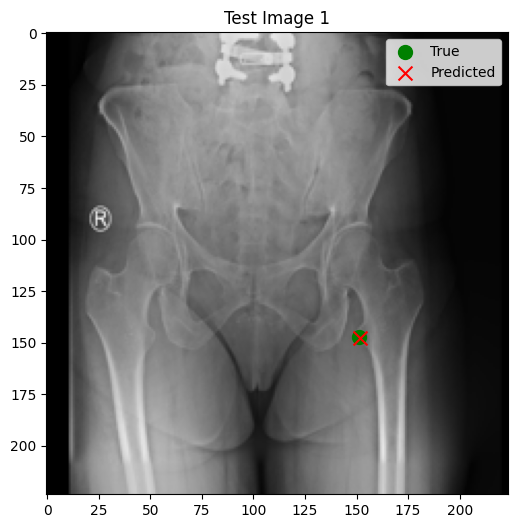

3.6722009684244767 5.730773437500005


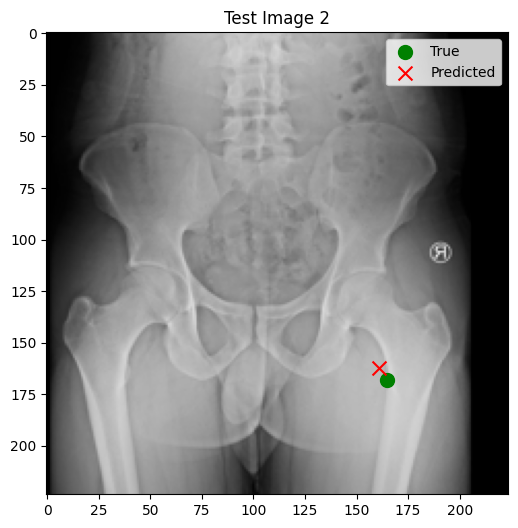

2.921102172851562 0.3627127278645901


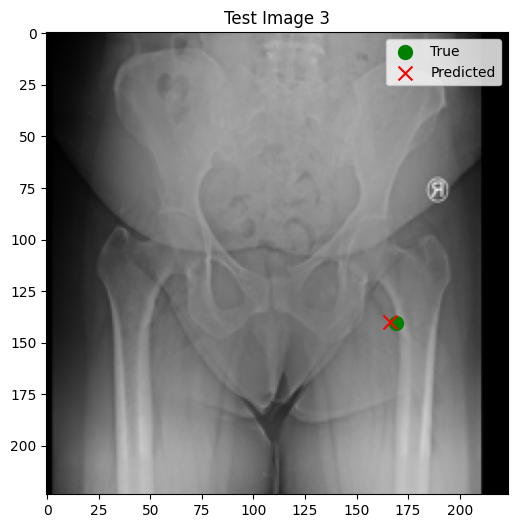

6.140796834309896 2.720337524414049


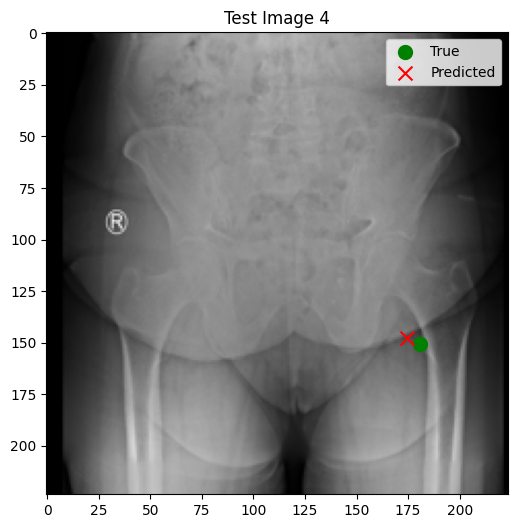

-1.0697569580078152 1.0805370279947795


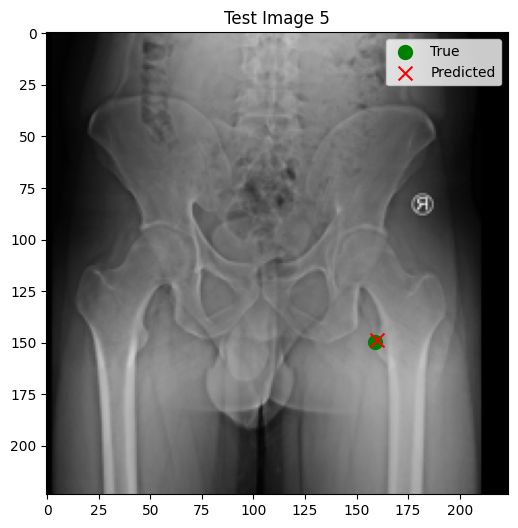

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LLesser_12.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 88ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LLesser_12.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 85ms/step
Maximum error in x direction: 11.942719848632805
Maximum error in y direction: 8.133740722656256


#Part 2_Landmark_13(RLesser)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_13th700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "RLesser-x", "RLesser-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['RLesser-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['RLesser-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details13.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 21ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped13.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped13.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped13.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped13.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped13.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped13.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped13.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped13.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped13.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped13.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped13.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped13.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_13th_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
37/37 [==============================] - 19s 255ms/step - loss: 165.5697 - mae: 116.4018 - euclidean_distance: 165.5697 - val_loss: 79.6868 - val_mae: 52.4210 - val_euclidean_distance: 79.6868
Epoch 2/400
37/37 [==============================] - 3s 92ms/step - loss: 92.9894 - mae: 63.9991 - euclidean_distance: 92.9894 - val_loss: 102.0504 - val_mae: 69.1525 - val_euclidean_distance: 102.0504
Epoch 3/400
37/37 [==============================] - 5s 129ms/step - loss: 32.1292 - mae: 20.5621 - euclidean_distance: 32.1292 - val_loss: 32.6916 - val_mae: 20.9564 - val_euclidean_distance: 32.6916
Epoch 4/400
37/37 [==============================] - 4s 95ms/step - loss: 29.7450 - mae: 19.0489 - euclidean_distance: 29.7450 - val_loss: 47.2084 - val_mae: 30.9901 - val_euclidean_distance: 47.2084
Epoch 5/400
37/37 [==============================] - 3s 88ms/step - loss: 27.9377 - mae: 17.9339 - euclidean_distance: 27.9377 - val_loss: 41.6400 - val_mae: 27.0327 - val_euclidean_distance: 

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 93ms/step - loss: 11.5756 - mae: 7.0948 - euclidean_distance: 11.5756
Test Loss: 11.575594902038574, Test MAE: 7.0947723388671875, Test Euclidean Distance: 2.3151189804077146 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['RLesser-x', 'RLesser-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details13.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_RLesser13.csv', index=False)


4/4 [==============================] - 2s 106ms/step


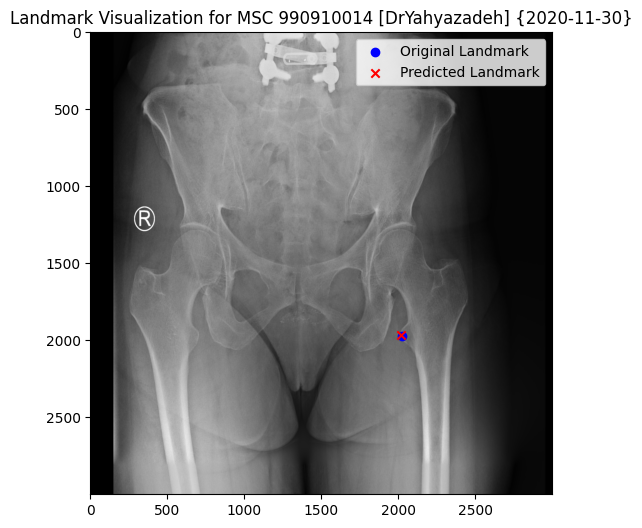

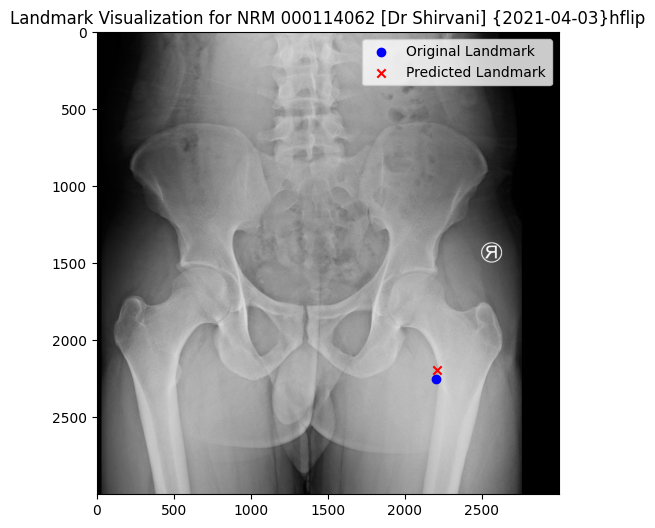

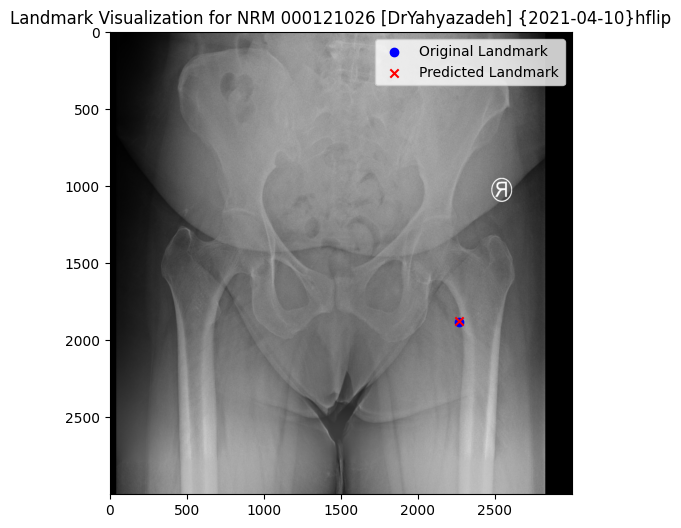

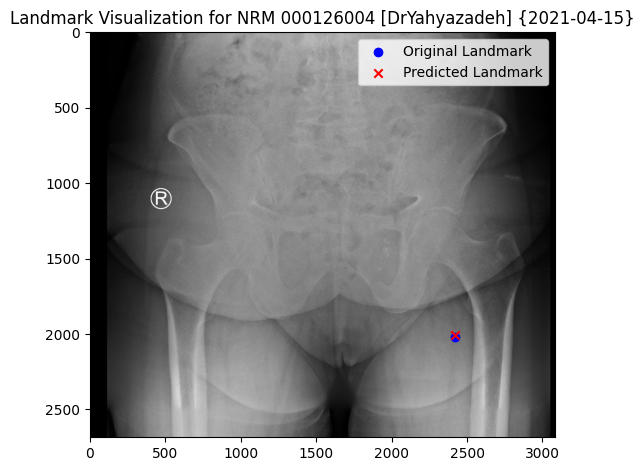

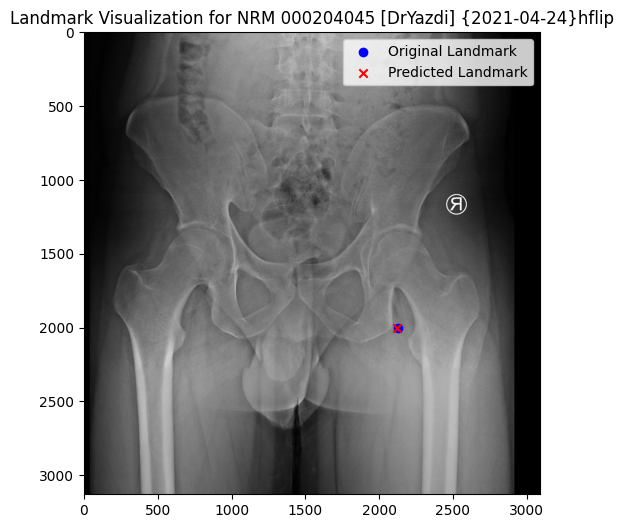

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_RLesser13.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark14(LGreater)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 26:28]
val_landmarks_first = val_landmarks[:, 26:28]
test_landmarks_first = test_landmarks[:, 26:28]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_14th700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 5347.7480 - mae: 63.2371

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 46s 869ms/step - loss: 5347.7480 - mae: 63.2371 - val_loss: 1736.0841 - val_mae: 36.7049
Epoch 2/400
19/19 [==============================] - 6s 312ms/step - loss: 1365.8027 - mae: 30.9721 - val_loss: 1979.9292 - val_mae: 33.9088
Epoch 3/400
19/19 [==============================] - 8s 455ms/step - loss: 256.8419 - mae: 12.7375 - val_loss: 458.8723 - val_mae: 17.8293
Epoch 4/400
19/19 [==============================] - 8s 433ms/step - loss: 208.5776 - mae: 11.0410 - val_loss: 195.7357 - val_mae: 11.6050
Epoch 5/400
19/19 [==============================] - 8s 432ms/step - loss: 186.9473 - mae: 10.5814 - val_loss: 99.6180 - val_mae: 7.5059
Epoch 6/400
19/19 [==============================] - 6s 325ms/step - loss: 165.5952 - mae: 9.9801 - val_loss: 141.3044 - val_mae: 9.8379
Epoch 7/400
19/19 [==============================] - 8s 438ms/step - loss: 151.7428 - mae: 9.4226 - val_loss: 86.3961 - val_mae: 7.3660
Epoch 8/400
19/19 [======================

4/4 [==============================] - 0s 92ms/step - loss: 3.9535 - mae: 1.5873
Test Loss: 3.9534671306610107
Test MAE: 1.5872713327407837
4/4 [==============================] - 2s 87ms/step
-1.8837908935546892 0.8774925537109368


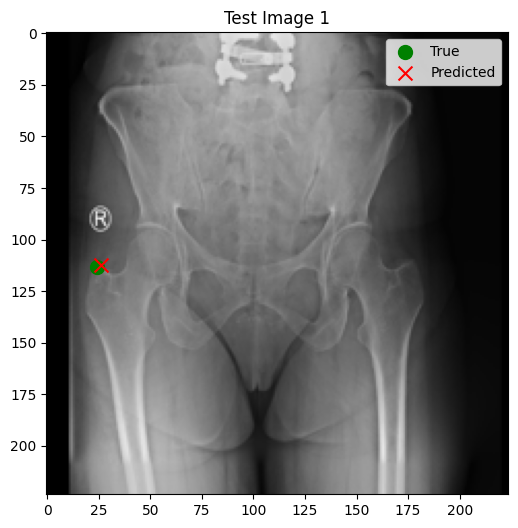

-2.205125223795573 0.5721383260091102


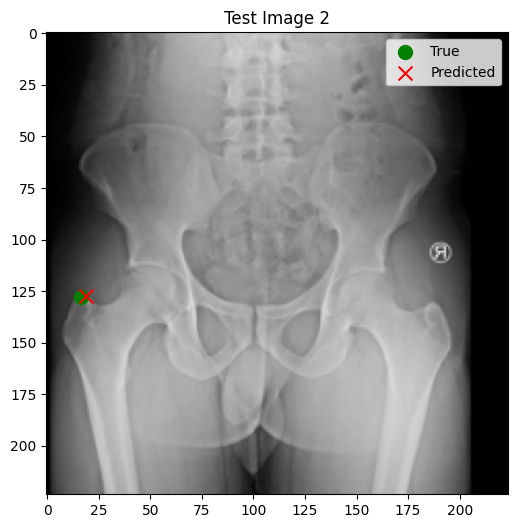

0.5655478312174509 -2.7755607910156215


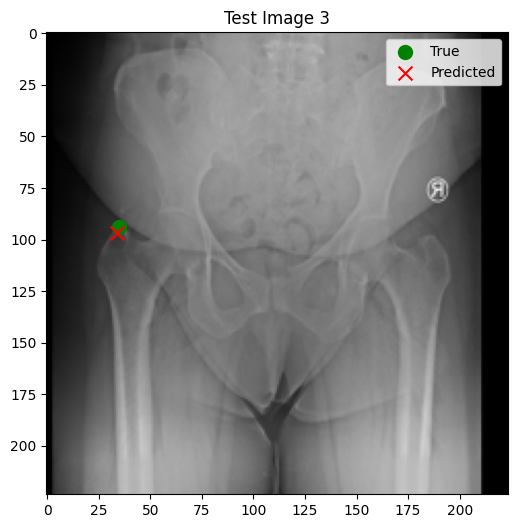

-0.8337335001627579 1.097277669270838


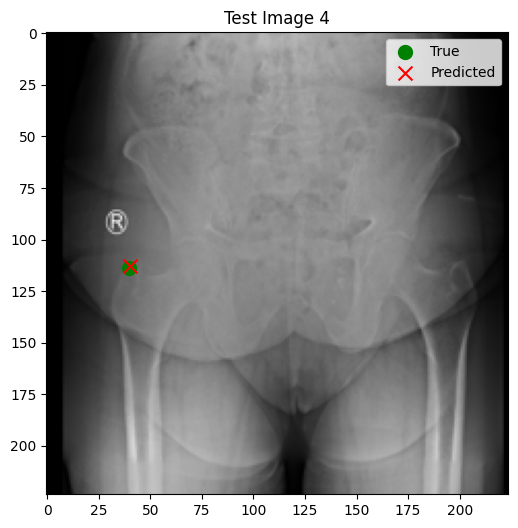

3.9776294148763007 -1.1557732950846287


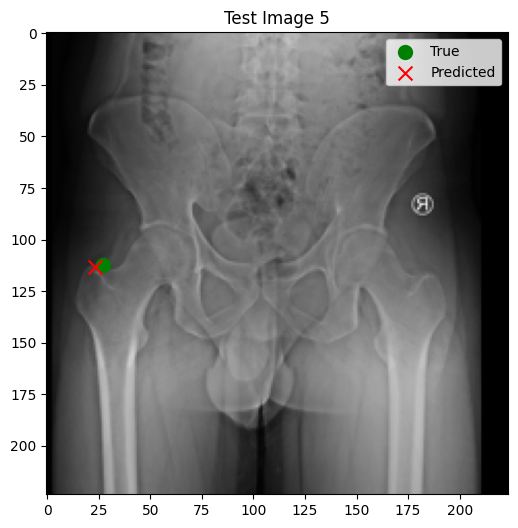

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LGreater_14.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 85ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LGreater_14.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 85ms/step
Maximum error in x direction: 5.614455301920573
Maximum error in y direction: 6.086075520833333


#Part 2_Landmark_14(LGreater)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_14th700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LGreater-x", "LGreater-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LGreater-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LGreater-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details14.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 29ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped14.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped14.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped14.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped14.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped14.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped14.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped14.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped14.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped14.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped14.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped14.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped14.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_14th_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 145.2786 - mae: 102.0938 - euclidean_distance: 145.2786

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 39s 794ms/step - loss: 145.0966 - mae: 101.9612 - euclidean_distance: 145.0966 - val_loss: 188.9583 - val_mae: 103.1417 - val_euclidean_distance: 188.9583
Epoch 2/400
37/37 [==============================] - 5s 132ms/step - loss: 75.3788 - mae: 48.5886 - euclidean_distance: 75.3788 - val_loss: 122.6447 - val_mae: 73.8864 - val_euclidean_distance: 122.6447
Epoch 3/400
37/37 [==============================] - 4s 120ms/step - loss: 31.2168 - mae: 20.0129 - euclidean_distance: 31.2168 - val_loss: 20.4453 - val_mae: 13.0328 - val_euclidean_distance: 20.4453
Epoch 4/400
37/37 [==============================] - 3s 83ms/step - loss: 19.8579 - mae: 13.0266 - euclidean_distance: 19.8579 - val_loss: 37.7658 - val_mae: 24.6243 - val_euclidean_distance: 37.7658
Epoch 5/400
37/37 [==============================] - 3s 86ms/step - loss: 18.9438 - mae: 12.4225 - euclidean_distance: 18.9438 - val_loss: 27.7088 - val_mae: 17.6389 - val_euclidean_distance: 27.7088


##Result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*crop_size/10}",'mm')


4/4 [==============================] - 0s 91ms/step - loss: 9.1289 - mae: 5.5818 - euclidean_distance: 9.1289
Test Loss: 9.128890991210938, Test MAE: 5.581814765930176, Test Euclidean Distance: 1.8257781982421875 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LGreater-x', 'LGreater-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details14.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LGreater14.csv', index=False)


4/4 [==============================] - 1s 86ms/step


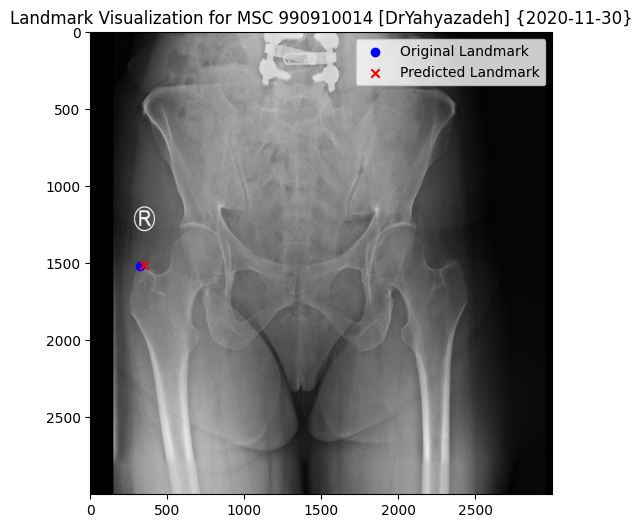

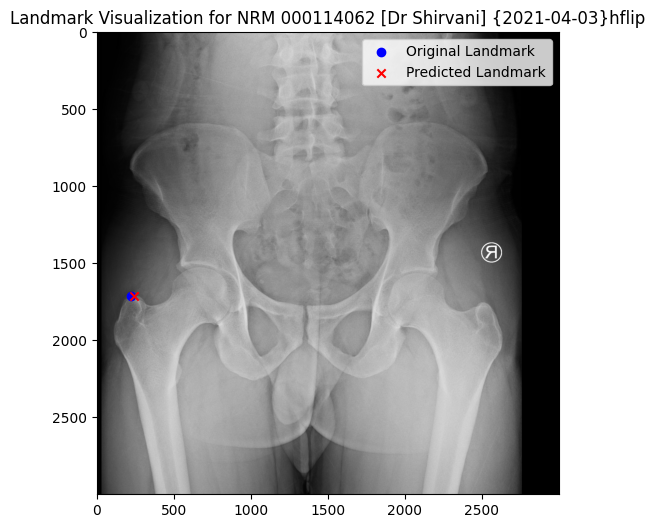

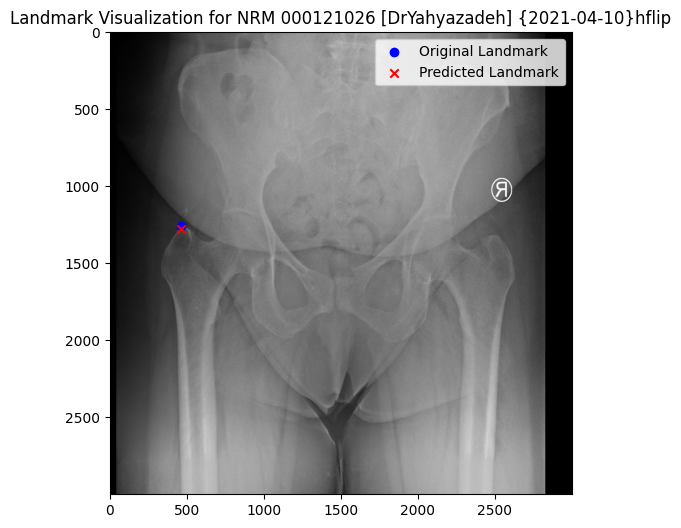

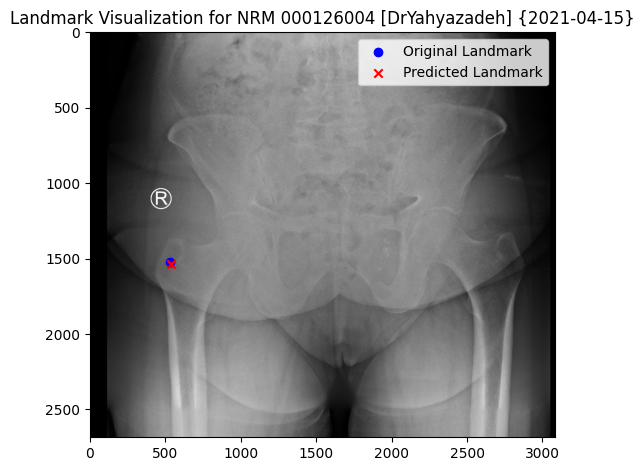

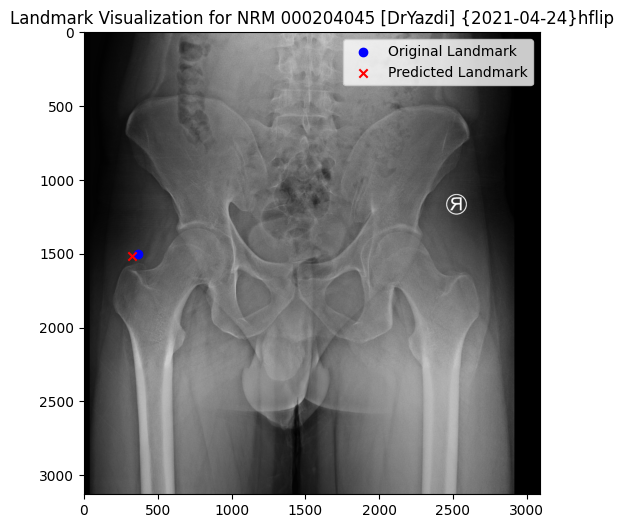

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LGreater14.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()


#Landmark15(LIschium)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 28:30]
val_landmarks_first = val_landmarks[:, 28:30]
test_landmarks_first = test_landmarks[:, 28:30]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


94765736/94765736 [==============================] - 5s 0us/step
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_1[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                         

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_15th700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 15165.6875 - mae: 117.2030

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 60s 979ms/step - loss: 15165.6875 - mae: 117.2030 - val_loss: 13412.3369 - val_mae: 109.9208
Epoch 2/400
19/19 [==============================] - 8s 444ms/step - loss: 11923.5225 - mae: 102.8547 - val_loss: 1171.3580 - val_mae: 25.6314
Epoch 3/400
19/19 [==============================] - 6s 332ms/step - loss: 5674.2788 - mae: 67.3009 - val_loss: 50899.1055 - val_mae: 224.1156
Epoch 4/400
19/19 [==============================] - 7s 345ms/step - loss: 1305.7800 - mae: 28.9223 - val_loss: 23643.9922 - val_mae: 152.0182
Epoch 5/400
19/19 [==============================] - 6s 338ms/step - loss: 470.6766 - mae: 17.3641 - val_loss: 1719.0656 - val_mae: 38.1264
Epoch 6/400
19/19 [==============================] - 12s 672ms/step - loss: 387.4135 - mae: 14.9833 - val_loss: 188.9329 - val_mae: 11.5075
Epoch 7/400
19/19 [==============================] - 8s 422ms/step - loss: 355.2951 - mae: 15.0590 - val_loss: 121.5762 - val_mae: 8.8337
Epoch 8/400
19/19 [

4/4 [==============================] - 2s 733ms/step - loss: 6.8756 - mae: 2.0623
Test Loss: 6.875552654266357
Test MAE: 2.0622596740722656
4/4 [==============================] - 1s 86ms/step
1.3831368408203133 1.0323712565104302


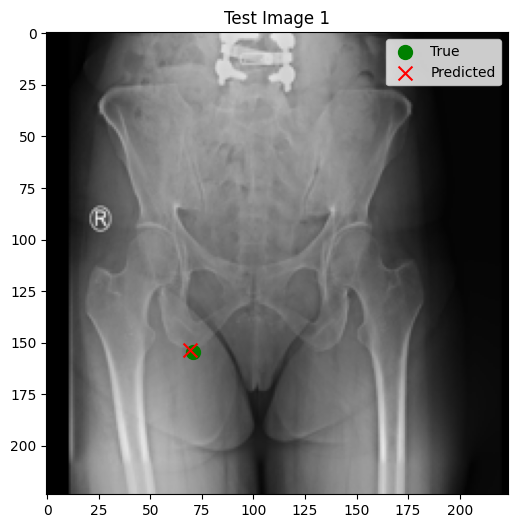

-0.3132998250325585 -0.24489278157551553


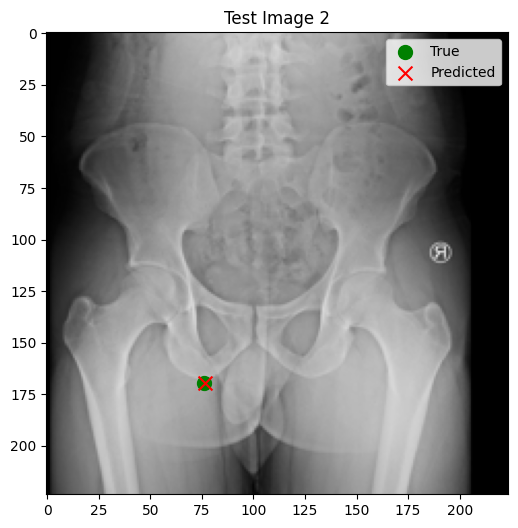

2.283261901855468 -0.3934595133463574


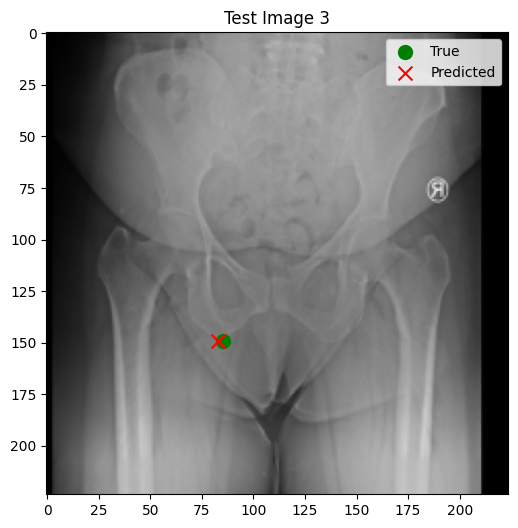

5.546450927734369 1.6609460856119824


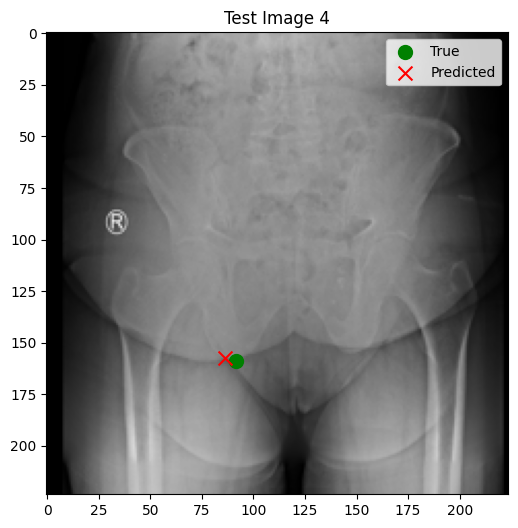

2.961416137695309 -1.3817855631510554


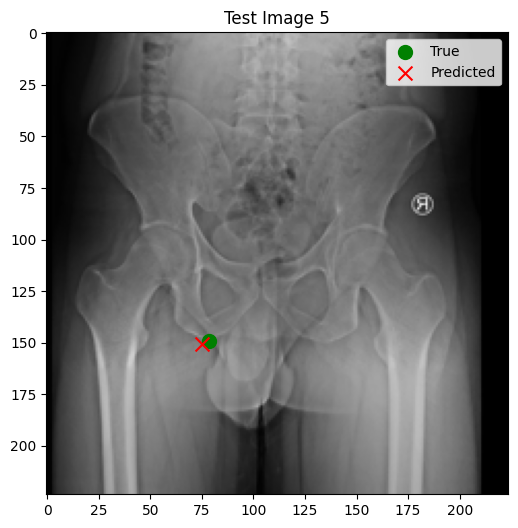

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_LIschium_15.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


4/4 [==============================] - 0s 87ms/step
CSV file saved to /content/drive/MyDrive/Hip2/csv/Part1_LIschium_15.csv


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


4/4 [==============================] - 0s 88ms/step
Maximum error in x direction: 6.309094706217451
Maximum error in y direction: 7.393650065104168


#Part 2_Landmark_15(LIschium)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_15th700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "LIschium-x", "LIschium-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['LIschium-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['LIschium-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details15.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


1/1 [==============================] - 0s 28ms/step
Processed 853 high-quality images.


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped15.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped15.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped15.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped15.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped15.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped15.npy', test_landmarks)


Training set: 580 images
Validation set: 146 images
Test set: 127 images


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped15.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped15.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped15.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped15.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped15.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped15.npy')

print("Datasets loaded successfully.")

Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_3 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_3[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_15th_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


Epoch 1/400
36/37 [============================>.] - ETA: 0s - loss: 153.3990 - mae: 107.9628 - euclidean_distance: 153.3990

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


37/37 [==============================] - 16s 170ms/step - loss: 153.1435 - mae: 107.7849 - euclidean_distance: 153.1435 - val_loss: 51.4722 - val_mae: 32.1189 - val_euclidean_distance: 51.4722
Epoch 2/400
37/37 [==============================] - 3s 84ms/step - loss: 82.8689 - mae: 56.8898 - euclidean_distance: 82.8689 - val_loss: 76.8796 - val_mae: 53.0970 - val_euclidean_distance: 76.8796
Epoch 3/400
37/37 [==============================] - 5s 126ms/step - loss: 25.1037 - mae: 15.8846 - euclidean_distance: 25.1037 - val_loss: 40.6200 - val_mae: 27.2173 - val_euclidean_distance: 40.6200
Epoch 4/400
37/37 [==============================] - 3s 93ms/step - loss: 23.3161 - mae: 14.8281 - euclidean_distance: 23.3161 - val_loss: 45.5421 - val_mae: 30.6488 - val_euclidean_distance: 45.5421
Epoch 5/400
37/37 [==============================] - 3s 90ms/step - loss: 21.8966 - mae: 13.9876 - euclidean_distance: 21.8966 - val_loss: 44.5437 - val_mae: 30.1366 - val_euclidean_distance: 44.5437
Epoch 

##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


4/4 [==============================] - 0s 90ms/step - loss: 8.2911 - mae: 5.0380 - euclidean_distance: 8.2911
Test Loss: 8.291067123413086, Test MAE: 5.037984371185303, Test Euclidean Distance: 1.6582134246826172 mm


In [ ]:
import numpy as np
import pandas as pd
import math
# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)

# Load the datasets
# Define the path to the CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/test_dataset.csv'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Adjust the column names as needed
landmark_columns = ['LIschium-x', 'LIschium-y']

# Extract the landmark data from the DataFrame
test_landmarks = df[landmark_columns].values

# Convert the extracted data to a NumPy array
test_landmarks_org = np.array(test_landmarks)

# Load the transformation details for the test set
transformation_details = pd.read_csv('/content/drive/MyDrive/Hip2/transformation_details15.csv')

# Filter transformation details for the test set using test indices
test_transformation_details = transformation_details.iloc[test_indices]

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Initialize lists to hold the results
results = []

# Iterate over each image in the test set
for i in range(len(test_images)):
    # Get transformation details for the current image
    row = test_transformation_details.iloc[i]
    img_name = row['Name']
    crop_x = row['CropX']
    crop_y = row['CropY']
    orig_width = row['OrigWidth']
    orig_height = row['OrigHeight']

    # Get the predicted landmark coordinates
    pred_x, pred_y = predicted_landmarks[i]

    # Transform the predicted landmark to the original image coordinates
    pred_x_orig = (pred_x * crop_size / 224) + crop_x
    pred_y_orig = (pred_y * crop_size / 224) + crop_y

    # Get the original landmark coordinates
    original_x = test_landmarks_org[i][0]
    original_y = test_landmarks_org[i][1]

    # Calculate the Euclidean distance for this image
    euclidean_distance = math.sqrt((pred_x_orig - original_x)**2 + (pred_y_orig - original_y)**2)

    # Append the results to the list
    results.append([img_name, pred_x_orig, pred_y_orig, original_x, original_y, euclidean_distance])

# Convert the results to a DataFrame
results_df = pd.DataFrame(results, columns=['Name', 'Predicted_X_Original', 'Predicted_Y_Original', 'Original_X', 'Original_Y', 'Euclidean_Distance'])

# Save the results to a CSV file
results_df.to_csv('/content/drive/MyDrive/Hip2/Result/test_predictions_LIschium15.csv', index=False)


4/4 [==============================] - 1s 98ms/step


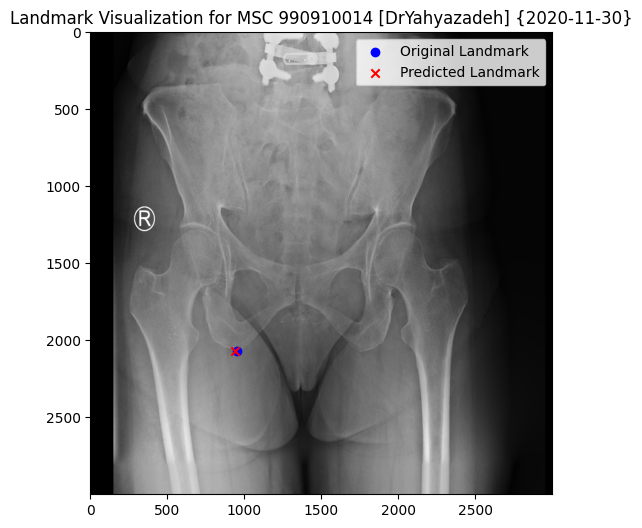

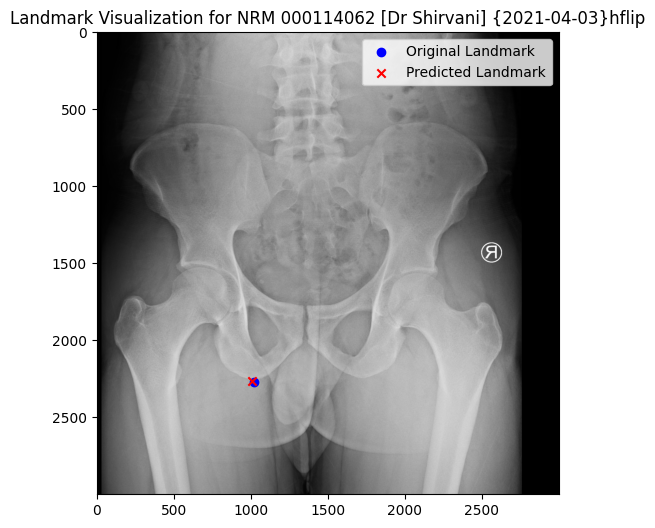

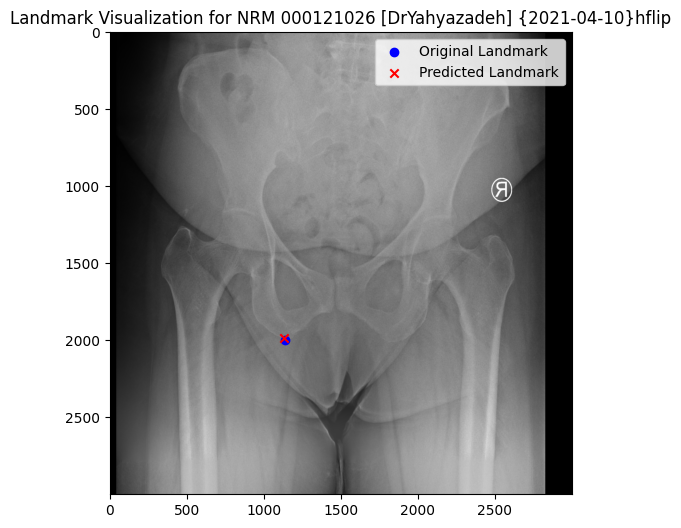

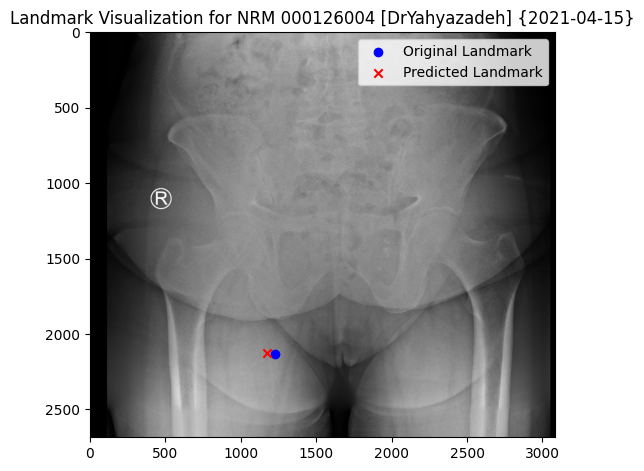

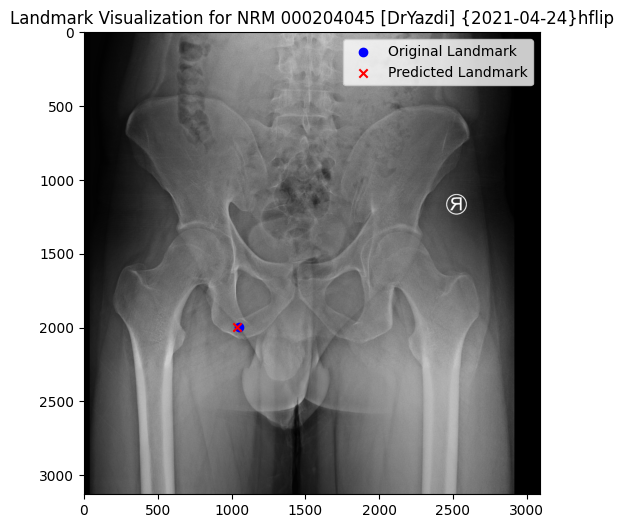

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

# Path to the CSV file and image directory
csv_path = '/content/drive/MyDrive/Hip2/Result/test_predictions_LIschium15.csv'
image_dir = '/content/drive/MyDrive/Hip2/original_test_images/'

# Load the CSV data into a pandas DataFrame
df = pd.read_csv(csv_path)

# Select the first 5 entries
df_selected = df.head(5)

# Loop through the selected entries
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the image
    img = Image.open(img_path)

    # Get the landmarks
    pred_x = row['Predicted_X_Original']
    pred_y = row['Predicted_Y_Original']
    orig_x = row['Original_X']
    orig_y = row['Original_Y']

    # Plot the image and the landmarks
    plt.figure(figsize=(6, 6))
    plt.imshow(img)
    plt.scatter([orig_x], [orig_y], c='blue', marker='o', label='Original Landmark')
    plt.scatter([pred_x], [pred_y], c='red', marker='x', label='Predicted Landmark')
    plt.legend()
    plt.title(f'Landmark Visualization for {img_name}')
    plt.show()

#Landmark16(RIschium)



In [ ]:
import numpy as np
# Load the datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images224.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks224.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images224.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks224.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images224.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks224.npy')


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
import numpy as np


In [ ]:
# Extract only the Second landmark coordinates
train_landmarks_first = train_landmarks[:, 30:32]
val_landmarks_first = val_landmarks[:, 30:32]
test_landmarks_first = test_landmarks[:, 30:32]

print("Datasets loaded successfully.")


Datasets loaded successfully.


In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224,224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 128 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 32 units and ReLU activation
x = Dense(64, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the first landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4), loss='mean_squared_error', metrics=['mae'])

# Print the model summary
model.summary()


Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_4 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 230, 230, 3)          0         ['input_4[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 112, 112, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 112, 112, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

In [ ]:
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the new destination path for the model checkpoint
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_16th700.h5'

# Define the ModelCheckpoint callback with the new path
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_loss', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_loss', patience=30, restore_best_weights=True)

# Train the model
history = model.fit(
    train_images, train_landmarks_first,
    validation_data=(val_images, val_landmarks_first),
    epochs=400,
    batch_size=32,
    callbacks=[checkpoint, early_stopping]
)


Epoch 1/400
19/19 [==============================] - ETA: 0s - loss: 19441.9082 - mae: 138.5156

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


19/19 [==============================] - 49s 929ms/step - loss: 19441.9082 - mae: 138.5156 - val_loss: 8230.2656 - val_mae: 88.4526
Epoch 2/400
19/19 [==============================] - 6s 322ms/step - loss: 9999.3828 - mae: 97.3290 - val_loss: 30912.1953 - val_mae: 152.4319
Epoch 3/400
19/19 [==============================] - 6s 328ms/step - loss: 1671.2626 - mae: 34.4075 - val_loss: 31226.3223 - val_mae: 158.8466
Epoch 4/400
19/19 [==============================] - 6s 313ms/step - loss: 650.0720 - mae: 20.4117 - val_loss: 19245.5996 - val_mae: 135.8880
Epoch 5/400
19/19 [==============================] - 12s 664ms/step - loss: 424.5047 - mae: 16.3277 - val_loss: 214.8152 - val_mae: 10.9773
Epoch 6/400
19/19 [==============================] - 6s 314ms/step - loss: 368.1703 - mae: 15.1949 - val_loss: 1434.1068 - val_mae: 35.0876
Epoch 7/400
19/19 [==============================] - 6s 315ms/step - loss: 377.7136 - mae: 15.0775 - val_loss: 817.9008 - val_mae: 25.6015
Epoch 8/400
19/19 [==

In [ ]:
# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)
print(f"Test Loss: {test_loss}")
print(f"Test MAE: {test_mae}")

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Visualize the results
import matplotlib.pyplot as plt

# Define a marker and color for the first landmark
marker_true = 'o'
marker_pred = 'x'
color_true = 'green'
color_pred = 'red'

# Number of test images to visualize
num_visualize = 5

# Plot the test images with true and predicted landmarks
for i in range(num_visualize):
    plt.figure(figsize=(6, 6))
    plt.imshow(test_images[i])

    # True landmark
    true_landmark = test_landmarks_first[i]
    plt.scatter(true_landmark[0], true_landmark[1], color=color_true, label='True', s=100, marker=marker_true)

    # Predicted landmark
    predicted_landmark = predictions[i]
    plt.scatter(predicted_landmark[0], predicted_landmark[1], color=color_pred, label='Predicted', s=100, marker=marker_pred)
    print(true_landmark[0]-predicted_landmark[0], true_landmark[1]-predicted_landmark[1])
    plt.title(f"Test Image {i+1}")
    plt.legend()
    plt.show()


In [ ]:
import tensorflow as tf
import numpy as np
import pandas as pd


# Evaluate the model on the test dataset
test_loss, test_mae = model.evaluate(test_images, test_landmarks_first)

# Make predictions on the test dataset
predictions = model.predict(test_images)

# Combine the data into a DataFrame
data = {
    'Name': [f'image_{i}' for i in range(len(test_images))],  # Replace this with the actual image names if available
    'Predicted_X': predictions[:, 0],
    'Predicted_Y': predictions[:, 1],
    'Original_X': test_landmarks_first[:, 0],
    'Original_Y': test_landmarks_first[:, 1],
    'Euclidean_Distance': np.sqrt((predictions[:, 0] - test_landmarks_first[:, 0])**2 + (predictions[:, 1] - test_landmarks_first[:, 1])**2)
}

df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
csv_path = '/content/drive/MyDrive/Hip2/csv/Part1_RIschium_16.csv'
df.to_csv(csv_path, index=False)

print(f"CSV file saved to {csv_path}")


In [ ]:
# Predict landmarks on the test dataset
predicted_landmarks_first = model.predict(test_images)

# Calculate the errors in each direction
errors = test_landmarks_first - predicted_landmarks_first
errors_x = errors[:, 0]
errors_y = errors[:, 1]

# Find the maximum errors in each direction
max_error_x = np.max(np.abs(errors_x))
max_error_y = np.max(np.abs(errors_y))

print(f"Maximum error in x direction: {max_error_x}")
print(f"Maximum error in y direction: {max_error_y}")


#Part 2_Landmark_16(RIschium)




##Save

In [ ]:
import os
from PIL import Image
import numpy as np
import pandas as pd
from tensorflow.keras.models import load_model

# Load the trained model
model_path = '/content/drive/MyDrive/Hip2/Models/resnet50_landmarks_16th700.h5'
model = load_model(model_path)

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'

# Read the Excel file into a DataFrame
df = pd.read_excel(file_path)

# Select specific columns
columns_of_interest = ["Height", "Width", "Name", "RIschium-x", "RIschium-y"]
df_selected = df[columns_of_interest]

# Initialize lists to hold processed images and landmarks
high_quality_images = []
predicted_landmarks = []
original_landmarks = []
transformation_details = []
crop_size=224*2
# Process each image
for index, row in df_selected.iterrows():
    img_name = row['Name']
    img_path = os.path.join(image_dir, f"{img_name}.png")

    # Load the high-quality image
    img = Image.open(img_path)
    img=img.resize((3000,3000))
    orig_width, orig_height = img.size

    # Resize the image to 224x224 for model prediction
    img_resized = img.resize((224, 224))
    img_array = np.array(img_resized)

    # Predict the landmark on the resized image
    pred_landmark = model.predict(np.expand_dims(img_array, axis=0))[0]

    # Transform the predicted landmark to the original image coordinates
    pred_landmark_orig_x = pred_landmark[0] * orig_width / 224
    pred_landmark_orig_y = pred_landmark[1] * orig_height / 224

    # Crop a 700x700 patch around the predicted landmark
    crop_x = int(pred_landmark_orig_x - crop_size/2)
    crop_y = int(pred_landmark_orig_y - crop_size/2)

    crop_x = max(0, min(crop_x, orig_width - crop_size))
    crop_y = max(0, min(crop_y, orig_height - crop_size))

    img_cropped = img.crop((crop_x, crop_y, crop_x + crop_size, crop_y + crop_size))

    # Resize the cropped image to 224x224
    img_cropped_resized = img_cropped.resize((224, 224))

    # Transform the original landmark to the new cropped and resized image coordinates
    real_landmark_x = (row['RIschium-x'] - crop_x) * 224 / crop_size
    real_landmark_y = (row['RIschium-y'] - crop_y) * 224 / crop_size

    # Convert the cropped and resized image to numpy array
    img_cropped_array = np.array(img_cropped_resized)

    # Append to lists
    high_quality_images.append(img_cropped_array)
    predicted_landmarks.append([pred_landmark_orig_x, pred_landmark_orig_y])
    original_landmarks.append([real_landmark_x, real_landmark_y])
    transformation_details.append([img_name, crop_x, crop_y, orig_width, orig_height])

# Convert lists to numpy arrays
high_quality_images = np.array(high_quality_images)
predicted_landmarks = np.array(predicted_landmarks)
original_landmarks = np.array(original_landmarks)
transformation_details = pd.DataFrame(transformation_details, columns=['Name', 'CropX', 'CropY', 'OrigWidth', 'OrigHeight'])

# Save the transformation details to a CSV file
transformation_details.to_csv('/content/drive/MyDrive/Hip2/transformation_details16.csv', index=False)

print(f"Processed {len(high_quality_images)} high-quality images.")


In [ ]:
import numpy as np
import pandas as pd

# Define paths
file_path = '/content/drive/MyDrive/HIP/data/HighQuality/NewFilePaths.xlsx'
image_dir = '/content/drive/MyDrive/HIP/data/HighQuality/'
test_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/test_index.npy'
train_val_index_path = '/content/drive/MyDrive/HIP/data/HighQuality/train_validation_index.npy'

# Read the indices
test_indices = np.load(test_index_path)
train_val_indices = np.load(train_val_index_path)

# Split the dataset using provided indices
train_val_images = high_quality_images[train_val_indices]
train_val_landmarks = original_landmarks[train_val_indices]
test_images = high_quality_images[test_indices]
test_landmarks = original_landmarks[test_indices]

# Further split the train_val set into training and validation sets
from sklearn.model_selection import train_test_split

train_images, val_images, train_landmarks, val_landmarks = train_test_split(
    train_val_images, train_val_landmarks, test_size=0.2, random_state=42
)

print(f"Training set: {len(train_images)} images")
print(f"Validation set: {len(val_images)} images")
print(f"Test set: {len(test_images)} images")

# Save the datasets
np.save('/content/drive/MyDrive/Hip2/Data/train_images_cropped16.npy', train_images)
np.save('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped16.npy', train_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/val_images_cropped16.npy', val_images)
np.save('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped16.npy', val_landmarks)
np.save('/content/drive/MyDrive/Hip2/Data/test_images_cropped16.npy', test_images)
np.save('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped16.npy', test_landmarks)


##Train

In [ ]:
import numpy as np
# Load the cropped datasets
train_images = np.load('/content/drive/MyDrive/Hip2/Data/train_images_cropped16.npy')
train_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/train_landmarks_cropped16.npy')
val_images = np.load('/content/drive/MyDrive/Hip2/Data/val_images_cropped16.npy')
val_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/val_landmarks_cropped16.npy')
test_images = np.load('/content/drive/MyDrive/Hip2/Data/test_images_cropped16.npy')
test_landmarks = np.load('/content/drive/MyDrive/Hip2/Data/test_landmarks_cropped16.npy')

print("Datasets loaded successfully.")

In [ ]:
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam

# Load the ResNet50 model with pretrained weights
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Add global average pooling layer
x = GlobalAveragePooling2D()(base_model.output)

# Add a fully connected layer with 256 units and ReLU activation
x = Dense(256, activation='relu')(x)
# Add a dropout layer
x = Dropout(0.2)(x)

# Add a fully connected layer with 64 units and ReLU activation
x = Dense(64, activation='relu')(x)

# Add another dropout layer
x = Dropout(0.1)(x)

# Add a fully connected layer with 8 units and ReLU activation
x = Dense(8, activation='relu')(x)

# Add the output layer with 2 units (for the landmark's x and y coordinates)
output = Dense(2, activation='linear')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=output)

# Function to freeze the first n layers
def freeze_layers(model, n):
    """Freeze the first n layers of the model."""
    for i, layer in enumerate(model.layers):
        layer.trainable = i >= n

# Specify how many layers you want to freeze
n_freeze =140
freeze_layers(base_model, n_freeze)

# Compile the model
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=[euclidean_distance])

# Print the model summary to check which layers are trainable
model.summary()

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))

# Define the checkpoint path
checkpoint_path = '/content/drive/MyDrive/Hip2/Models/resnet50_16th_landmark_Part2.h5'

# Define the ModelCheckpoint callback
checkpoint = ModelCheckpoint(checkpoint_path, monitor='val_euclidean_distance', save_best_only=True, mode='min')
early_stopping = EarlyStopping(monitor='val_euclidean_distance', patience=40, restore_best_weights=True)

# Compile the model with the custom metric
model.compile(optimizer=Adam(learning_rate=1e-4),
              loss=euclidean_distance,
              metrics=['mae', euclidean_distance])

# Train the model
history = model.fit(
    train_images, train_landmarks,
    validation_data=(val_images, val_landmarks),
    epochs=400,
    batch_size=16,
    callbacks=[checkpoint, early_stopping]
)

# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance}")


##result

In [ ]:
import tensorflow as tf
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping

# Define the custom Euclidean distance metric
def euclidean_distance(y_true, y_pred):
    return K.sqrt(K.sum(K.square(y_pred - y_true), axis=-1))
# Evaluate the model on the test dataset
test_loss, test_mae, test_euclidean_distance = model.evaluate(test_images, test_landmarks)
print(f"Test Loss: {test_loss}, Test MAE: {test_mae}, Test Euclidean Distance: {test_euclidean_distance/224*(crop_size/10)}",'mm')


In [ ]:
import matplotlib.pyplot as plt
import math as m

# Predict landmarks on the test dataset
predicted_landmarks = model.predict(test_images)

# Visualize the results on 5 test images
num_images_to_show = 10
for i in range(num_images_to_show):
    plt.figure(figsize=(6, 6))

    # Display the image
    plt.imshow(test_images[i].astype(np.uint8))

    # Plot the real landmark
    real_x, real_y = test_landmarks[i]
    plt.scatter(real_x, real_y, c='blue', marker='o', label='Real Landmark')

    # Plot the predicted landmark
    pred_x, pred_y = predicted_landmarks[i]
    plt.scatter(pred_x, pred_y, c='red', marker='x', label='Predicted Landmark')
    print(pred_x-real_x,pred_y-real_y)
    print(m.sqrt((pred_x-real_x)**2+(pred_y-real_y)**2)*70/224,"mm")

    # Show legend
    plt.legend()

    # Show the plot
    plt.show()
